# Imports and utils

In [1]:
import numpy as np
import pandas as pd
from astropy import units as u
import astropy.coordinates as coord
coord.galactocentric_frame_defaults.set ('latest')
import numpy as np
import gala.potential as gp
import gala.dynamics as gd
import gala.integrate as gi
from gala.units import galactic
import glob
from astropy.table import Table, vstack, hstack, join
from astropy.io import fits
from astropy import constants
import sys
import functools
import multiprocessing
import warnings
from astropy.cosmology import Planck18_arXiv_v2 as cosmo
import os

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import matplotlib.pyplot as plt
import matplotlib
from matplotlib import rc
rc('text', usetex=False)
import seaborn as sns
import cmasher as cmr
matplotlib.rcParams['font.family'] = 'sans-serif'
matplotlib.rcParams['font.sans-serif'] = ['Bitstream Vera Sans']
sns.set_style("ticks",  rc={"axes.grid":False})
sns.set_palette("deep")
sns.set_style( {"axes.edgecolor": "black"}, {'axes.linewidth': 1})
from astropy.cosmology import Planck18_arXiv_v2 as cosmo
import pickle
import yt
from matplotlib.colors import LogNorm
import yt
from yt.units import kiloparsec, Msun

solar_pos = np.array([-coord.Galactocentric().galcen_distance.value, 0, coord.Galactocentric().z_sun.value/1e+3])

rcat = Table(fits.open("/Users/rohannaidu/Dropbox/Substructure_rcat/Substructure_rcat_full.fits")[1].data)

def medianize_w(arr, weights):
    rep_arr = np.repeat(arr, (weights/1e+1).astype(int))
    return medianize(rep_arr)

def weighted_count(arr, weights):
    return len(np.repeat(arr, (weights/1e+1).astype(int)))

def weighted_arr(arr, weights):
    return np.repeat(arr, (weights/1e+1).astype(int))

from astropy.stats import biweight_location

def weighted_bootstrap(arr, weights, func, samples=1000):
    stat = []
    for i in range(samples):
        indices = np.random.choice(np.arange(len(arr)), len(arr))
        resampled_arr = weighted_arr(arr[indices], weights[indices])
        stat.append(func(resampled_arr))
    return stat

def weighted_bootstrap_err(arr, arr_err, weights, func, samples=1000):
    stat = []
    for i in range(samples):
        indices = np.random.choice(np.arange(len(arr)), len(arr))
        resampled_arr = weighted_arr(arr[indices], weights[indices])
        resampled_err_arr = weighted_arr(arr_err[indices], weights[indices])
        resampled_arr = np.random.normal(resampled_arr, resampled_err_arr)
        stat.append(func(resampled_arr))
    return stat

def medianize(arr):
    med = np.round(np.nanmedian(arr), 2)
    eightyfourth = np.round(np.nanpercentile(arr, 84), 2)
    sixteenth = np.round(np.nanpercentile(arr, 16), 2)
    return med, eightyfourth-med, sixteenth-med

ImportError: cannot import name 'Planck18_arXiv_v2' from 'astropy.cosmology' (/n/home01/abeane/.local/lib/python3.10/site-packages/astropy/cosmology/__init__.py)

In [ ]:
def pos_cartesian_to_galactic(pos):
    """
    Transforms carteisian coordinates to galactic.

    Parameters:
    -----------
    pos : 3d-numpy array.

    returns:
    --------
    l :
    numpy.array([]) in radians

    b : numpy.array([])
    in radians

    """
    ## transforming to galactic coordinates.

    c_gal = coord.SkyCoord(pos, representation='cartesian', frame='galactic')
    c_gal.representation = 'spherical'

    ## to degrees and wrapping l
    l_degrees = c_gal.l.wrap_at(180 * u.deg)#.radian
    b_degrees = c_gal.b#.radian
    
    l_rad = c_gal.l.wrap_at(180 * u.deg).radian
    b_rad = c_gal.b.radian

    return l_degrees, b_degrees, l_rad, b_rad


def get_elz_err(df, idx):
    
    
    gal = coord.Galactocentric(x=df['X_gal_%s'%idx]*u.kpc, y=df['Y_gal_%s'%idx]*u.kpc, z=df['Z_gal_%s'%idx]*u.kpc,
                        v_x=df['Vx_gal_%s'%idx]*u.km/u.s, v_y=df['Vy_gal_%s'%idx]*u.km/u.s, v_z=df['Vz_gal_%s'%idx]*u.km/u.s)
    icrs = gal.transform_to(coord.ICRS)

    noisy_dist = np.random.normal(icrs.distance.kpc, 0.1*icrs.distance.kpc)

    noisy_icrs = coord.ICRS(ra=icrs.ra, dec=icrs.dec, distance=noisy_dist*u.kpc,
                pm_ra_cosdec=np.random.normal(icrs.pm_ra_cosdec.value, 0.1*np.abs(icrs.pm_ra_cosdec.value))*u.mas/u.yr, 
                pm_dec=np.random.normal(icrs.pm_dec.value, 0.1*np.abs(icrs.pm_dec.value))*u.mas/u.yr, 
                radial_velocity=icrs.radial_velocity)

    noisy_gal = noisy_icrs.transform_to(coord.Galactocentric)

    w = gd.PhaseSpacePosition(pos=[noisy_gal.x.value, noisy_gal.y.value, noisy_gal.z.value]*u.kpc, 
                              vel=[noisy_gal.v_x.value, noisy_gal.v_y.value, 
                                   noisy_gal.v_z.value]*u.km/u.s )

    noisy_lz = w.angular_momentum()[2].value/1e+3
    noisy_e = (w.energy(gp.MilkyWayPotential()).to(u.km**2/u.s**2)/1e+5).value
    
    return noisy_lz, noisy_e


def get_lxly_err(df, idx):
    
    
    gal = coord.Galactocentric(x=df['X_gal_%s'%idx]*u.kpc, y=df['Y_gal_%s'%idx]*u.kpc, z=df['Z_gal_%s'%idx]*u.kpc,
                        v_x=df['Vx_gal_%s'%idx]*u.km/u.s, v_y=df['Vy_gal_%s'%idx]*u.km/u.s, v_z=df['Vz_gal_%s'%idx]*u.km/u.s)
    icrs = gal.transform_to(coord.ICRS)

    noisy_dist = np.random.normal(icrs.distance.kpc, 0.1*icrs.distance.kpc)

    noisy_icrs = coord.ICRS(ra=icrs.ra, dec=icrs.dec, distance=noisy_dist*u.kpc,
                pm_ra_cosdec=np.random.normal(icrs.pm_ra_cosdec.value, 0.1*np.abs(icrs.pm_ra_cosdec.value))*u.mas/u.yr, 
                pm_dec=np.random.normal(icrs.pm_dec.value, 0.1*np.abs(icrs.pm_dec.value))*u.mas/u.yr, 
                radial_velocity=icrs.radial_velocity)

    noisy_gal = noisy_icrs.transform_to(coord.Galactocentric)

    w = gd.PhaseSpacePosition(pos=[noisy_gal.x.value, noisy_gal.y.value, noisy_gal.z.value]*u.kpc, 
                              vel=[noisy_gal.v_x.value, noisy_gal.v_y.value, 
                                   noisy_gal.v_z.value]*u.km/u.s )

    noisy_lx = w.angular_momentum()[0].value/1e+3
    noisy_ly = w.angular_momentum()[1].value/1e+3
    
    return noisy_lx, noisy_ly


def get_vrvthetavphi_err(df, idx):
    
    gal = coord.Galactocentric(x=df['X_gal_%s'%idx]*u.kpc, y=df['Y_gal_%s'%idx]*u.kpc, z=df['Z_gal_%s'%idx]*u.kpc,
                        v_x=df['Vx_gal_%s'%idx]*u.km/u.s, v_y=df['Vy_gal_%s'%idx]*u.km/u.s, v_z=df['Vz_gal_%s'%idx]*u.km/u.s)
    icrs = gal.transform_to(coord.ICRS)

    noisy_dist = np.random.normal(icrs.distance.kpc, 0.1*icrs.distance.kpc)

    noisy_icrs = coord.ICRS(ra=icrs.ra, dec=icrs.dec, distance=noisy_dist*u.kpc,
                pm_ra_cosdec=np.random.normal(icrs.pm_ra_cosdec.value, 0.1*np.abs(icrs.pm_ra_cosdec.value))*u.mas/u.yr, 
                pm_dec=np.random.normal(icrs.pm_dec.value, 0.1*np.abs(icrs.pm_dec.value))*u.mas/u.yr, 
                radial_velocity=icrs.radial_velocity)

    noisy_gal = noisy_icrs.transform_to(coord.Galactocentric)

    w0 = gd.PhaseSpacePosition(noisy_gal.sphericalcoslat)
    noisy_vr     = w0.radial_velocity.value
    noisy_vtheta = (w0.distance * w0.pm_lat).to(u.km/u.s, u.dimensionless_angles()).value
    noisy_vphi   = (w0.distance * w0.pm_lon_coslat).to(u.km/u.s, u.dimensionless_angles()).value
    
    return noisy_vr, noisy_vtheta, noisy_vphi


def get_rgal_err(df, idx):
    
    gal = coord.Galactocentric(x=df['X_gal_%s'%idx]*u.kpc, y=df['Y_gal_%s'%idx]*u.kpc, z=df['Z_gal_%s'%idx]*u.kpc,
                        v_x=df['Vx_gal_%s'%idx]*u.km/u.s, v_y=df['Vy_gal_%s'%idx]*u.km/u.s, v_z=df['Vz_gal_%s'%idx]*u.km/u.s)
    icrs = gal.transform_to(coord.ICRS)

    noisy_dist = np.random.normal(icrs.distance.kpc, 0.1*icrs.distance.kpc)

    noisy_icrs = coord.ICRS(ra=icrs.ra, dec=icrs.dec, distance=noisy_dist*u.kpc,
                pm_ra_cosdec=np.random.normal(icrs.pm_ra_cosdec.value, 0.1*np.abs(icrs.pm_ra_cosdec.value))*u.mas/u.yr, 
                pm_dec=np.random.normal(icrs.pm_dec.value, 0.1*np.abs(icrs.pm_dec.value))*u.mas/u.yr, 
                radial_velocity=icrs.radial_velocity)

    noisy_gal = noisy_icrs.transform_to(coord.Galactocentric)
    
    return (noisy_gal.x.value**2 + noisy_gal.y.value**2 + noisy_gal.z.value**2)**0.5


def track_com(ge):
    
    com_init = np.array([np.mean(ge['X_gal_1']), np.mean(ge['Y_gal_1']), np.mean(ge['Z_gal_1'])])
    com_dist = np.linalg.norm(np.array([ge['X_gal_1'], ge['Y_gal_1'], ge['Z_gal_1']]).T - com_init,
                      axis=1)
    bound_stars = (com_dist < np.percentile(com_dist, 5))
    
    com = []

    for indx in range(500):
        try:
            com.append(np.mean(np.linalg.norm(np.array([ge['X_gal_%s'%(indx+1)], ge['Y_gal_%s'%(indx+1)], ge['Z_gal_%s'%(indx+1)]]),
                          axis=0)[bound_stars]))
        except:
            break
        
    com = np.array(com)
    
    return com



def track_lz(ge):

    lz =[]
    for indx in range(500):
        try:
            idx = indx+1
            w = gd.PhaseSpacePosition(pos=[ge['X_gal_%s'%idx], ge['Y_gal_%s'%idx], ge['Z_gal_%s'%idx]]*u.kpc, 
                          vel=[ge['Vx_gal_%s'%idx], ge['Vy_gal_%s'%idx], ge['Z_gal_%s'%idx]]*u.km/u.s )
            Lz.append(w.angular_momentum()[2]/1e+3)
    
        except:
            break
        
    lz = np.array(lz)
    
    return lz



def track_com_3d(ge):
    
    com_init = np.array([np.mean(ge['X_gal_1']), np.mean(ge['Y_gal_1']), np.mean(ge['Z_gal_1'])])
    com_dist = np.linalg.norm(np.array([ge['X_gal_1'], ge['Y_gal_1'], ge['Z_gal_1']]).T - com_init, axis=1)
    bound_stars = (com_dist < np.percentile(com_dist, 5))
    
    com_x = []
    com_y = []
    com_z = []

    for indx in range(501):
        try:
            com_x.append(np.mean(ge['X_gal_%s'%(indx+1)][bound_stars]))
            com_y.append(np.mean(ge['Y_gal_%s'%(indx+1)][bound_stars]))
            com_z.append(np.mean(ge['Z_gal_%s'%(indx+1)][bound_stars]))
        except:
            break
    
    return np.array(com_x), np.array(com_y), np.array(com_z)

def bound_frac(ge):
    com_x, com_y, com_z = track_com_3d(ge)
    
    com_dists = []
    
    for indx in range(500):
        try:
            com_dist = ((ge['X_gal_%s'%(indx+1)]-com_x[indx])**2 + (ge['Y_gal_%s'%(indx+1)]-com_y[indx])**2 + (ge['Z_gal_%s'%(indx+1)]-com_z[indx])**2)**0.5
            com_dists.append(com_dist)
        except:
            break
        
    return np.array(com_dists)


def read_file(ge, idx):
    
    ge['Vx_gal_%s'%idx] = -ge['Vx_gal_%s'%idx]
    ge['X_gal_%s'%idx] = -ge['X_gal_%s'%idx]
    
    ge['Vx_gal_%s'%idx] = 1.4*ge['Vx_gal_%s'%idx]
    ge['Vy_gal_%s'%idx] = 1.4*ge['Vy_gal_%s'%idx]
    ge['Vz_gal_%s'%idx] = 1.4*ge['Vz_gal_%s'%idx]
    
    ge['R_gal'] = (ge['X_gal_%s'%idx]**2 + ge['Y_gal_%s'%idx]**2 + ge['Z_gal_%s'%idx]**2)**0.5
    ge['dist_adpt'] = np.linalg.norm(np.array([ge['X_gal_%s'%idx], ge['Y_gal_%s'%idx], ge['Z_gal_%s'%idx]]).T - solar_pos,
                  axis=1)
    ge['dist_adpt_noisy'] = np.abs(np.random.normal(ge['dist_adpt'], 0.1*ge['dist_adpt']))
    
    w = gd.PhaseSpacePosition(pos=[ge['X_gal_%s'%idx], ge['Y_gal_%s'%idx], ge['Z_gal_%s'%idx]]*u.kpc, 
                          vel=[ge['Vx_gal_%s'%idx], ge['Vy_gal_%s'%idx], ge['Z_gal_%s'%idx]]*u.km/u.s )
    ge['Lz'] = w.angular_momentum()[2]/1e+3
    ge['Lx'] = w.angular_momentum()[0]/1e+3
    ge['Ly'] = w.angular_momentum()[1]/1e+3
    ge['E_tot_pot1'] = (w.energy(gp.MilkyWayPotential()).to(u.km**2/u.s**2)/1e+5).value
    
    lz_err, e_err = get_elz_err(ge, idx)
    ge['Lz_noisy'] = lz_err
    ge['E_noisy'] = e_err
    
    lx_err, ly_err = get_lxly_err(ge, idx)
    ge['Lx_noisy'] = lx_err
    ge['Ly_noisy'] = ly_err
    
    
    vr_err, vtheta_err, vphi_err = get_vrvthetavphi_err(ge, idx)
    ge['Vr_noisy'] = vr_err
    ge['Vtheta_noisy'] = vtheta_err
    ge['Vphi_noisy'] = vphi_err
    
    Gal = coord.Galactocentric(x=ge['X_gal_%s'%idx]*u.kpc, y=ge['Y_gal_%s'%idx]*u.kpc, z=ge['Z_gal_%s'%idx]*u.kpc,
                        v_x=ge['Vx_gal_%s'%idx]*u.km/u.s, v_y=ge['Vy_gal_%s'%idx]*u.km/u.s, v_z=ge['Z_gal_%s'%idx]*u.km/u.s)
    ic = Gal.transform_to(coord.ICRS)
    galac = Gal.transform_to(coord.Galactic)
    
    ge['ra'] = ic.ra.degree
    ge['dec'] = ic.dec.degree
    ge['L'] = galac.l.degree
    ge['B'] = galac.b.degree
    
    Gal_noisy = coord.ICRS(ra=Gal.transform_to(coord.ICRS).ra,
                                  dec=Gal.transform_to(coord.ICRS).dec,
                                  distance=ge['dist_adpt_noisy']*u.kpc).transform_to(coord.Galactocentric)
    
    ge['R_gal_noisy'] = (Gal_noisy.x.value**2 + Gal_noisy.y.value**2 + Gal_noisy.z.value**2)**0.5
    ge['h3_mask'] = (np.abs(ge['B'])>40) & (ge['dec']>-20) & (ge['dist_adpt']>2) & (ge['R_gal']<50)
    ge['h3_mask_all'] = (np.abs(ge['B'])>40) & (ge['dec']>-20) & (ge['dist_adpt']>2) #& (ge['R_gal']<50)
    
    lz_arr = []
    for trials in range(20):
        lz_err, _ = get_elz_err(ge, idx)
        lz_arr.append(lz_err[ge['h3_mask']])
        
    lz_arr = np.array(lz_arr)
    
    ge['arjuna2'] = np.mean(lz_arr>2)
    ge['arjuna15'] = np.mean(lz_arr>1.5)
    
    ge['radial'] = np.mean(np.abs(lz_arr)<0.5)
    
    #ge['com_30'] = np.max(track_com(ge)[150::])
    #ge['com_50'] = np.max(track_com(ge)[250::])
    ge['com_min'] = np.min(track_com(ge))
    
    ge['com'] = np.concatenate((track_com(ge), np.ones(len(ge)-len(track_com(ge)))*-99))
    
    w0 = gd.PhaseSpacePosition(Gal.sphericalcoslat)
    ge['Vr_gal']     = w0.radial_velocity.value
    ge['Vtheta_gal'] = (w0.distance * w0.pm_lat).to(u.km/u.s, u.dimensionless_angles()).value
    ge['Vphi_gal']   = (w0.distance * w0.pm_lon_coslat).to(u.km/u.s, u.dimensionless_angles()).value
    
    
    w0 = gd.PhaseSpacePosition(pos=[-ge['X_gal_1'], ge['Y_gal_1'], ge['Z_gal_1']]*u.kpc, 
                          vel=[-ge['Vx_gal_1'], ge['Vy_gal_1'], ge['Z_gal_1']]*u.km/u.s )
    ge['Lz_0'] = w0.angular_momentum()[2]/1e+3
    ge['E_tot_pot1_0'] = (w0.energy(gp.MilkyWayPotential()).to(u.km**2/u.s**2)/1e+5).value
    com_init = np.array([np.mean(ge['X_gal_1']), np.mean(ge['Y_gal_1']), np.mean(ge['Z_gal_1'])])
    ge['R_com_0'] = np.linalg.norm(np.array([ge['X_gal_1'], ge['Y_gal_1'], ge['Z_gal_1']]).T - 
                                   com_init, axis=1)
    
    
    pos_galactic = np.array([ge['X_gal_%s'%idx]+8.3, ge['Y_gal_%s'%idx], ge['Z_gal_%s'%idx]]).T
    ge['l_deg'], ge['b_deg'], ge['l_rad'], ge['b_rad'] = pos_cartesian_to_galactic(pos_galactic)

    pos_galactocentric = np.array([ge['X_gal_%s'%idx], ge['Y_gal_%s'%idx], ge['Z_gal_%s'%idx]]).T
    ge['l_gal_deg'], ge['b_gal_deg'], ge['l_gal_rad'], ge['b_gal_rad'] = pos_cartesian_to_galactic(pos_galactocentric)
    
    #Sgr l and b
    
#    ge['Sgr_L'] = 
#    ge['Sgr_B'] = 
    
    return ge

In [ ]:
# inp = pickle.load(open("./snaps/GEM1UMresize_disk_129_129_50_pro_150.pickle", "rb"))
# ge = hstack(inp)

# ge_500 = read_file(ge, 500)
# ge_444 = read_file(ge, 444)
# ge_400 = read_file(ge, 400)

In [ ]:
def track_com_3d(ge):
    
    com_init = np.array([np.mean(ge['X_gal_1']), np.mean(ge['Y_gal_1']), np.mean(ge['Z_gal_1'])])
    com_dist = np.linalg.norm(np.array([ge['X_gal_1'], ge['Y_gal_1'], ge['Z_gal_1']]).T - com_init, axis=1)
    bound_stars = (com_dist < np.percentile(com_dist, 5))
    
    com_x = []
    com_y = []
    com_z = []

    for indx in range(500):
        try:
            com_x.append(np.mean(ge['X_gal_%s'%(indx+1)][bound_stars]))
            com_y.append(np.mean(ge['Y_gal_%s'%(indx+1)][bound_stars]))
            com_z.append(np.mean(ge['Z_gal_%s'%(indx+1)][bound_stars]))
        except:
            break
    
    return np.array(com_x), np.array(com_y), np.array(com_z)

def bound_frac(ge):
    com_x, com_y, com_z = track_com_3d(ge)
    
    com_dists = []
    
    for indx in range(500):
        try:
            com_dist = ((ge['X_gal_%s'%(indx+1)]-com_x[indx])**2 + (ge['Y_gal_%s'%(indx+1)]-com_y[indx])**2 + (ge['Z_gal_%s'%(indx+1)]-com_z[indx])**2)**0.5
            com_dists.append(com_dist)
        except:
            break
        
    return np.array(com_dists)

# Fiducial model is an excellent fit to everything

In [5]:
rcat = Table(fits.open("/Users/rohannaidu/Desktop/z2merger/rcatN20.fits")[1].data)
rc_mask = ((rcat['ge_flag']) | (rcat['arjuna_flag'])) & (rcat['chem_qflag1']) #& (rcat['FeH']>-1.3) & (rcat['FeH']<-1.1)

FileNotFoundError: [Errno 2] No such file or directory: '/Users/rohannaidu/Desktop/z2merger/rcatN20.fits'

In [7]:
import pickle
# inp = pickle.load(open("./snaps/GEM1UMresize_disk_129_129_50_pro_165.pickle", "rb"))
# ge_inp = hstack(inp)
# ge_165 = read_file(ge_inp, 444)


inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_165.pickle", "rb"))
ge_inp = hstack(inp)
#ge_165_new = read_file(ge_inp, 501)
ge_165_new = read_file(ge_inp, 501)

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.4497192325385915


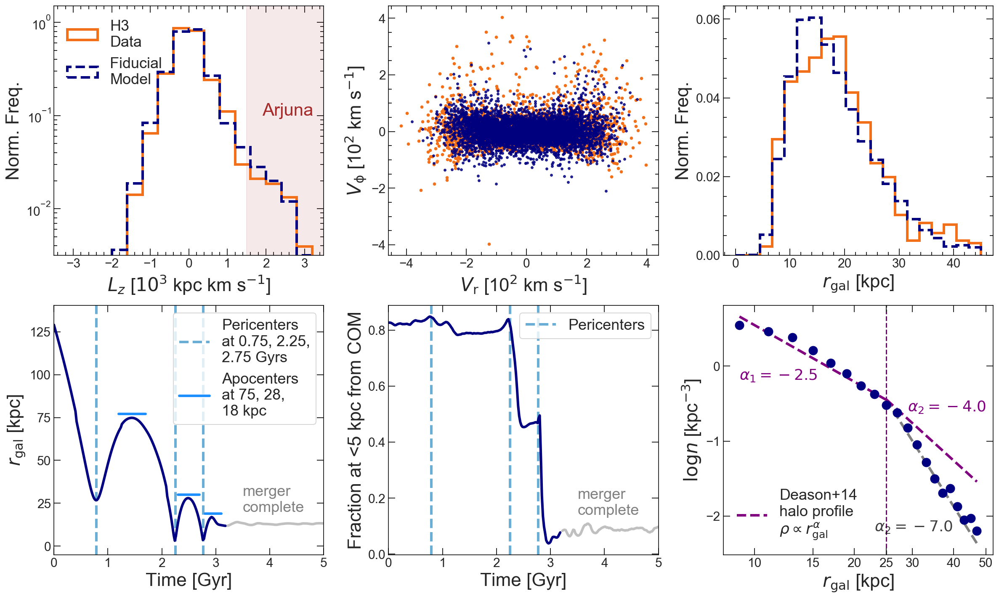

In [349]:
cmap = plt.get_cmap('Oranges')
cmap(0.6)
plt.subplots(2,3,figsize=(20, 12))
plt.subplot(2, 3,1)

plt.hist(rcat['Lz'][rc_mask], histtype="step", lw=3, range=(-4,4), bins=20,
         density=True, weights=rcat['mag_weights'][rc_mask], label="H3\nData", 
         color=cmap(0.6))

plt.hist(ge_165['Lz_noisy'][ge_165['h3_mask'] & (ge_165['dist_adpt']>3)], 
         histtype="step", lw=3, range=(-4,4), bins=20,
                density=True, ls="--", label="Fiducial\nModel", color="navy")

plt.fill_betweenx(y=[0.0001,2], x1=1.5, x2=3.5, color="brown", alpha=0.1)
plt.text(1.9, 10**-1, "Arjuna", fontsize=21, c="brown")

plt.yscale("log")
plt.ylim(10**-2.5,1.5)
plt.xlim(-3.5, 3.5)
plt.xlabel(r"$L_{z}$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=22)
plt.ylabel(r"Norm. Freq.", fontsize=22)
plt.legend(fontsize=18,frameon=False, loc=2)
#plt.locator_params(axis='y',nbins=6)
plt.minorticks_on()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(2,3,3)
plt.hist(rcat['R_gal'][rc_mask], histtype="step", lw=3, range=(0,45), bins=20,
                density=True, weights=rcat['mag_weights'][rc_mask], label="Data", color=cmap(0.6))
dist_arr = ge_165_new['R_gal_noisy'][ge_165_new['h3_mask'] & (ge_165_new['dist_adpt']>3)]
plt.hist(np.random.normal(dist_arr, 0.1*dist_arr), 
         histtype="step", lw=3, range=(0,45), bins=20,
                density=True, ls="--", label="Fiducial\nModel", color="navy")


plt.ylabel(r"Norm. Freq.", fontsize=22)
plt.xlabel(r"$r_{\rm{gal}}$ [kpc]", fontsize=22)
plt.minorticks_on()
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(2,3,2)
plt.scatter(rcat['Vr_gal'][rc_mask]/100, 
                rcat['Vphi_gal'][rc_mask]/100, s=8, c=cmap(0.6),
           rasterized=True)
plt.scatter(ge_165_new['Vr_noisy'][ge_165_new['h3_mask']][0:-1:2]/100, 
            ge_165_new['Vphi_noisy'][ge_165_new['h3_mask']][0:-1:2]/100, s=6,
           alpha=0.8, c="navy", rasterized=True)
plt.minorticks_on()
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
plt.ylabel(r"$V_{\rm{\phi}}$ [10$^{2}$ km s$^{-1}$]", fontsize=22)
plt.xlabel(r"$V_{\rm{r}}$ [10$^{2}$ km s$^{-1}$]", fontsize=22)

cmap = plt.get_cmap('Blues')

plt.subplot(2,3,4)
plt.axvline(0.79, ls="--", c=cmap(0.5), lw=3,alpha=1,label="Pericenters\nat 0.75, 2.25,\n2.75 Gyrs")
plt.axvline(2.25, ls="--", c=cmap(0.5), lw=3,alpha=1)
plt.axvline(2.77, ls="--", c=cmap(0.5), lw=3,alpha=1)

plt.plot([1.2, 1.7], [77, 77], ls="-", lw=3, color="dodgerblue",
        label="Apocenters\nat 75, 28,\n18 kpc")
plt.plot([2.3, 2.7], [30, 30], ls="-", lw=3, color="dodgerblue")
plt.plot([2.8, 3.1], [19, 19], ls="-", lw=3, color="dodgerblue")


plt.plot( (np.arange(500)/50)[(np.arange(500)/50)<3.2], 
         ge_165['com'][0:500][(np.arange(500)/50)<3.2], lw=3, c="navy")

plt.plot( (np.arange(500)/50)[(np.arange(500)/50)>3.2], 
         ge_165['com'][0:500][(np.arange(500)/50)>3.2], lw=3, c="silver")

#plt.plot(np.arange(500)/50, ge_165['com'][0:500], lw=3, c="navy")
#plt.axhline(27, ls="--", c=cmap(0.6), zorder=0, lw=2)
plt.xlabel(r"Time [Gyr]", fontsize=22)
plt.ylabel(r"$r_{\rm{gal}}$ [kpc]", fontsize=22)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
plt.xlim(0, 5)
plt.ylim(-5,)
plt.legend(fontsize=18,frameon=True)


plt.text(3.5, 20, "merger\ncomplete", color="gray", fontsize=18)
#

plt.subplot(2,3,5)
com_dists = bound_frac(ge_165_new)

plt.axvline(0.79, ls="--", c=cmap(0.5), lw=3,label="Pericenters", zorder=0)
plt.axvline(2.25, ls="--", c=cmap(0.5), lw=3,zorder=0)
plt.axvline(2.77, ls="--", c=cmap(0.5), lw=3,zorder=0)
plt.plot( (np.arange(500)/50)[(np.arange(500)/50)<3.2], 
         (np.mean(com_dists<5, axis=1))[(np.arange(500)/50)<3.2], 
         lw=3, c="navy")

plt.plot( (np.arange(500)/50)[(np.arange(500)/50)>3.2], 
         (np.mean(com_dists<5, axis=1))[(np.arange(500)/50)>3.2],
         lw=3, c="silver")

plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
plt.xlim(0, 5)
plt.xlabel("Time [Gyr]", fontsize=22)
plt.ylabel("Fraction at <5 kpc from COM", fontsize=22)
plt.text(3.5, 0.14, "merger\ncomplete", color="gray", fontsize=18)

plt.legend(fontsize=18, loc="upper right")

plt.subplot(2,3,6)

counts, edges = np.histogram(ge_165_new['R_gal'],
                             np.arange(50)[0:-1:2])
edges = (edges[0:-1] + edges[1::])/2


#plt.figure(figsize=(7,6))
expo = 2.5
init = np.log10((counts/(4*np.pi*edges**2)))[edges>7][0]
plt.plot( np.log10(edges[edges>7][0:9]), 
         np.log10((edges[edges>7][0:9]**-expo)*(10**init/(edges[edges>7][0:9]**-expo)[0])*1.3),
        c="purple", ls="--", lw=3, zorder=0, label="Deason+14\nhalo profile\n"r"$\rho \propto r_{\rm{gal}}^{\alpha}$")

print(np.log10((edges[edges>7][0:9]**-expo)*(10**init/(edges[edges>7][0:9]**-expo)[0])*1.3)[-1])


expo = 7
plt.plot( np.log10(edges[edges>7][8::]), 
         np.log10((edges[edges>7][8::]**-expo)) + (-0.444 - np.log10((edges[edges>7][8::]**-expo))[0]) ,
        c="gray", lw=3, zorder=0, ls="--")


expo = 4
plt.plot( np.log10(edges[edges>7][8::]), 
         np.log10((edges[edges>7][8::]**-expo)) + (-0.444 - np.log10((edges[edges>7][8::]**-expo))[0]) ,
         c="purple",  lw=3, zorder=0, ls="--")


plt.scatter( np.log10(edges[edges>7]), np.log10((counts/(4*np.pi*edges**2))[edges>7]),
           c="navy", s=100)


plt.gca().set_xticks(np.log10([10, 15, 20, 25, 30, 40, 50]))
plt.gca().set_xticklabels([10, 15, 20, 25, 30, 40, 50])
plt.legend(fontsize=18, frameon=False, loc=3)
plt.xlabel(r"$r_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$\log{n}$ [kpc$^{-3}$]", fontsize=22)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

plt.axvline(np.log10(25), ls="--", zorder=0, c="purple")

plt.text(np.log10(9), -0.18, r"$\alpha_{1} = -2.5$", fontsize=18, c="purple")
plt.text(np.log10(29), -0.6,r"$\alpha_{2} = -4.0$", fontsize=18, c="purple")
plt.text(np.log10(23), -2.2,r"$\alpha_{2} = -7.0$", fontsize=18, c="k", alpha=0.75)

plt.subplots_adjust(wspace=0.24)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Fiducial_Modelv4.pdf", bbox_inches='tight', dpi=300)

# Bulge variations

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


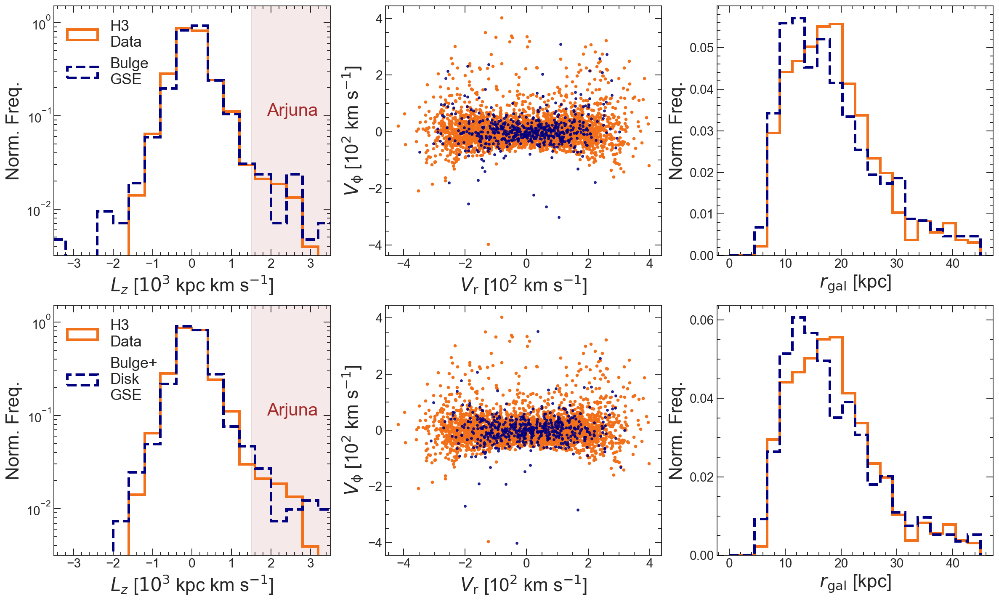

In [51]:
inp = Table(fits.open("./snaps/bulge.fits")[1].data)
ge_165_new = read_file(inp, 100)


cmap = plt.get_cmap('Oranges')
cmap(0.6)
plt.subplots(2,3,figsize=(20, 12))
plt.subplot(2, 3,1)

plt.hist(rcat['Lz'][rc_mask], histtype="step", lw=3, range=(-4,4), bins=20,
         density=True, weights=rcat['mag_weights'][rc_mask], label="H3\nData", 
         color=cmap(0.6))

plt.hist(ge_165_new['Lz_noisy'][ge_165_new['h3_mask'] & (ge_165_new['dist_adpt']>3)], 
         histtype="step", lw=3, range=(-4,4), bins=20,
                density=True, ls="--", label="Bulge\nGSE", color="navy")

plt.fill_betweenx(y=[0.0001,2], x1=1.5, x2=3.5, color="brown", alpha=0.1)
plt.text(1.9, 10**-1, "Arjuna", fontsize=21, c="brown")

plt.yscale("log")
plt.ylim(10**-2.5,1.5)
plt.xlim(-3.5, 3.5)
plt.xlabel(r"$L_{z}$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=22)
plt.ylabel(r"Norm. Freq.", fontsize=22)
plt.legend(fontsize=18,frameon=False, loc=2)
#plt.locator_params(axis='y',nbins=6)
plt.minorticks_on()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(2,3,3)
plt.hist(rcat['R_gal'][rc_mask], histtype="step", lw=3, range=(0,45), bins=20,
                density=True, weights=rcat['mag_weights'][rc_mask], label="Data", color=cmap(0.6))
dist_arr = ge_165_new['R_gal_noisy'][ge_165_new['h3_mask'] & (ge_165_new['dist_adpt']>3)]
plt.hist(np.random.normal(dist_arr, 0.1*dist_arr), 
         histtype="step", lw=3, range=(0,45), bins=20,
                density=True, ls="--", label="Fiducial\nModel", color="navy")


plt.ylabel(r"Norm. Freq.", fontsize=22)
plt.xlabel(r"$r_{\rm{gal}}$ [kpc]", fontsize=22)
plt.minorticks_on()
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(2,3,2)
plt.scatter(rcat['Vr_gal'][rc_mask]/100, 
                rcat['Vphi_gal'][rc_mask]/100, s=8, c=cmap(0.6),
           rasterized=True)
plt.scatter(ge_165_new['Vr_noisy'][ge_165_new['h3_mask']][0:-1:2]/100, 
            ge_165_new['Vphi_noisy'][ge_165_new['h3_mask']][0:-1:2]/100, s=6,
           alpha=0.8, c="navy", rasterized=True)
plt.minorticks_on()
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
plt.ylabel(r"$V_{\rm{\phi}}$ [10$^{2}$ km s$^{-1}$]", fontsize=22)
plt.xlabel(r"$V_{\rm{r}}$ [10$^{2}$ km s$^{-1}$]", fontsize=22)



inp = Table(fits.open("./snaps/bulgedisk.fits")[1].data)
ge_165_new = read_file(inp, 100)

plt.subplot(2, 3,4)

plt.hist(rcat['Lz'][rc_mask], histtype="step", lw=3, range=(-4,4), bins=20,
         density=True, weights=rcat['mag_weights'][rc_mask], label="H3\nData", 
         color=cmap(0.6))

plt.hist(ge_165_new['Lz_noisy'][ge_165_new['h3_mask'] & (ge_165_new['dist_adpt']>3)], 
         histtype="step", lw=3, range=(-4,4), bins=20,
                density=True, ls="--", label="Bulge+\nDisk\nGSE", color="navy")

plt.fill_betweenx(y=[0.0001,2], x1=1.5, x2=3.5, color="brown", alpha=0.1)
plt.text(1.9, 10**-1, "Arjuna", fontsize=21, c="brown")

plt.yscale("log")
plt.ylim(10**-2.5,1.5)
plt.xlim(-3.5, 3.5)
plt.xlabel(r"$L_{z}$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=22)
plt.ylabel(r"Norm. Freq.", fontsize=22)
plt.legend(fontsize=18,frameon=False, loc=2)
#plt.locator_params(axis='y',nbins=6)
plt.minorticks_on()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(2,3,6)
plt.hist(rcat['R_gal'][rc_mask], histtype="step", lw=3, range=(0,45), bins=20,
                density=True, weights=rcat['mag_weights'][rc_mask], label="Data", color=cmap(0.6))
dist_arr = ge_165_new['R_gal_noisy'][ge_165_new['h3_mask'] & (ge_165_new['dist_adpt']>3)]
plt.hist(np.random.normal(dist_arr, 0.1*dist_arr), 
         histtype="step", lw=3, range=(0,45), bins=20,
                density=True, ls="--", label="Fiducial\nModel", color="navy")


plt.ylabel(r"Norm. Freq.", fontsize=22)
plt.xlabel(r"$r_{\rm{gal}}$ [kpc]", fontsize=22)
plt.minorticks_on()
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(2,3,5)
plt.scatter(rcat['Vr_gal'][rc_mask]/100, 
                rcat['Vphi_gal'][rc_mask]/100, s=8, c=cmap(0.6),
           rasterized=True)
plt.scatter(ge_165_new['Vr_noisy'][ge_165_new['h3_mask']][0:-1:2]/100, 
            ge_165_new['Vphi_noisy'][ge_165_new['h3_mask']][0:-1:2]/100, s=6,
           alpha=0.8, c="navy", rasterized=True)
plt.minorticks_on()
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
plt.ylabel(r"$V_{\rm{\phi}}$ [10$^{2}$ km s$^{-1}$]", fontsize=22)
plt.xlabel(r"$V_{\rm{r}}$ [10$^{2}$ km s$^{-1}$]", fontsize=22)


plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Bulge_variations.pdf", bbox_inches='tight', dpi=300)

# Origin of Arjuna

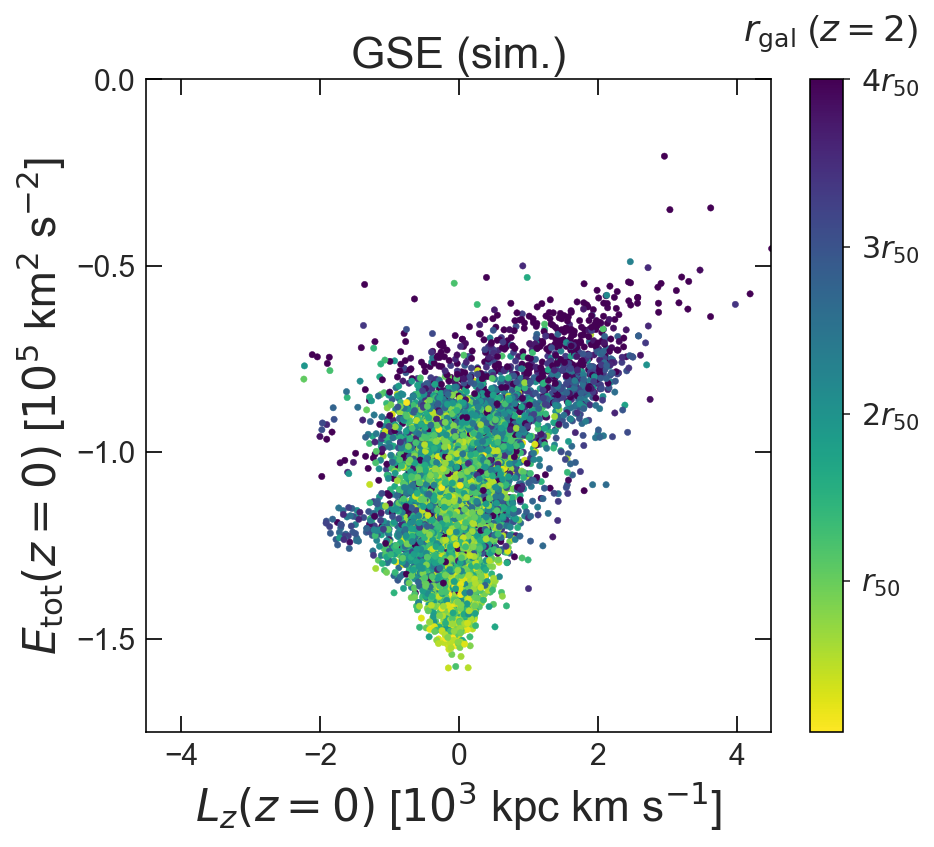

In [82]:
plt.figure(figsize=(7,6))

plt.scatter(ge_500['Lz_noisy'][ge_500['h3_mask']==1], 
            ge_500['E_noisy'][ge_500['h3_mask']==1], s=10,
           c=ge_enhanced['R_com_0'][ge_500['h3_mask']==1]/1.7,
           vmin=0.1, vmax=4, cmap="viridis_r")
plt.xlim(-4.5, 4.5)
plt.ylim(-1.75, 0)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
plt.title("GSE (sim.)", fontsize=22)

plt.ylabel(r"$E_{\mathrm{tot}} (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=22)
plt.xlabel(r"$L_{z} (z=0)$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=22)

clb = plt.colorbar()
clb.set_label(r'$r_{\rm{gal}}$ ($z=2$)', labelpad=-45, y=1.1, rotation=0, fontsize=18)
clb.ax.tick_params(labelsize=15)
clb.ax.locator_params(nbins=3)

clb.set_ticks([1,2,3,4])
clb.set_ticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])

In [88]:
plt.hexbin?

/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: aspect is not supported for Axes with xscale=linear, yscale=log
  fig.canvas.print_figure(bytes_io, **kw)


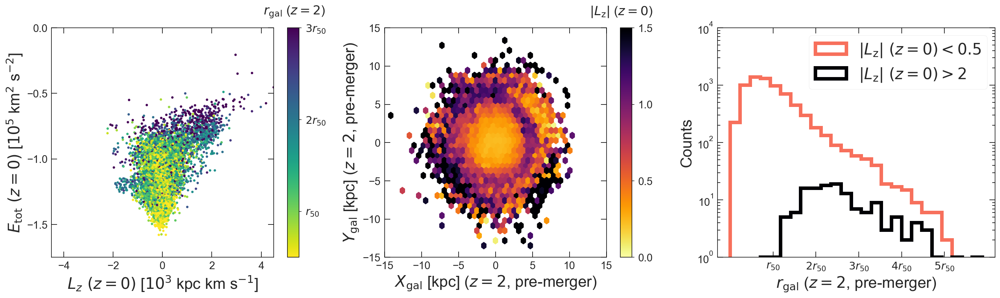

In [802]:
ge_enhanced = ge_444


plt.subplots(1,3, figsize=(24, 6))

plt.subplot(131)
plt.scatter(ge_500['Lz_noisy'][ge_500['h3_mask']==1], 
            ge_500['E_noisy'][ge_500['h3_mask']==1], s=10,
           c=ge_enhanced['R_com_0'][ge_500['h3_mask']==1]/(1.7*1.5),
           vmin=0.5, vmax=3, cmap="viridis_r", rasterized=True)
plt.xlim(-4.5, 4.5)
plt.ylim(-1.75, 0)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (sim.)", fontsize=22,  pad=20)

plt.ylabel(r"$E_{\mathrm{tot}}\ (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=22)
plt.xlabel(r"$L_{z}\ (z=0)$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=22)

clb = plt.colorbar()
clb.set_label(r'$r_{\rm{gal}}$ ($z=2$)', labelpad=-45, y=1.1, rotation=0, fontsize=18)
clb.ax.tick_params(labelsize=15)
clb.ax.locator_params(nbins=3)

clb.set_ticks([1,2,3,4])
clb.set_ticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])




plt.subplot(132)
plt.hexbin(ge_enhanced['X_gal_1']-np.mean(ge_enhanced['X_gal_1']), ge_enhanced['Y_gal_1']-np.mean(ge_enhanced['Y_gal_1']),
          C=np.abs(ge_enhanced['Lz_noisy']), vmin=0, vmax=1.5, cmap="inferno_r",
          gridsize=50, mincnt=1,  reduce_C_function=np.median)
plt.ylim(-15, 15)
plt.xlim(-15, 15)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc] ($z=2$, pre-merger)", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$ [kpc] ($z=2$, pre-merger)", fontsize=22)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (sim.)", fontsize=22,  pad=20)

clb = plt.colorbar()
clb.set_label(r'$|L_{\rm{z}}|$ ($z=0$)', labelpad=-45, y=1.1, rotation=0, fontsize=18)
clb.ax.tick_params(labelsize=15)
clb.ax.locator_params(nbins=3)


plt.subplot(133, aspect="equal",adjustable='box')

colors = plt.cm.magma_r(np.linspace(0,1,11))
plt.hist(ge_enhanced['R_com_0'][(np.abs(ge_enhanced['Lz_noisy'])<0.5) & (ge['h3_mask'])], histtype="step",
        range=(0, 15), bins=25, lw=5, label=r"$|L_{\rm{z}}|\ (z=0)<0.5$", color=colors[3])
plt.hist(ge_enhanced['R_com_0'][(ge_enhanced['Lz_noisy']>2) & (ge['h3_mask'])], histtype="step",
        range=(0,15), bins=25, lw=5, label=r"$|L_{\rm{z}}|\ (z=0)>2$", color=colors[-1])
#plt.xlim(-0.2, 12)
plt.legend(fontsize=22, loc=1)

plt.xlabel(r"$r_{\rm{gal}}$ ($z=2$, pre-merger)", fontsize=22)
plt.ylabel("Counts", fontsize=22)

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (sim.)", fontsize=22, pad=20)


plt.gca().set_xticks(np.array([1.7, 3.4, 5.1, 6.8, 8.5])*1.5)
plt.gca().set_xticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])
plt.yscale("log")
plt.ylim(1, 10**4)

plt.subplots_adjust(wspace=0.2)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Arjuna_Origin.pdf", bbox_inches='tight', dpi=300)

In [390]:
np.linspace(0,1,11)

array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ])

# Metallicity Gradient Mocks

In [9]:
ge_500 = ge_165_new
ge_h3 = ge_500[(ge_500['h3_mask']) & (ge_500['dist_adpt_noisy']>3)]

In [10]:
np.count_nonzero(ge_h3['Lz_noisy']>2), np.count_nonzero(ge_h3['Lz_noisy']**2<0.5**2)

(114, 8732)

In [11]:
# define metallicity gradient wrt Fe/H= -1.2 at centre

#gradient = - #gradient in dex per r50
gradient = 0.
ge_h3['FeH'] = np.random.normal(-1 - ge_h3['R_com_0']*gradient/(1.7*1.5), 0.05)


outer_means = []
inner_means = []

for x in range(10000):
    outer_mean = np.mean(np.random.choice(ge_h3['FeH'][ge_h3['Lz_noisy']>2], 67))
    inner_mean = np.mean(np.random.choice(ge_h3['FeH'][ge_h3['Lz_noisy']**2<0.5**2], 2112))
    outer_means.append(outer_mean)
    inner_means.append(inner_mean)
          
outer_means = np.array(outer_means)
inner_means = np.array(inner_means)

medianize(outer_means), medianize(inner_means), medianize( (outer_means-inner_means)/1.46)

((-0.99, 0.0, -0.010000000000000009), (-1.0, 0.0, 0.0), (0.0, 0.01, 0.0))

In [12]:
# define metallicity gradient wrt Fe/H= -1.2 at centre

#gradient = - #gradient in dex per r50
gradient = 0.15
ge_h3['FeH'] = np.random.normal(-1 - ge_h3['R_com_0']*gradient/(1.7*1.5), 0.05)


outer_means = []
inner_means = []

for x in range(10000):
    outer_mean = np.mean(np.random.choice(ge_h3['FeH'][ge_h3['Lz_noisy']>2], 67))
    inner_mean = np.mean(np.random.choice(ge_h3['FeH'][ge_h3['Lz_noisy']**2<0.5**2], 2112))
    outer_means.append(outer_mean)
    inner_means.append(inner_mean)
          
outer_means = np.array(outer_means)
inner_means = np.array(inner_means)

medianize(outer_means), medianize(inner_means), medianize( (outer_means-inner_means)/1.46)

((-1.39, 0.019999999999999796, -0.020000000000000018),
 (-1.15, 0.0, -0.010000000000000009),
 (-0.16, 0.010000000000000009, -0.010000000000000009))

In [13]:
# define metallicity gradient wrt Fe/H= -1.2 at centre

#gradient = - #gradient in dex per r50
gradient = 0.30
ge_h3['FeH'] = np.random.normal(-1 - ge_h3['R_com_0']*gradient/(1.7*1.5), 0.05)


outer_means = []
inner_means = []

for x in range(10000):
    outer_mean = np.mean(np.random.choice(ge_h3['FeH'][ge_h3['Lz_noisy']>2], 67))
    inner_mean = np.mean(np.random.choice(ge_h3['FeH'][ge_h3['Lz_noisy']**2<0.5**2], 2112))
    outer_means.append(outer_mean)
    inner_means.append(inner_mean)
          
outer_means = np.array(outer_means)
inner_means = np.array(inner_means)

medianize(outer_means), medianize(inner_means), medianize( (outer_means-inner_means)/1.46)

((-1.78, 0.030000000000000027, -0.040000000000000036),
 (-1.31, 0.010000000000000009, 0.0),
 (-0.32, 0.020000000000000018, -0.02999999999999997))

In [14]:
# define metallicity gradient wrt Fe/H= -1.2 at centre

#gradient = - #gradient in dex per r50
gradient = 1
ge_h3['FeH'] = np.random.normal(-1 - ge_h3['R_com_0']*gradient/(1.7*1.5), 0.05)


outer_means = []
inner_means = []

for x in range(10000):
    outer_mean = np.mean(np.random.choice(ge_h3['FeH'][ge_h3['Lz_noisy']>2], 67))
    inner_mean = np.mean(np.random.choice(ge_h3['FeH'][ge_h3['Lz_noisy']**2<0.5**2], 2112))
    outer_means.append(outer_mean)
    inner_means.append(inner_mean)
          
outer_means = np.array(outer_means)
inner_means = np.array(inner_means)

medianize(outer_means), medianize(inner_means), medianize( (outer_means-inner_means)/1.46)

((-3.61, 0.10999999999999988, -0.1200000000000001),
 (-2.03, 0.009999999999999787, -0.020000000000000018),
 (-1.08, 0.08000000000000007, -0.08999999999999986))

[Text(0, 0, '$r_{\\rm{50}}$'),
 Text(0, 0, '$2r_{\\rm{50}}$'),
 Text(0, 0, '$3r_{\\rm{50}}$'),
 Text(0, 0, '$4r_{\\rm{50}}$')]

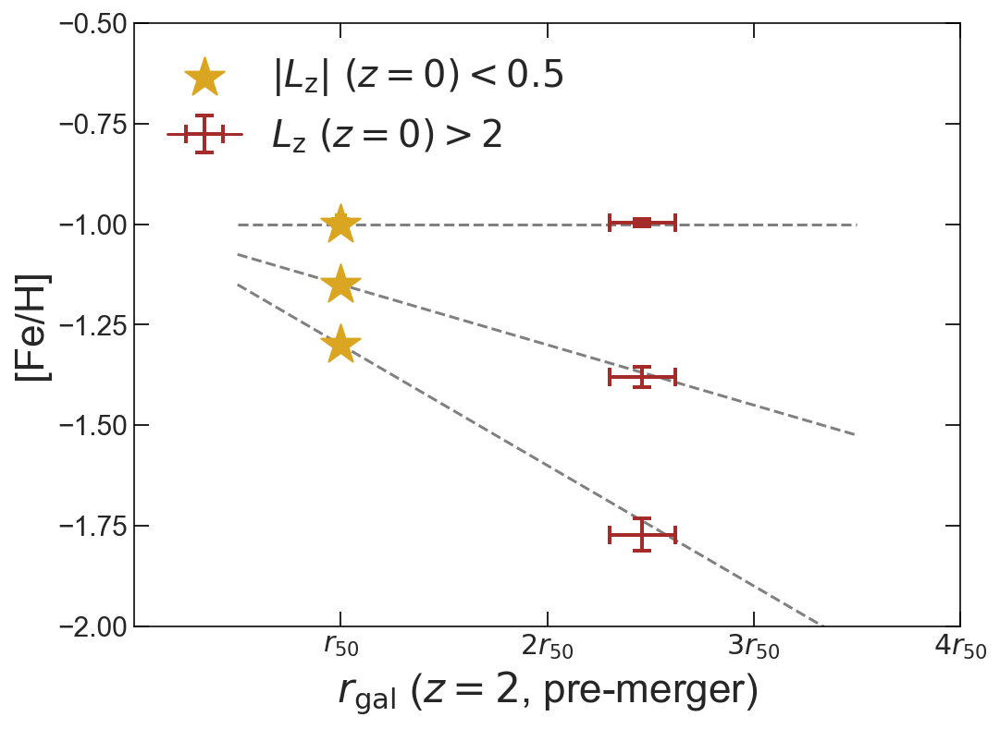

In [15]:
#plt.plot([0.95, 2.5], [-1.17, -1.25], ls="--", c="gray")

plt.figure(figsize=(8,6))


####################
gradient = 0
plt.plot(np.linspace(0.5, 3.5, 10), 
         -1 + np.linspace(0.5, 3.5, 10)*gradient,
        ls="--", c="gray", zorder=0)

plt.scatter(1.0, -1.0,c="goldenrod", marker="*", s=500,
          label=r"$|L_{\rm{z}}|\ (z=0)<0.5$")
# plt.scatter(2.46, -0.9958345932428119, marker="*", s=500,
#            label=r"$|L_{\rm{z}}|\ (z=0)>2$", facecolors='none', edgecolors="brown")

plt.errorbar(1.0, -0.9958345932428119, xerr=np.array([[0.02, 0.02]]).T,
            yerr=np.array([[0.01, 0.01]]).T, c="goldenrod",
            elinewidth=2, capsize=5, capthick=2,)

plt.errorbar(2.46, -0.9958345932428119, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.01, 0.01]]).T, c="brown", elinewidth=2, capsize=5, capthick=2,
            label=r"$L_{\rm{z}}\ (z=0)>2$")

#####################
gradient = -0.15
plt.plot(np.linspace(0.5, 3.5, 10), 
         -1 + np.linspace(0.5, 3.5, 10)*gradient,
        ls="--", c="gray", zorder=0)

plt.scatter(1.0, -1.15,c="goldenrod", marker="*", s=500)


# plt.errorbar(1.0, -1.162533142905614, xerr=np.array([[0.02, 0.02]]).T,
#             yerr=np.array([[0.1/2, 0.1/2]]).T, c="goldenrod", elinewidth=3)

plt.errorbar(2.46, -1.379236419903063, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.1/4, 0.1/4]]).T, c="brown", elinewidth=2,capsize=5, capthick=2)


#####################
gradient = -0.3
plt.plot(np.linspace(0.5, 3.5, 10), 
         -1 + np.linspace(0.5, 3.5, 10)*gradient,
        ls="--", c="gray", zorder=0)

plt.scatter(1.0, -1.30,c="goldenrod", marker="*", s=500)


# plt.errorbar(1.0, -1.3251961259306904, xerr=np.array([[0.02, 0.02]]).T,
#             yerr=np.array([[0.1/2, 0.1/2]]).T, c="goldenrod", elinewidth=5,)

plt.errorbar(2.46, -1.77244681799217, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.04, 0.04]]).T, c="brown", elinewidth=2,capsize=5, capthick=2)




plt.legend(fontsize=20, frameon=False, loc=2)

plt.xlim(0, 4)
plt.ylim(-2, -0.5)


plt.xlabel(r"$r_{\rm{gal}}$ ($z=2$, pre-merger)", fontsize=22)
plt.ylabel("[Fe/H]", fontsize=22)

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (Data)", fontsize=22, pad=20)

plt.gca().set_xticks(np.array([1, 2, 3, 4]))
plt.gca().set_xticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])

#plt.text(0.5, -1.6, r"$d$[Fe/H]/$d(r/r_{\rm{50}})$ = $-$0.05+/-0.01 dex per $r_{\rm{50}}$", fontsize=20)
#plt.text(0.5, -1.75, r"$d$[Fe/H]/$d(r)$ = $-$0.02+/-0.01 dex kpc$^{-1}$", fontsize=20)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/FeH_gradient.pdf", bbox_inches='tight', dpi=300)

# Metallicity gradient measurement

In [90]:
from astropy.stats import bootstrap

In [18]:
ge_enhanced = ge_500
ge = ge_500

In [134]:
arr = (ge_enhanced['R_com_0'][(np.abs(ge_enhanced['Lz_noisy'])<0.5) & (ge['h3_mask'])]/(1.7*1.55))[0:-1:3]

medianize(bootstrap(arr, bootnum=100, bootfunc=np.mean))

(1.0, 0.010000000000000009, -0.010000000000000009)

In [135]:
means = []
for x in range(100):
    arr = np.random.choice((ge_enhanced['R_com_0'][(np.abs(ge_enhanced['Lz_noisy'])<0.5) & (ge['h3_mask'])]/(1.7*1.55)),2112)

    means.append((bootstrap(arr, bootnum=100, bootfunc=np.mean)))
    
medianize(means)

(0.99, 0.020000000000000018, -0.010000000000000009)

In [140]:
means = []
for x in range(100):
    arr = np.random.choice((ge_enhanced['R_com_0'][(ge_enhanced['Lz_noisy']>2) & (ge['h3_mask'])]/(1.7*1.55)),67)

    means.append((bootstrap(arr, bootnum=100, bootfunc=np.mean)))
    
medianize(means)

(2.55, 0.15000000000000036, -0.1599999999999997)

In [137]:
m_arr = []
for x in range(1000):
    m, _ = np.polyfit([np.random.normal(1.0, 0.1/10), np.random.normal(2.61, 0.1)], [np.random.normal(-1.17, 0.01), 
                                                                           np.random.normal(-1.25,0.02)], deg=1)
    m_arr.append(m)
m_arr = np.array(m_arr)

In [138]:
print(medianize(bootstrap(rcat[rc_mask & (rcat['Lz']>2)]['FeH'], samples=1000, 
                    bootfunc=np.median)))

print(medianize(bootstrap(rcat[rc_mask & (rcat['Lz']**2<0.5**2)]['FeH'], 
                    samples=1000, bootfunc=np.median)))

(-1.23, 0.0, -0.020000000000000018)
(-1.17, 0.010000000000000009, 0.0)


In [102]:
print(medianize(bootstrap(rcat[rc_mask & (rcat['Lz']>2)]['FeH'], samples=1000, 
                    bootfunc=np.mean)))

print(medianize(bootstrap(rcat[rc_mask & (rcat['Lz']**2<0.5**2)]['FeH'], 
                    samples=1000, bootfunc=np.mean)))

(-1.33, 0.010000000000000009, -0.020000000000000018)
(-1.21, 0.020000000000000018, 0.0)


In [105]:
(0.24-0.21)/1.55

0.019354838709677417

In [106]:
np.arange(10)[0:-1:2]

array([0, 2, 4, 6, 8])

In [104]:
print(medianize(bootstrap(rcat[rc_mask & (rcat['Lz']>2)]['aFe'], samples=1000, 
                    bootfunc=np.mean)))

print(medianize(bootstrap(rcat[rc_mask & (rcat['Lz']**2<0.5**2)]['aFe'], 
                    samples=1000, bootfunc=np.mean)))

(0.21, 0.0, -0.009999999999999981)
(0.2, 0.0, -0.010000000000000009)


(-0.04, 0.010000000000000002, -0.010000000000000002)

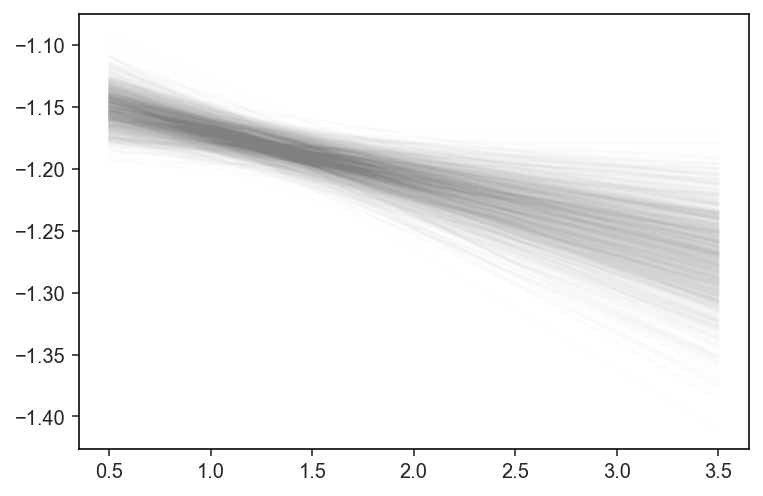

In [144]:
m_arr = []
for x in range(1000):
    fit = np.polyfit([np.random.normal(1.0, 0.1/10), 
                                    np.random.normal(2.55, 0.15)], 
                                   [np.random.normal(-1.17, 0.01), 
                                    np.random.normal(-1.23,0.02)], deg=1)
    m, _ = fit
    m_arr.append(m)
    
    plt.plot(np.linspace(0.5, 3.5, 10), 
             np.polyval(fit, np.linspace(0.5, 3.5, 10)), alpha=0.01, c="gray")
    
medianize(m_arr)

Text(0.5, -1.75, '$d$[Fe/H]/$d(r)$ = $-$0.02+/-0.01 dex kpc$^{-1}$')

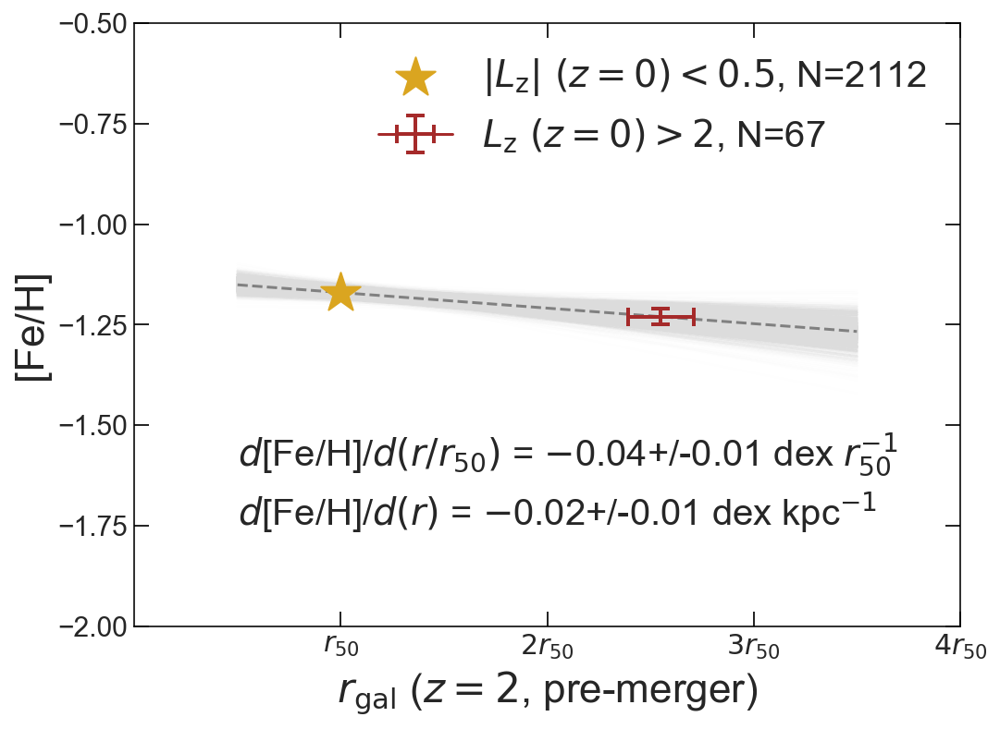

In [16]:
plt.figure(figsize=(8,6))

for x in range(1000):
    plt.plot(np.linspace(0.5, 3.5, 10), np.polyval(np.polyfit([np.random.normal(1.0, 0.1/10), np.random.normal(2.55, 0.15)], [np.random.normal(-1.17, 0.01), 
                                                                           np.random.normal(-1.23,0.02)], deg=1),
              np.linspace(0.5, 3.5, 10)), alpha=0.01/5, c="gainsboro", zorder=0)

plt.plot(np.linspace(0.5, 3.5, 10), 
         np.polyval(np.polyfit([1.0, 2.55], [-1.17, -1.23], deg=1), np.linspace(0.5, 3.5, 10)),
        ls="--", c="gray", zorder=0)


plt.scatter(1.0, -1.17, c="goldenrod", marker="*", s=500,
           label=r"$|L_{\rm{z}}|\ (z=0)<0.5$, N=2112")

plt.errorbar(2.55, -1.23, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.02, 0.02]]).T, c="brown",
            label=r"$L_{\rm{z}}\ (z=0)>2$, N=67",
            elinewidth=2, capsize=5, capthick=2,)


plt.legend(fontsize=20, frameon=False)

plt.xlim(0, 4)
plt.ylim(-2, -0.5)


plt.xlabel(r"$r_{\rm{gal}}$ ($z=2$, pre-merger)", fontsize=22)
plt.ylabel("[Fe/H]", fontsize=22)

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (Data)", fontsize=22, pad=20)

plt.gca().set_xticks(np.array([1, 2, 3, 4]))
plt.gca().set_xticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])

plt.text(0.5, -1.6, r"$d$[Fe/H]/$d(r/r_{\rm{50}})$ = $-$0.04+/-0.01 dex $r_{\rm{50}}^{-1}$", fontsize=20)
plt.text(0.5, -1.75, r"$d$[Fe/H]/$d(r)$ = $-$0.02+/-0.01 dex kpc$^{-1}$", fontsize=20)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/FeH_gradient.pdf", bbox_inches='tight', dpi=300)

# Consolidated Fe/H gradient figure

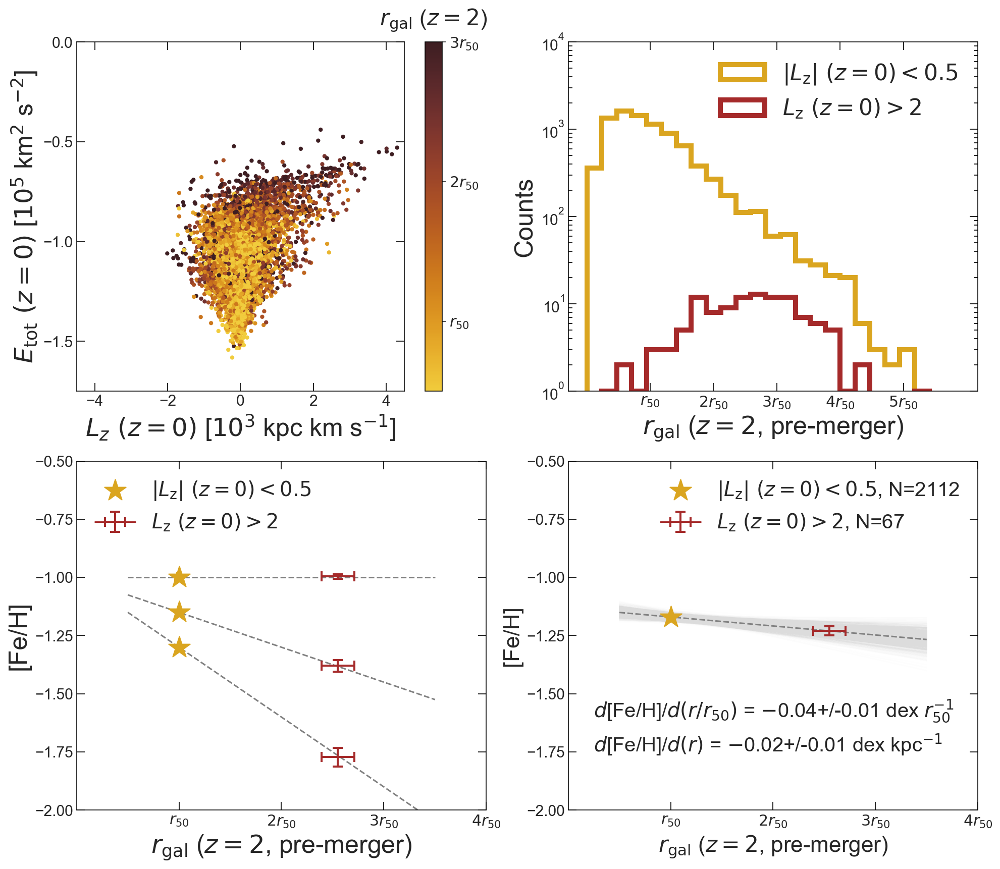

In [22]:
plt.subplots(2,2, figsize=(16, 14))

plt.subplot(221)
plt.scatter(ge_500['Lz_noisy'][ge_500['h3_mask']==1], 
            ge_500['E_noisy'][ge_500['h3_mask']==1], s=10,
           c=ge_enhanced['R_com_0'][ge_500['h3_mask']==1]/(1.7*1.5),
           vmin=0.5, vmax=3, cmap=amber_trunc, rasterized=True)
plt.xlim(-4.5, 4.5)
plt.ylim(-1.75, 0)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (sim.)", fontsize=22,  pad=20)

plt.ylabel(r"$E_{\mathrm{tot}}\ (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=25)
plt.xlabel(r"$L_{z}\ (z=0)$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=25)

clb = plt.colorbar()
clb.set_label(r'$r_{\rm{gal}}$ ($z=2$)', labelpad=-45, y=1.1, rotation=0, fontsize=22)
clb.ax.tick_params(labelsize=15)
clb.ax.locator_params(nbins=3)

clb.set_ticks([1,2,3,4])
clb.set_ticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])



plt.subplot(222)
colors = plt.cm.magma_r(np.linspace(0,1,11))
plt.hist(ge_enhanced['R_com_0'][(np.abs(ge_enhanced['Lz_noisy'])<0.5) & (ge['h3_mask'])], histtype="step",
        range=(0, 15), bins=25, lw=5, label=r"$|L_{\rm{z}}|\ (z=0)<0.5$", color="goldenrod")
plt.hist(ge_enhanced['R_com_0'][(ge_enhanced['Lz_noisy']>2) & (ge['h3_mask'])], histtype="step",
        range=(0,15), bins=25, lw=5, label=r"$L_{\rm{z}}\ (z=0)>2$", color="brown")
#plt.xlim(-0.2, 12)
plt.legend(fontsize=22, loc=1, frameon=False)

plt.xlabel(r"$r_{\rm{gal}}$ ($z=2$, pre-merger)", fontsize=25)
plt.ylabel("Counts", fontsize=25)

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (sim.)", fontsize=22, pad=20)


plt.gca().set_xticks(np.array([1.7, 3.4, 5.1, 6.8, 8.5])*1.5)
plt.gca().set_xticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])
plt.yscale("log")
plt.ylim(1, 10**4)




plt.subplot(223)

####################
gradient = 0
plt.plot(np.linspace(0.5, 3.5, 10), 
         -1 + np.linspace(0.5, 3.5, 10)*gradient,
        ls="--", c="gray", zorder=0)

plt.scatter(1.0, -1.0,c="goldenrod", marker="*", s=500,
          label=r"$|L_{\rm{z}}|\ (z=0)<0.5$")
plt.errorbar(1.0, -1.0, xerr=np.array([[0.02, 0.02]]).T,
            yerr=np.array([[0.01, 0.01]]).T, c="goldenrod",
            elinewidth=2, capsize=5, capthick=2,)
plt.errorbar(2.55, -0.9958345932428119, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.01, 0.01]]).T, c="brown", elinewidth=2, capsize=5, capthick=2,
            label=r"$L_{\rm{z}}\ (z=0)>2$")

#####################
gradient = -0.15
plt.plot(np.linspace(0.5, 3.5, 10), 
         -1 + np.linspace(0.5, 3.5, 10)*gradient,
        ls="--", c="gray", zorder=0)
plt.scatter(1.0, -1.15,c="goldenrod", marker="*", s=500)
plt.errorbar(2.55, -1.379236419903063, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.1/4, 0.1/4]]).T, c="brown", elinewidth=2,capsize=5, capthick=2)


#####################
gradient = -0.3
plt.plot(np.linspace(0.5, 3.5, 10), 
         -1 + np.linspace(0.5, 3.5, 10)*gradient,
        ls="--", c="gray", zorder=0)

plt.scatter(1.0, -1.30,c="goldenrod", marker="*", s=500)
plt.errorbar(2.55, -1.77244681799217, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.04, 0.04]]).T, c="brown", elinewidth=2,capsize=5, capthick=2)

plt.legend(fontsize=20, frameon=False, loc=2)
plt.xlim(0, 4)
plt.ylim(-2, -0.5)
plt.xlabel(r"$r_{\rm{gal}}$ ($z=2$, pre-merger)", fontsize=25)
plt.ylabel("[Fe/H]", fontsize=25)
plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
plt.gca().set_xticks(np.array([1, 2, 3, 4]))
plt.gca().set_xticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])




plt.subplot(224)

for x in range(1000):
    plt.plot(np.linspace(0.5, 3.5, 10), np.polyval(np.polyfit([np.random.normal(1.0, 0.1/10), np.random.normal(2.55, 0.15)], [np.random.normal(-1.17, 0.01), 
                                                                           np.random.normal(-1.23,0.02)], deg=1),
              np.linspace(0.5, 3.5, 10)), alpha=0.01/5, c="gainsboro", zorder=0)

plt.plot(np.linspace(0.5, 3.5, 10), 
         np.polyval(np.polyfit([1.0, 2.55], [-1.17, -1.23], deg=1), np.linspace(0.5, 3.5, 10)),
        ls="--", c="gray", zorder=0)


plt.scatter(1.0, -1.17, c="goldenrod", marker="*", s=500,
           label=r"$|L_{\rm{z}}|\ (z=0)<0.5$, N=2112")

plt.errorbar(2.55, -1.23, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.02, 0.02]]).T, c="brown",
            label=r"$L_{\rm{z}}\ (z=0)>2$, N=67",
            elinewidth=2, capsize=5, capthick=2,)
plt.legend(fontsize=20, frameon=False)
plt.xlim(0, 4)
plt.ylim(-2, -0.5)
plt.xlabel(r"$r_{\rm{gal}}$ ($z=2$, pre-merger)", fontsize=22)
plt.ylabel("[Fe/H]", fontsize=22)
plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (Data)", fontsize=22, pad=20)

plt.gca().set_xticks(np.array([1, 2, 3, 4]))
plt.gca().set_xticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])
plt.text(0.25, -1.6, r"$d$[Fe/H]/$d(r/r_{\rm{50}})$ = $-$0.04+/-0.01 dex $r_{\rm{50}}^{-1}$", fontsize=20)
plt.text(0.25, -1.75, r"$d$[Fe/H]/$d(r)$ = $-$0.02+/-0.01 dex kpc$^{-1}$", fontsize=20)


plt.subplots_adjust(wspace=0.2)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/FeH_grad.pdf", bbox_inches='tight', dpi=300)

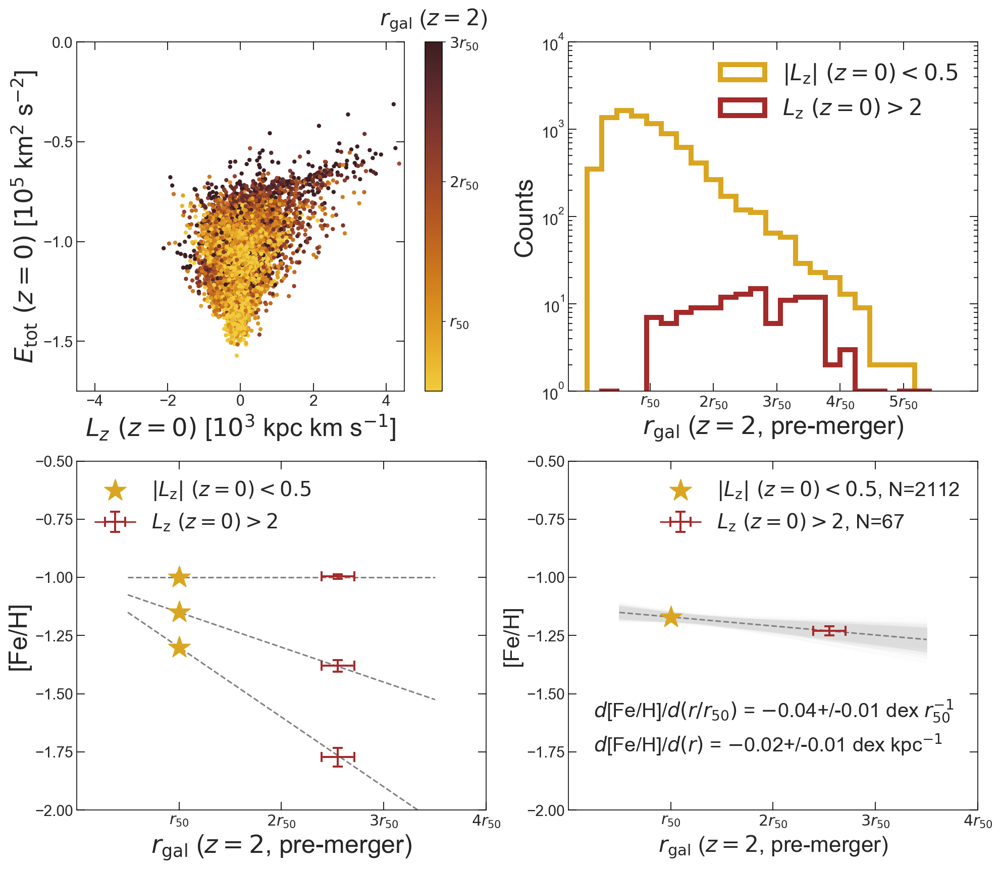

In [164]:
plt.subplots(2,2, figsize=(16, 14))

plt.subplot(221)
plt.scatter(ge_500['Lz_noisy'][ge_500['h3_mask']==1], 
            ge_500['E_noisy'][ge_500['h3_mask']==1], s=10,
           c=ge_enhanced['R_com_0'][ge_500['h3_mask']==1]/(1.7*1.5),
           vmin=0.5, vmax=3, cmap=amber_trunc, rasterized=True)
plt.xlim(-4.5, 4.5)
plt.ylim(-1.75, 0)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (sim.)", fontsize=22,  pad=20)

plt.ylabel(r"$E_{\mathrm{tot}}\ (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=25)
plt.xlabel(r"$L_{z}\ (z=0)$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=25)

clb = plt.colorbar()
clb.set_label(r'$r_{\rm{gal}}$ ($z=2$)', labelpad=-45, y=1.1, rotation=0, fontsize=22)
clb.ax.tick_params(labelsize=15)
clb.ax.locator_params(nbins=3)

clb.set_ticks([1,2,3,4])
clb.set_ticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])



plt.subplot(222)
colors = plt.cm.magma_r(np.linspace(0,1,11))
plt.hist(ge_enhanced['R_com_0'][(np.abs(ge_enhanced['Lz_noisy'])<0.5) & (ge['h3_mask'])], histtype="step",
        range=(0, 15), bins=25, lw=5, label=r"$|L_{\rm{z}}|\ (z=0)<0.5$", color="goldenrod")
plt.hist(ge_enhanced['R_com_0'][(ge_enhanced['Lz_noisy']>2) & (ge['h3_mask'])], histtype="step",
        range=(0,15), bins=25, lw=5, label=r"$L_{\rm{z}}\ (z=0)>2$", color="brown")
#plt.xlim(-0.2, 12)
plt.legend(fontsize=22, loc=1, frameon=False)

plt.xlabel(r"$r_{\rm{gal}}$ ($z=2$, pre-merger)", fontsize=25)
plt.ylabel("Counts", fontsize=25)

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (sim.)", fontsize=22, pad=20)


plt.gca().set_xticks(np.array([1.7, 3.4, 5.1, 6.8, 8.5])*1.5)
plt.gca().set_xticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])
plt.yscale("log")
plt.ylim(1, 10**4)




plt.subplot(223)

####################
gradient = 0
plt.plot(np.linspace(0.5, 3.5, 10), 
         -1 + np.linspace(0.5, 3.5, 10)*gradient,
        ls="--", c="gray", zorder=0)

plt.scatter(1.0, -1.0,c="goldenrod", marker="*", s=500,
          label=r"$|L_{\rm{z}}|\ (z=0)<0.5$")
plt.errorbar(1.0, -1.0, xerr=np.array([[0.02, 0.02]]).T,
            yerr=np.array([[0.01, 0.01]]).T, c="goldenrod",
            elinewidth=2, capsize=5, capthick=2,)
plt.errorbar(2.55, -0.9958345932428119, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.01, 0.01]]).T, c="brown", elinewidth=2, capsize=5, capthick=2,
            label=r"$L_{\rm{z}}\ (z=0)>2$")

#####################
gradient = -0.15
plt.plot(np.linspace(0.5, 3.5, 10), 
         -1 + np.linspace(0.5, 3.5, 10)*gradient,
        ls="--", c="gray", zorder=0)
plt.scatter(1.0, -1.15,c="goldenrod", marker="*", s=500)
plt.errorbar(2.55, -1.379236419903063, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.1/4, 0.1/4]]).T, c="brown", elinewidth=2,capsize=5, capthick=2)


#####################
gradient = -0.3
plt.plot(np.linspace(0.5, 3.5, 10), 
         -1 + np.linspace(0.5, 3.5, 10)*gradient,
        ls="--", c="gray", zorder=0)

plt.scatter(1.0, -1.30,c="goldenrod", marker="*", s=500)
plt.errorbar(2.55, -1.77244681799217, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.04, 0.04]]).T, c="brown", elinewidth=2,capsize=5, capthick=2)

plt.legend(fontsize=20, frameon=False, loc=2)
plt.xlim(0, 4)
plt.ylim(-2, -0.5)
plt.xlabel(r"$r_{\rm{gal}}$ ($z=2$, pre-merger)", fontsize=25)
plt.ylabel("[Fe/H]", fontsize=25)
plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
plt.gca().set_xticks(np.array([1, 2, 3, 4]))
plt.gca().set_xticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])




plt.subplot(224)

for x in range(1000):
    plt.plot(np.linspace(0.5, 3.5, 10), np.polyval(np.polyfit([np.random.normal(1.0, 0.1/10), np.random.normal(2.55, 0.15)], [np.random.normal(-1.17, 0.01), 
                                                                           np.random.normal(-1.23,0.02)], deg=1),
              np.linspace(0.5, 3.5, 10)), alpha=0.01/5, c="gainsboro", zorder=0)

plt.plot(np.linspace(0.5, 3.5, 10), 
         np.polyval(np.polyfit([1.0, 2.55], [-1.17, -1.23], deg=1), np.linspace(0.5, 3.5, 10)),
        ls="--", c="gray", zorder=0)


plt.scatter(1.0, -1.17, c="goldenrod", marker="*", s=500,
           label=r"$|L_{\rm{z}}|\ (z=0)<0.5$, N=2112")

plt.errorbar(2.55, -1.23, xerr=np.array([[0.16, 0.16]]).T,
            yerr=np.array([[0.02, 0.02]]).T, c="brown",
            label=r"$L_{\rm{z}}\ (z=0)>2$, N=67",
            elinewidth=2, capsize=5, capthick=2,)
plt.legend(fontsize=20, frameon=False)
plt.xlim(0, 4)
plt.ylim(-2, -0.5)
plt.xlabel(r"$r_{\rm{gal}}$ ($z=2$, pre-merger)", fontsize=22)
plt.ylabel("[Fe/H]", fontsize=22)
plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.title("GSE (Data)", fontsize=22, pad=20)

plt.gca().set_xticks(np.array([1, 2, 3, 4]))
plt.gca().set_xticklabels([r"$r_{\rm{50}}$", r"$2r_{\rm{50}}$", r"$3r_{\rm{50}}$", r"$4r_{\rm{50}}$",
                          r"$5r_{\rm{50}}$", r"$6r_{\rm{50}}$", r"$7r_{\rm{50}}$"])
plt.text(0.25, -1.6, r"$d$[Fe/H]/$d(r/r_{\rm{50}})$ = $-$0.04+/-0.01 dex $r_{\rm{50}}^{-1}$", fontsize=20)
plt.text(0.25, -1.75, r"$d$[Fe/H]/$d(r)$ = $-$0.02+/-0.01 dex kpc$^{-1}$", fontsize=20)


plt.subplots_adjust(wspace=0.2)
plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/FeH_grad.pdf", bbox_inches='tight', dpi=300)

In [1358]:
np.count_nonzero( (ge_500['Lz_noisy']>1.5) & (ge_500['h3_mask']==1)), np.count_nonzero( (ge_165['Lz_noisy']>1.5) & (ge_165['h3_mask']==1))

(420, 323)

In [20]:
import matplotlib.colors as colors
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    new_cmap = colors.LinearSegmentedColormap.from_list(
        'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=minval, b=maxval),
        cmap(np.linspace(minval, maxval, n)))
    return new_cmap

amber_trunc = truncate_colormap(plt.get_cmap('cmr.amber_r'), minval=0.1, maxval=0.8, n=100)

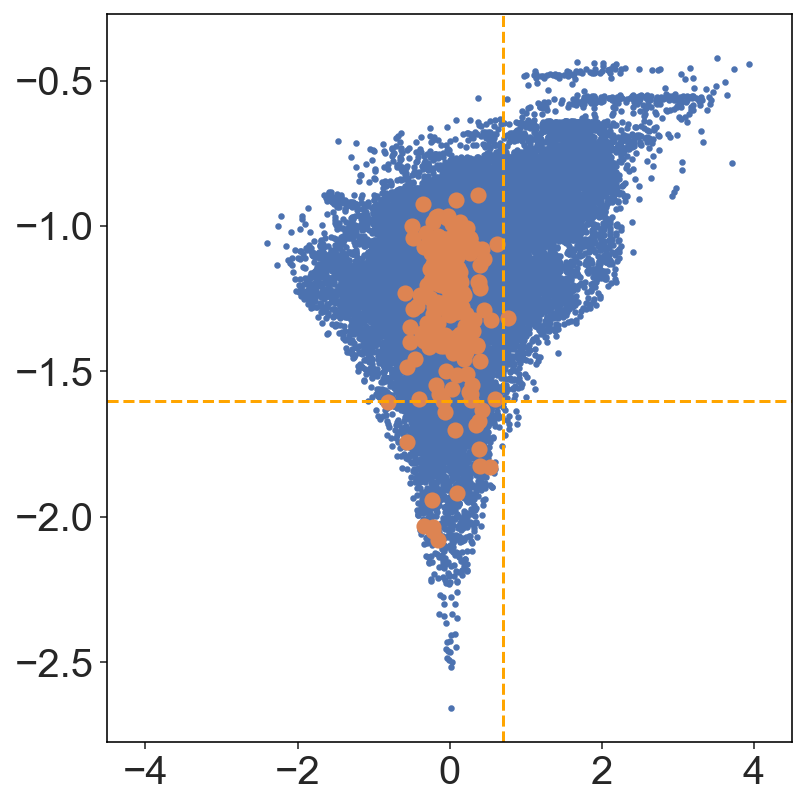

In [1309]:
plt.figure(figsize=(6,6))
plt.scatter(ge_444['Lz'], ge_444['E_tot_pot1'], s=5, rasterized=True)
plt.scatter(ge_444['Lz'][ge_444['R_com_0']<0.3], ge_444['E_tot_pot1'][ge_444['R_com_0']<0.3], s=50)
plt.xlim(-4.5, 4.5)
plt.axvline(0.7, ls="--", c="orange")
plt.axhline(-1.6, ls="--", c="orange")

Text(0.5, 1.0, 'ge_150')

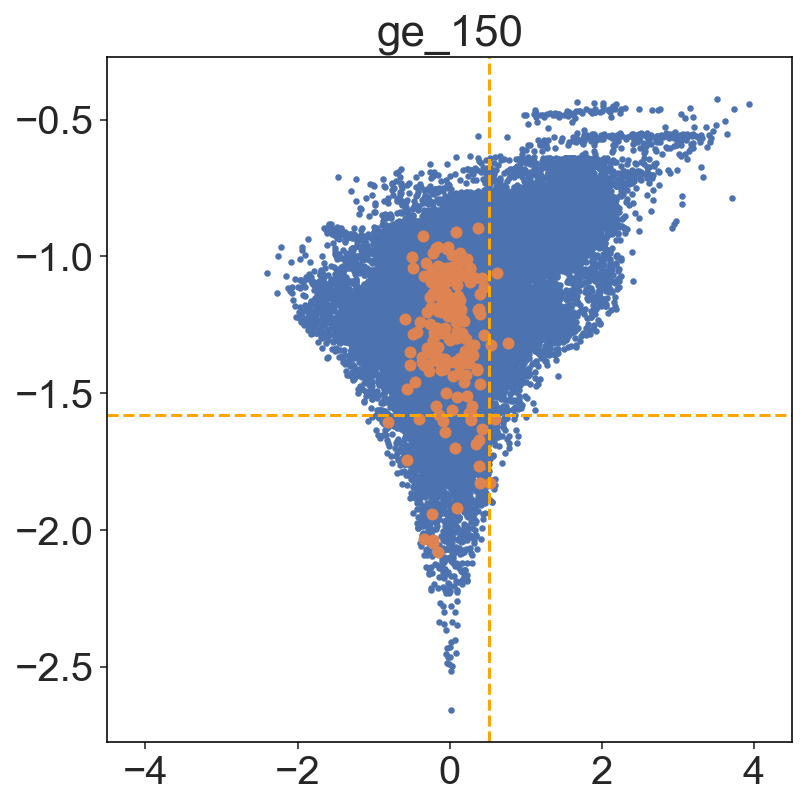

In [1330]:
plt.figure(figsize=(6,6))
plt.scatter(ge_500['Lz'], ge_500['E_tot_pot1'], s=5, rasterized=True)
plt.scatter(ge_500['Lz'][ge_500['R_com_0']<0.3], ge_500['E_tot_pot1'][ge_500['R_com_0']<0.3], s=25)
plt.xlim(-4.5, 4.5)

plt.axvline(0.522704488384978, ls="--", c="orange")
plt.axhline(-1.579262, ls="--", c="orange")
#plt.axvline(0.7, ls="--", c="orange")
#plt.axhline(-1.6, ls="--", c="orange")
plt.title("ge_150", fontsize=22)

Text(0.5, 0, '$r_{50}$')

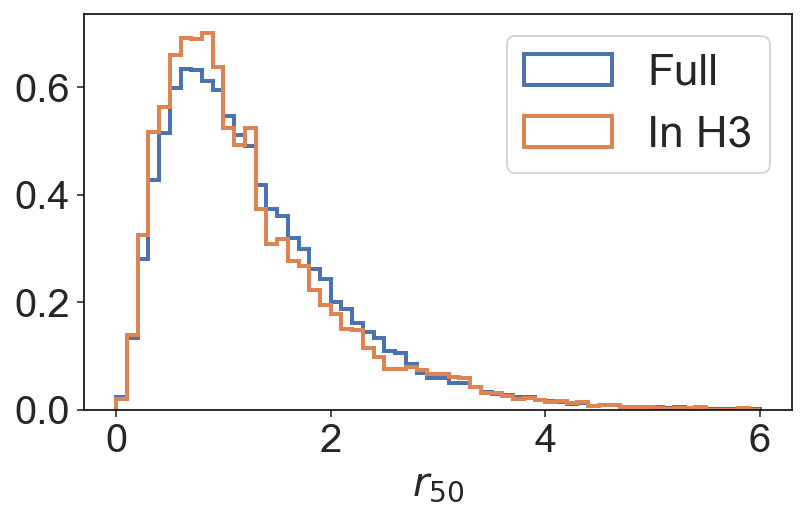

In [1344]:
plt.hist(ge_500['R_com_0']/(1.67*1.5), histtype="step", lw=2, 
        density=True, range=(0,6), bins=60, label="Full")
plt.hist(ge_500['R_com_0'][ge_500['h3_mask']]/(1.67*1.5), histtype="step", lw=2, 
        density=True, range=(0,6), bins=60, label="In H3")
plt.legend(fontsize=22)

plt.xlabel("$r_{50}$")

Text(0.5, 1.0, 'ge_165')

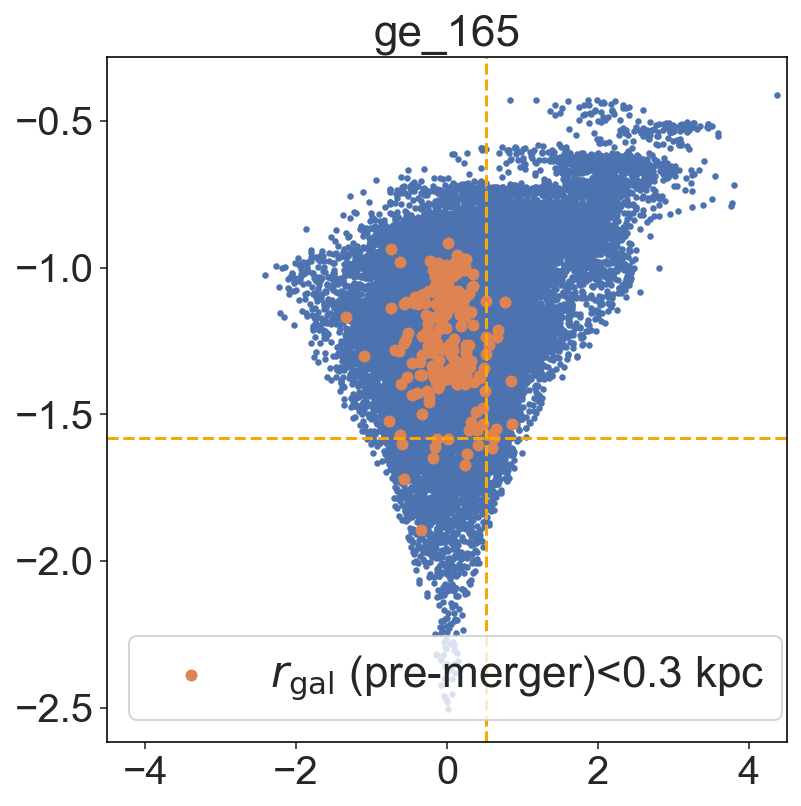

In [1332]:
plt.figure(figsize=(6,6))
plt.scatter(ge_165['Lz'], ge_165['E_tot_pot1'], s=5, rasterized=True)
plt.scatter(ge_165['Lz'][ge_165['R_com_0']<0.3], ge_165['E_tot_pot1'][ge_165['R_com_0']<0.3], s=25,
           label=r"$r_{\rm{gal}}$ (pre-merger)<0.3 kpc")
plt.xlim(-4.5, 4.5)
# plt.axvline(0.7, ls="--", c="orange")
# plt.axhline(-1.6, ls="--", c="orange")

plt.axvline(0.522704488384978, ls="--", c="orange")
plt.axhline(-1.579262, ls="--", c="orange")

plt.legend(fontsize=22)

#0.522704488384978	-1.5792679262122777

plt.title("ge_165", fontsize=22)

# Metallicity gradient literature summary?  local galaxies and quiescent galaxies? 

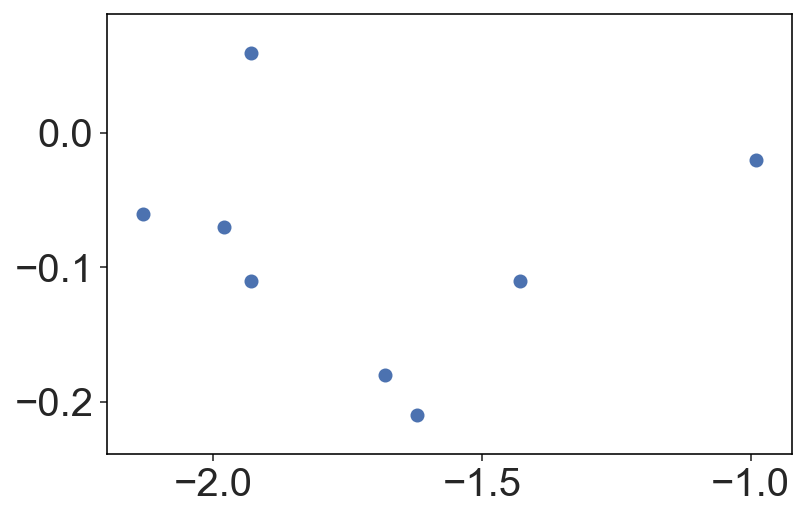

In [1257]:
# dfeh = [-0.02, -0.11, -0.18, -0.21, +0.06, -0.11, -0.07, -0.06]
# feh = [-0.99, -1.43, -1.68,-1.62, -1.93, -1.93, -1.98]

dfeh = [-0.02, -0.11, -0.18, -0.21, +0.06, -0.11, -0.07, -0.06]
feh = [-0.99, -1.43, -1.68,-1.62, -1.93, -1.93, -1.98, -2.13]

plt.scatter(feh, dfeh)

# Density profile prediction/link to apocentres

/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


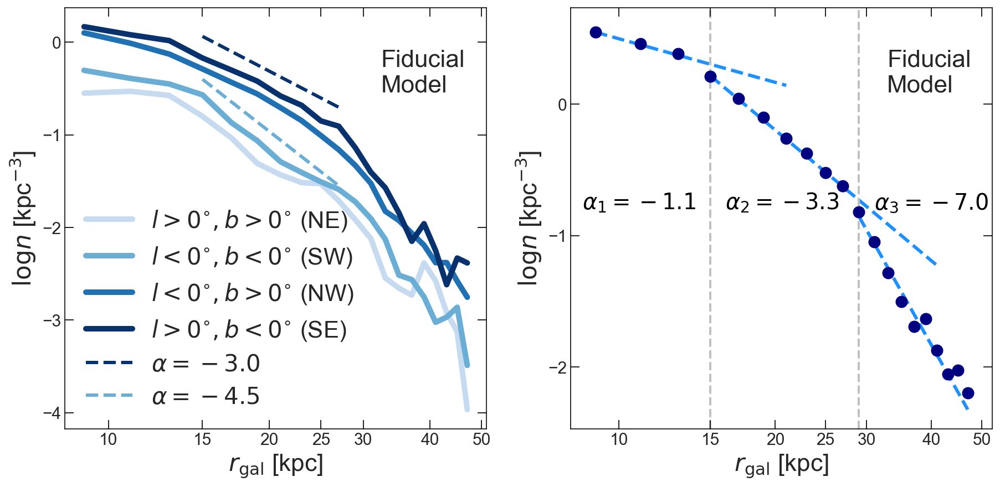

In [389]:
plt.subplots(1, 2, figsize=(30/2,14/2))

plt.subplot(1,2,1)

plt.subplot(1,2,1)

cmap = plt.get_cmap('Blues')

masks = [(ge_165['l_deg']>0) & (ge_165['b_deg']>0),
        (ge_165['l_deg']<0) & (ge_165['b_deg']<0),
         (ge_165['l_deg']<0) & (ge_165['b_deg']>0),
        (ge_165['l_deg']>0) & (ge_165['b_deg']<0)]

for mask,label, cmap_col in zip(masks, ['$l>0^{\circ},b>0^{\circ}$ (NE)',
                                        '$l<0^{\circ},b<0^{\circ}$ (SW)',
                                        '$l<0^{\circ},b>0^{\circ}$ (NW)',
                                        '$l>0^{\circ},b<0^{\circ}$ (SE)'],
                                [cmap(0.25), cmap(0.50), cmap(0.75), cmap(0.99)]):
    counts, edges = np.histogram(ge_165['R_gal'][mask],
                                 np.arange(50)[0:-1:2])
    edges = (edges[0:-1] + edges[1::])/2
    plt.plot( np.log10(edges[edges>7]), np.log10((counts/(4*np.pi*edges**2))[edges>7]),
            label=label, lw=5, c=cmap_col)


expo = 3
init = np.log10((counts/(4*np.pi*edges**2)))[edges>13][0]
plt.plot( np.log10(edges[edges>13][0:7]), 
         np.log10((edges[edges>13][0:7]**-expo)*(10**init/(edges[edges>12][0:7]**-expo)[0])*1)+0.42,
        c=cmap(0.99), ls="--", lw=3, zorder=0, label=r"$\alpha=-3.0$")


expo = 4.5
init = np.log10((counts/(4*np.pi*edges**2)))[edges>13][0]
plt.plot( np.log10(edges[edges>13][0:7]), 
         np.log10((edges[edges>13][0:7]**-expo)*(10**init/(edges[edges>12][0:7]**-expo)[0])*1)+0.05,
        c=cmap(0.50), ls="--", lw=3, zorder=0, label=r"$\alpha=-4.5$")


plt.gca().set_xticks(np.log10([10, 15, 20, 25, 30, 40, 50]))
plt.gca().set_xticklabels([10, 15, 20, 25, 30, 40, 50])
plt.legend(fontsize=21, frameon=False)
plt.xlabel(r"$r_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$\log{n}$ [kpc$^{-3}$]", fontsize=22)
plt.locator_params(axis='y',nbins=6)
plt.minorticks_off()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
#plt.ylim(-4.2, 0.4)
plt.text(0.75,0.8, "Fiducial\nModel", fontsize=22, transform = plt.gca().transAxes)

plt.subplot(1,2,2)
counts, edges = np.histogram(ge_165['R_gal'],
                             np.arange(50)[0:-1:2])
edges = (edges[0:-1] + edges[1::])/2

##########################
expo = 1.1
init = np.log10((counts/(4*np.pi*edges**2)))[edges>7][0]
plt.plot( np.log10(edges[edges>7][0:7]), 
         np.log10((edges[edges>7][0:7]**-expo)*(10**init/(edges[edges>7][0:7]**-expo)[0])*1),
        c="dodgerblue", ls="--", lw=3, zorder=0,)
##########################
expo = 3.3
init = np.log10((counts/(4*np.pi*edges**2)))[edges>7][0]/1.06
plt.plot( np.log10(edges[edges>7][3:-3]), 
         np.log10((edges[edges>7][3:-3]**-expo)*(10**init/(edges[edges>7][3:-3]**-expo)[0])*0.5),
        c="dodgerblue", ls="--", lw=3, zorder=0,)
##########################
expo = 7.0
init = np.log10((counts/(4*np.pi*edges**2)))[edges>7][0]
plt.plot( np.log10(edges[edges>7][10::]), 
         np.log10((edges[edges>7][10::]**-expo)*(10**init/(edges[edges>7][10::]**-expo)[0])*0.5)-1.1,
        c="dodgerblue", ls="--", lw=3, zorder=0,
        label="Naidu+21\nfid. sim.\nall-sky profile\n"r"$\rho\propto r_{\rm{gal}}^{\alpha}$")
##########################

plt.text(0.75,0.8, "Fiducial\nModel", fontsize=22, transform = plt.gca().transAxes)



plt.scatter( np.log10(edges[edges>7]), np.log10((counts/(4*np.pi*edges**2))[edges>7]),
           c="navy", s=100)


plt.gca().set_xticks(np.log10([10, 15, 20, 25, 30, 40, 50]))
plt.gca().set_xticklabels([10, 15, 20, 25, 30, 40, 50])
#plt.legend(fontsize=21, frameon=True)
plt.xlabel(r"$r_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$\log{n}$ [kpc$^{-3}$]", fontsize=22)
plt.locator_params(axis='y',nbins=6)
plt.minorticks_off()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

plt.axvline(np.log10(15), ls="--", zorder=0, color="silver",lw=2)
plt.axvline(np.log10(29), ls="--", zorder=0, color="silver",lw=2)

plt.text(np.log10(8.5), -0.80, r"$\alpha_{1} = -1.1$", fontsize=20, c="k")
plt.text(np.log10(16), -0.80,r"$\alpha_{2} = -3.3$", fontsize=20, c="k")
plt.text(np.log10(31), -0.80,r"$\alpha_{3} = -7.0$", fontsize=20, c="k")
#plt.ylim(-4.2, 0.4)

plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Proposed_Profilev3.pdf", 
             bbox_inches='tight', dpi=300)

# Simulation pics

In [73]:
import readsnap
filename = "./snaps/GE_M1_9_10x"

poshalo  = readsnap.read_block(filename, "POS ", parttype=2) # load positions of halo particles
idhalo  = readsnap.read_block(filename, "ID  ", parttype=2) # load IDs of halo particles
poshalo = poshalo[np.argsort(idhalo)]
idhalo = np.sort(idhalo)

(-7.5, 7.5)

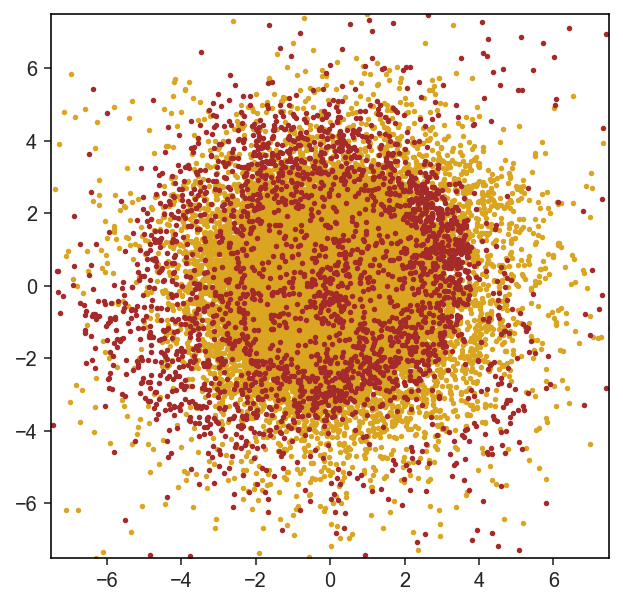

In [115]:
plt.figure(figsize=(5,5))

plt.scatter(-poshalo[:,0][np.abs(ge_500['Lz_noisy'])<0.5], 
poshalo[:,1][np.abs(ge_500['Lz_noisy'])<0.5],
           s=3, c="goldenrod")

plt.scatter(-poshalo[:,0][ge_500['Lz_noisy']>1.5], 
poshalo[:,1][ge_500['Lz_noisy']>1.5],
           s=3, c="brown")

plt.xlim(-7.5, 7.5)
plt.ylim(-7.5, 7.5)

[array([ True,  True, False, ...,  True, False,  True])]

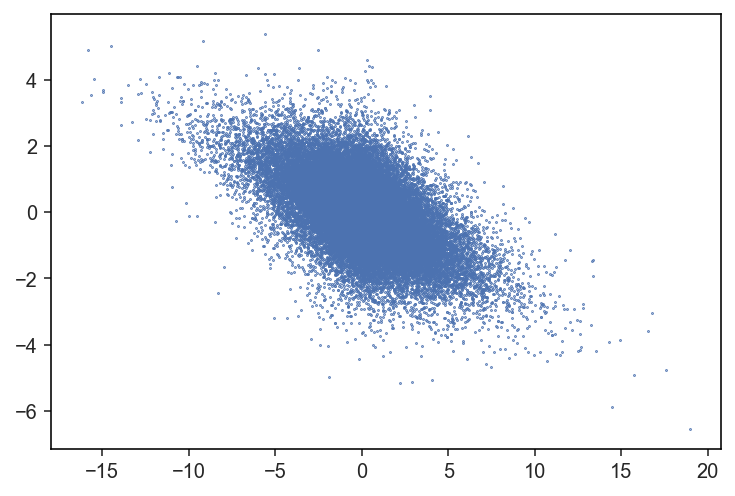

In [65]:
plt.scatter(ge_500['X_gal_1']-np.mean(ge_500['X_gal_1']), 
            ge_500['Z_gal_1']-np.mean(ge_500['Z_gal_1']), s=0.15)

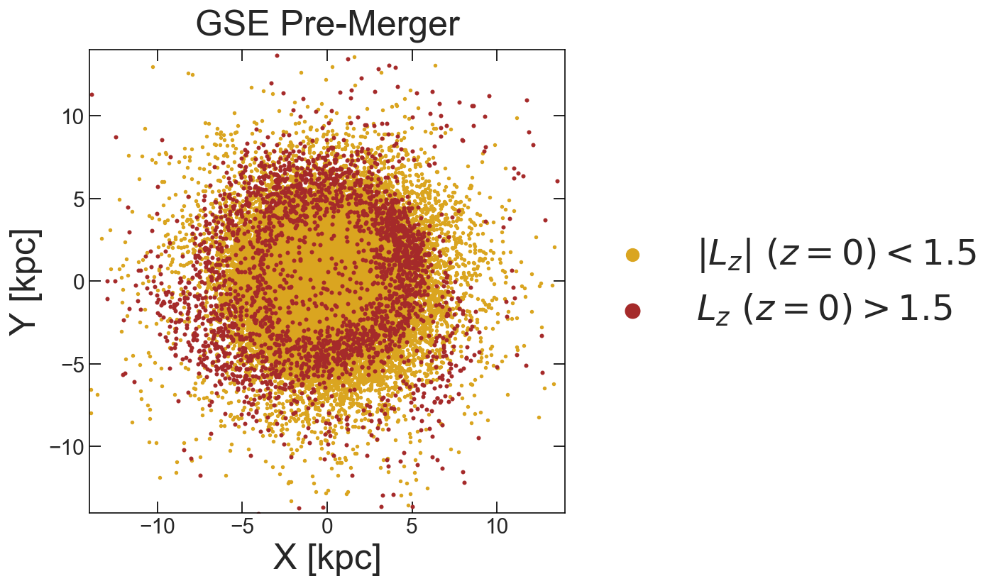

In [129]:
plt.figure(figsize=(6, 6))


plt.scatter(ge_500['X_gal_1'][np.abs(ge_500['Lz_noisy'])<1.5]-np.mean(ge_500['X_gal_1']),
            ge_500['Y_gal_1'][np.abs(ge_500['Lz_noisy'])<1.5]-np.mean(ge_500['Y_gal_1']), 
            s=3, c="goldenrod",
           label=r"$|L_{z}|\ (z=0)<1.5$",
           rasterized=True)
plt.scatter(ge_500['X_gal_1'][ge_500['Lz_noisy']>1.5]-np.mean(ge_500['X_gal_1']), 
            ge_500['Y_gal_1'][ge_500['Lz_noisy']>1.5]-np.mean(ge_500['Y_gal_1']),
            s=4, c="brown",
           label=r"$L_{z}\ (z=0)>1.5$",
           rasterized=True)

plt.xlim(-14, 14)
plt.ylim(-14, 14)


# plt.scatter(-poshalo[:,0][np.abs(ge_500['Lz_noisy'])<0.5], 
#             poshalo[:,1][np.abs(ge_500['Lz_noisy'])<0.5],
#            s=3, c="goldenrod",
#            label=r"$|L_{z}|\ (z=0)<0.5$",
#            rasterized=True)

# plt.scatter(-poshalo[:,0][ge_500['Lz_noisy']>2], 
#             poshalo[:,1][ge_500['Lz_noisy']>2],
#            s=6, c="brown",
#            label=r"$L_{z}\ (z=0)>2$",
#            rasterized=True)

# plt.xlim(-8, 8)
# plt.ylim(-8, 8)


plt.title("GSE Pre-Merger", pad=10, fontsize=25)

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

plt.xlabel("X [kpc]", fontsize=25)
plt.ylabel("Y [kpc]", fontsize=25)

plt.legend(fontsize=25, loc="center left", markerscale=5, frameon=False, 
          bbox_to_anchor=(1, 0.5))

plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Sim_Pics_pt1_v2.pdf", 
            bbox_inches='tight', dpi=300)

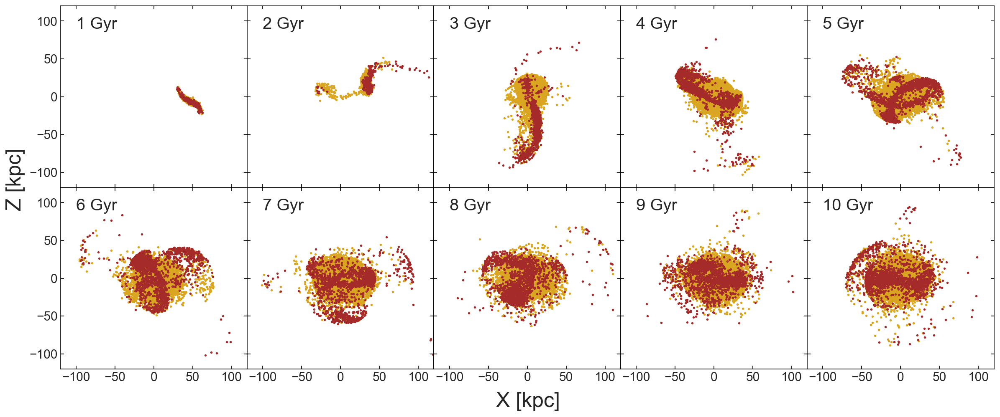

In [57]:
plt.subplots(2, 5, figsize=(20, 8))

counter = 1
for idx in (np.linspace(0, 500, 11)+1)[1::].astype(int):
    plt.subplot(2, 5, counter)
    
    plt.scatter(ge_500['X_gal_%s'%idx][np.abs(ge_500['Lz_noisy'])<1.5],
                ge_500['Z_gal_%s'%idx][np.abs(ge_500['Lz_noisy'])<1.5], s=3, c="goldenrod",
               rasterized=True)
    plt.scatter(ge_500['X_gal_%s'%idx][ge_500['Lz_noisy']>2], 
                ge_500['Z_gal_%s'%idx][ge_500['Lz_noisy']>2], s=3, c="brown", alpha=1,
               rasterized=True)
    plt.xlim(-120, 120)
    plt.ylim(-120, 120)
    plt.minorticks_off()
    
    plt.locator_params(axis='x',nbins=6)
    plt.locator_params(axis='y',nbins=6)

    
    if counter>5:
        plt.tick_params(axis='x', labelsize=15, length=4, width=1,top="off", direction="in")
    else:
        plt.tick_params(axis='x', labelsize=0, length=4, width=1,top="off", direction="in")
        
    if (counter==1)|(counter==6):
        plt.tick_params(axis='y', labelsize=15, length=4, width=1,right="off", direction="in")
    else:
        plt.tick_params(axis='y', labelsize=0, length=4, width=1,right="off", direction="in")
    
    plt.text(-100, 90, "%i Gyr"%(counter), fontsize=20)
    
    counter = counter+1
    
plt.subplots_adjust(wspace=0, hspace=0)
plt.text(-520, -170, "X [kpc]", fontsize=25)
plt.text(-1150, 95, "Z [kpc]", fontsize=25, rotation="90")
plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Sim_Pics_pt2v2.pdf", bbox_inches='tight', dpi=300)

In [ ]:
plt.figure(figsize=(5,5))
plt.text(-100, 90, "%i Gyr"%(counter), fontsize=20)

Text(-100, 90, '11 Gyr')

# GSE beyond H3: healpy all sky

In [199]:
lmc_galacto.x, lmc_galacto.y, lmc_galacto.z

(<Quantity -0.62712453 kpc>,
 <Quantity -40.94946458 kpc>,
 <Quantity -26.9261236 kpc>)

In [87]:
coord.ICRS(ra=157.34122*u.degree, dec=15.34594*u.degree).transform_to(coord.Galactic)

<Galactic Coordinate: (l, b) in deg
    (225.25343308, 55.00830177)>

In [84]:
coord.Galactic(l=220*u.degree, b=50*u.degree, distance=18*u.kpc).transform_to(coord.Galactocentric)

<Galactocentric Coordinate (galcen_coord=<ICRS Coordinate: (ra, dec) in deg
    (266.4051, -28.936175)>, galcen_distance=8.122 kpc, galcen_v_sun=(12.9, 245.6, 7.78) km / s, z_sun=20.8 pc, roll=0.0 deg): (x, y, z) in kpc
    (-16.94992843, -7.43717841, 13.83222957)>

In [85]:
(17**2 + 7**2 + 14**2)**0.5

23.108440016582687

In [88]:
coord.Galactic(l=220*u.degree, b=50*u.degree).l.wrap_at(180*u.degree)

<Angle -140. deg>

In [238]:
import healpy as hp
import h3ify_utils

lmc = coord.ICRS(ra=80.8941667*u.degree, dec=-69.7561111*u.degree,
                 pm_ra_cosdec=1.910*u.mas/u.yr, pm_dec=0.229*u.mas/u.yr,
                radial_velocity=262.2*u.km/u.s, distance=49.59*u.kpc)
lmc_galacto = lmc.transform_to(coord.Galactocentric())
w_lmc = gd.PhaseSpacePosition(pos=[lmc_galacto.x.value, lmc_galacto.y.value, lmc_galacto.z.value]*u.kpc,
                     vel=[lmc_galacto.v_x.value, lmc_galacto.v_y.value, lmc_galacto.v_z.value]*u.km/u.s)

orb_lmc = h3ify_utils.compute_orbit(w_lmc, gp.MilkyWayPotential(),
                          dt=-1*u.Myr, t1=2*u.Gyr, t2=0*u.Gyr,)

gc_lmc = coord.Galactocentric(x=orb_lmc.x, y=orb_lmc.y, z=orb_lmc.z,
                     v_x = orb_lmc.v_x, v_y=orb_lmc.v_y, v_z= orb_lmc.v_z)
gal_lmc = gc_lmc.transform_to(coord.Galactic)

lmc_x, lmc_y, lmc_z = gc_lmc.x.value, gc_lmc.y.value, gc_lmc.z.value

pos_galactocentric = np.array([lmc_x, lmc_y, lmc_z]).T
lmc_l_gal_deg, lmc_b_gal_deg, lmc_l_gal_rad, lmc_b_gal_rad = pos_cartesian_to_galactic(pos_galactocentric)

pos_galactic = np.array([lmc_x+8.3, lmc_y, lmc_z]).T
lmc_l_deg, lmc_b_deg, lmc_l_rad, lmc_b_rad = pos_cartesian_to_galactic(pos_galactic)

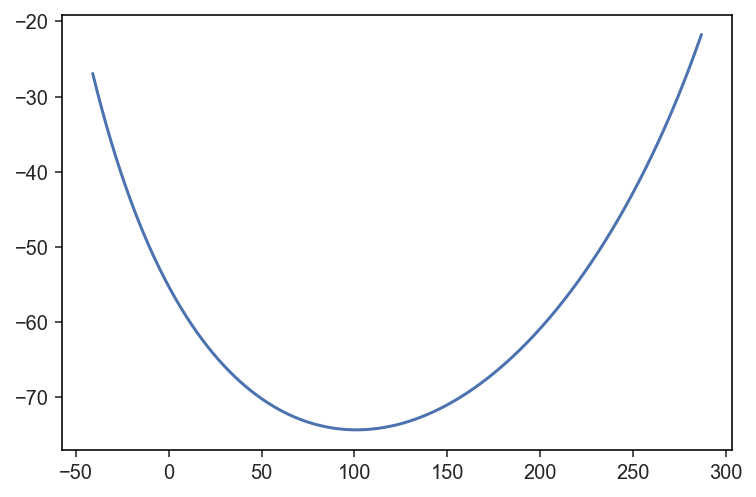

In [626]:
plt.plot(gc_lmc.y, gc_lmc.z)

In [598]:
gc_lmc.x[-1], gc_lmc.y[-1], gc_lmc.z[-1]

(<Quantity 23.46016175 kpc>,
 <Quantity 286.95206837 kpc>,
 <Quantity -21.7345998 kpc>)

In [239]:
lmc_galacto

<Galactocentric Coordinate (galcen_coord=<ICRS Coordinate: (ra, dec) in deg
    (266.4051, -28.936175)>, galcen_distance=8.122 kpc, galcen_v_sun=(12.9, 245.6, 7.78) km / s, z_sun=20.8 pc, roll=0.0 deg): (x, y, z) in kpc
    (-0.62712453, -40.94946458, -26.9261236)
 (v_x, v_y, v_z) in km / s
    (-37.2917813, -225.90485734, 227.81230229)>

In [1026]:
def pos_cartesian_to_galactic(pos):
    """
    Transforms carteisian coordinates to galactic.

    Parameters:
    -----------
    pos : 3d-numpy array.

    returns:
    --------
    l :
    numpy.array([]) in radians

    b : numpy.array([])
    in radians

    """
    ## transforming to galactic coordinates.

    c_gal = coord.SkyCoord(pos, representation='cartesian', frame='galactic')
    c_gal.representation = 'spherical'

    ## to degrees and wrapping l
    l_degrees = c_gal.l.wrap_at(180 * u.deg)#.radian
    b_degrees = c_gal.b#.radian
    
    l_rad = c_gal.l.wrap_at(180 * u.deg).radian
    b_rad = c_gal.b.radian

    return l_degrees, b_degrees, l_rad, b_rad

###### GSE full simulation ######

pos_galactic = np.array([ge_500['X_gal_501']+8.3, ge_500['Y_gal_501'], ge_500['Z_gal_501']]).T
ge_500['l_deg'], ge_500['b_deg'], ge_500['l_rad'], ge_500['b_rad'] = pos_cartesian_to_galactic(pos_galactic)

pos_galactocentric = np.array([ge_500['X_gal_501'], ge_500['Y_gal_501'], ge_500['Z_gal_501']]).T
ge_500['l_gal_deg'], ge_500['b_gal_deg'], ge_500['l_gal_rad'], ge_500['b_gal_rad'] = pos_cartesian_to_galactic(pos_galactocentric)


# pos_galactic = np.array([ge_444['X_gal_444']+8.3, ge_444['Y_gal_444'], ge_444['Z_gal_444']]).T
# ge_444['l_deg'], ge_444['b_deg'], ge_444['l_rad'], ge_444['b_rad'] = pos_cartesian_to_galactic(pos_galactic)

# pos_galactocentric = np.array([ge_444['X_gal_444'], ge_444['Y_gal_444'], ge_444['Z_gal_444']]).T
# ge_444['l_gal_deg'], ge_444['b_gal_deg'], ge_444['l_gal_rad'], ge_444['b_gal_rad'] = pos_cartesian_to_galactic(pos_galactocentric)


# pos_galactic = np.array([ge_400['X_gal_400']+8.3, ge_400['Y_gal_400'], ge_400['Z_gal_400']]).T
# ge_400['l_deg'], ge_400['b_deg'], ge_400['l_rad'], ge_400['b_rad'] = pos_cartesian_to_galactic(pos_galactic)

# pos_galactocentric = np.array([ge_400['X_gal_400'], ge_400['Y_gal_400'], ge_400['Z_gal_400']]).T
# ge_400['l_gal_deg'], ge_400['b_gal_deg'], ge_400['l_gal_rad'], ge_400['b_gal_rad'] = pos_cartesian_to_galactic(pos_galactocentric)

# pos_galactic = np.array([ge_500['X_gal_501']+8.3, ge_500['Y_gal_501'], ge_500['Z_gal_501']]).T
# ge_500['l_deg'], ge_500['b_deg'], ge_500['l_rad'], ge_500['b_rad'] = pos_cartesian_to_galactic(pos_galactic)

# pos_galactocentric = np.array([ge_500['X_gal_501'], ge_500['Y_gal_501'], ge_500['Z_gal_501']]).T
# ge_500['l_gal_deg'], ge_500['b_gal_deg'], ge_500['l_gal_rad'], ge_500['b_gal_rad'] = pos_cartesian_to_galactic(pos_galactocentric)

# ##################

# pos_galactic = np.array([ge_500['X_gal_444']+8.3, ge_500['Y_gal_444'], ge_500['Z_gal_444']]).T
# ge_500['l_deg_444'], ge_500['b_deg_444'], ge_500['l_rad_444'], ge_500['b_rad_444'] = pos_cartesian_to_galactic(pos_galactic)

# pos_galactocentric = np.array([ge_500['X_gal_444'], ge_500['Y_gal_444'], ge_500['Z_gal_444']]).T
# ge_500['l_gal_deg_444'], ge_500['b_gal_deg_444'], ge_500['l_gal_rad_444'], ge_500['b_gal_rad_444'] = pos_cartesian_to_galactic(pos_galactocentric)

# ##################

# pos_galactic = np.array([ge_500['X_gal_400']+8.3, ge_500['Y_gal_400'], ge_500['Z_gal_400']]).T
# ge_500['l_deg_400'], ge_500['b_deg_400'], ge_500['l_rad_400'], ge_500['b_rad_400'] = pos_cartesian_to_galactic(pos_galactic)

# pos_galactocentric = np.array([ge_500['X_gal_400'], ge_500['Y_gal_400'], ge_500['Z_gal_400']]).T
# ge_500['l_gal_deg_400'], ge_500['b_gal_deg_400'], ge_500['l_gal_rad_400'], ge_500['b_gal_rad_400'] = pos_cartesian_to_galactic(pos_galactocentric)

# ###################

# ge_500['R_gal_444'] = (ge_500['X_gal_444']**2 + ge_500['Y_gal_444']**2 + ge_500['Z_gal_444']**2)**0.5
# ge_500['R_gal_400'] = (ge_500['X_gal_400']**2 + ge_500['Y_gal_400']**2 + ge_500['Z_gal_400']**2)**0.5


######## GSE COM ########## 

ge_x, ge_y, ge_z = track_com_3d(ge_500)

pos_galactocentric = np.array([ge_x, ge_y, ge_z]).T
com_l_gal_deg, com_b_gal_deg, com_l_gal_rad, com_b_gal_rad = pos_cartesian_to_galactic(pos_galactocentric)

pos_galactic = np.array([ge_x+8.3, ge_y, ge_z]).T
com_l_deg, com_b_deg, com_l_rad, com_b_rad = pos_cartesian_to_galactic(pos_galactic)

######## LMC ###########

In [192]:
def produce_map(df, mask):
    
    l = df['l_rad'][mask]
    b = df['b_rad'][mask]
    
    phi = l
    theta = -(b - np.pi/2)

    nside = 16
    pixel_indices = hp.ang2pix(nside, theta, phi)
    m = np.zeros(hp.nside2npix(nside))

    unq, counts = np.unique(pixel_indices, return_counts=True)

    for x, y in zip(unq, counts):
        m[x] = y
        
    return m


def produce_quantity_map(df, mask, plot_quantity):
    
    plot_quantity_masked = df[plot_quantity][mask]
    
    l = df['l_rad'][mask]
    b = df['b_rad'][mask]
    
    phi = l
    theta = -(b - np.pi/2)


    nside = 16
    pixel_indices = hp.ang2pix(nside, theta, phi)
    m = np.zeros(hp.nside2npix(nside))

    unq, counts = np.unique(pixel_indices, return_counts=True)

    for x, y in zip(unq, counts):
        m[x] = y

    m[m==0] = hp.UNSEEN
    
    for x, y in zip(unq, counts):
        m[x] = np.mean(plot_quantity_masked[pixel_indices==x])
        
    return m


# def produce_map_gal(l, b):
    
# #    l = df['l_gal_rad'][mask]
# #    b = df['b_gal_rad'][mask]

#     phi = l
#     theta = -(b - np.pi/2)

#     nside = 16
#     pixel_indices = hp.ang2pix(nside, theta, phi)
#     m = np.zeros(hp.nside2npix(nside))

#     unq, counts = np.unique(pixel_indices, return_counts=True)

#     for x, y in zip(unq, counts):
#         m[x] = y
        
#     return m

In [1380]:
np.count_nonzero((ge_500['R_gal']>60) & (ge_500['R_gal']<80) )

159

Sigma is 254.796540 arcmin (0.074117 rad) 
-> fwhm is 600.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:306: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1389: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


0.0 180.0 -180.0 180.0
The interval between parallels is 45 deg 0.00'.
The interval between meridians is 90 deg 0.00'.


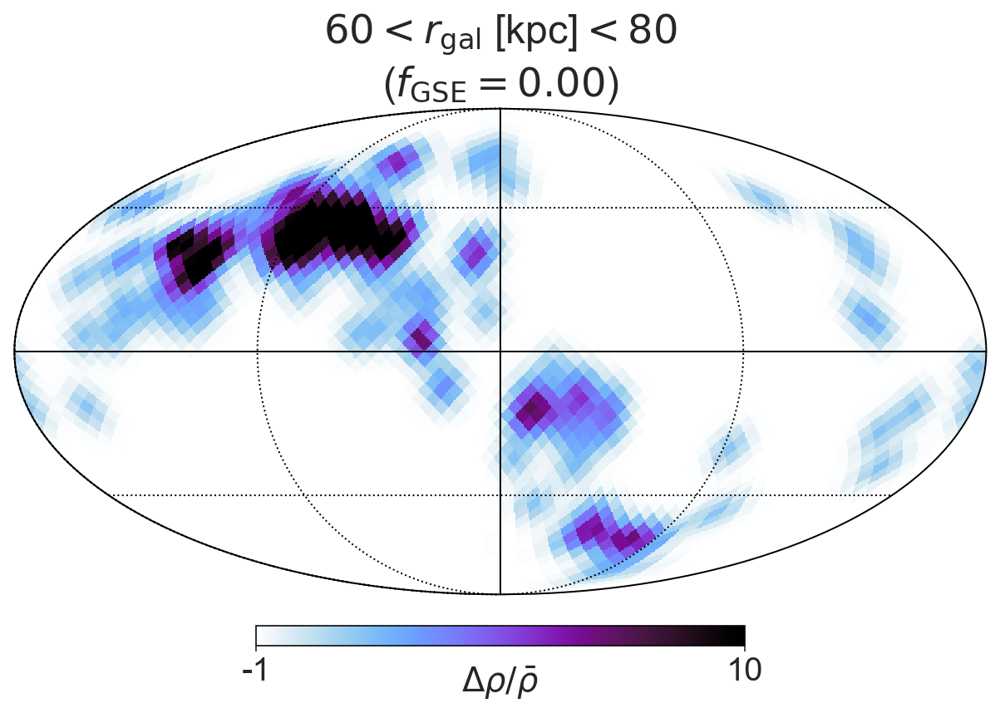

In [338]:
mask = (ge_500['R_gal']>60) & (ge_500['R_gal']<80) 
m = produce_map(ge_500, mask)

hp.mollview(hp.smoothing(m/np.mean(m) - 1, fwhm=np.radians(10.)), 
            title=r"$60<r_{\rm{gal}}$ [kpc]$<80$""\n"r"($f_{\rm{GSE}}=%.2f$)"%np.mean(mask), 
            cmap="cmr.voltage_r", flip="geo", unit="\n"r"$\Delta\rho/\bar{\rho}$",
           min=-1, max=10)

fontsize=20
matplotlib.rcParams.update({'font.size':fontsize})

f = matplotlib.pyplot.gcf().get_children()
HpxAx = f[1]
CbAx = f[2]

coord_text_obj = HpxAx.get_children()[0]
coord_text_obj.set_fontsize(fontsize)

unit_text_obj = CbAx.get_children()[1]
unit_text_obj.set_fontsize(fontsize)


# hp.projplot(np.linspace(-180, 180, 361), np.ones(361)*30, lonlat=True, c="silver", ls="--", lw=3)
# hp.projplot(np.linspace(-180, 180, 361), -np.ones(361)*10, lonlat=True, c="silver", ls="--", lw=3)

# hp.projplot(np.ones(181)*10, np.linspace(-90, 90, 181), lonlat=True, c="silver", ls="--", lw=3)
# hp.projplot(np.ones(181)*120, np.linspace(-90, 90, 181), lonlat=True, c="silver", ls="--", lw=3)




hp.graticule(dpar=45, dmer=90)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/HP_0010.pdf", dpi=300, bbox_inches = "tight")

In [ ]:
com_l_gal_deg, com_b_gal_deg, com_l_gal_rad, com_b_gal_rad 

Sigma is 254.796540 arcmin (0.074117 rad) 
-> fwhm is 600.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:306: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1429: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1389: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


0.0 180.0 -180.0 180.0
The interval between parallels is 45 deg 0.00'.
The interval between meridians is 90 deg 0.00'.


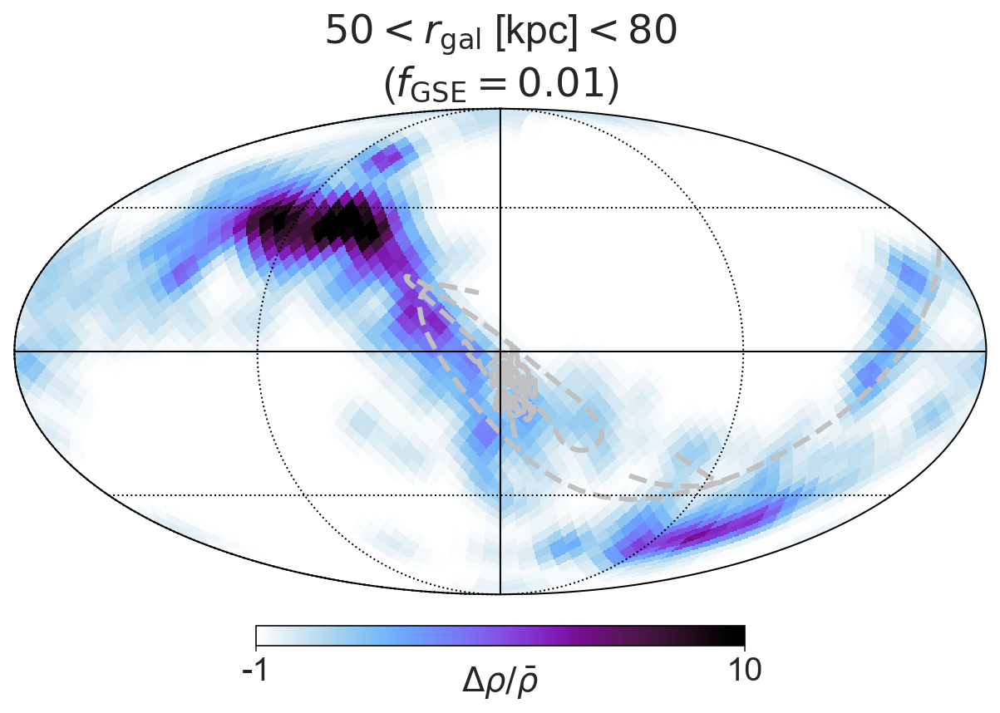

In [395]:
#produce_map_gal(ge_500, )


mask = (ge_500['R_gal']>50) & (ge_500['R_gal']<100) 
m = produce_map_gal(ge_500, mask)

hp.mollview(hp.smoothing(m/np.mean(m) - 1, fwhm=np.radians(10.)), 
            title=r"$50<r_{\rm{gal}}$ [kpc]$<80$""\n"r"($f_{\rm{GSE}}=%.2f$)"%np.mean(mask), 
            cmap="cmr.voltage_r", flip="geo", unit="\n"r"$\Delta\rho/\bar{\rho}$",
           min=-1, max=10)

fontsize=20
matplotlib.rcParams.update({'font.size':fontsize})

f = matplotlib.pyplot.gcf().get_children()
HpxAx = f[1]
CbAx = f[2]

coord_text_obj = HpxAx.get_children()[0]
coord_text_obj.set_fontsize(fontsize)

unit_text_obj = CbAx.get_children()[1]
unit_text_obj.set_fontsize(fontsize)


hp.projplot(com_l_deg, com_b_deg, lonlat=True, c="silver", ls="--", lw=3)


hp.graticule(dpar=45, dmer=90)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/HP_0010.pdf", dpi=300, bbox_inches = "tight")

Sigma is 254.796540 arcmin (0.074117 rad) 
-> fwhm is 600.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:306: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1451: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1429: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1389: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_lay

0.0 180.0 -180.0 180.0
The interval between parallels is 45 deg 0.00'.
The interval between meridians is 90 deg 0.00'.


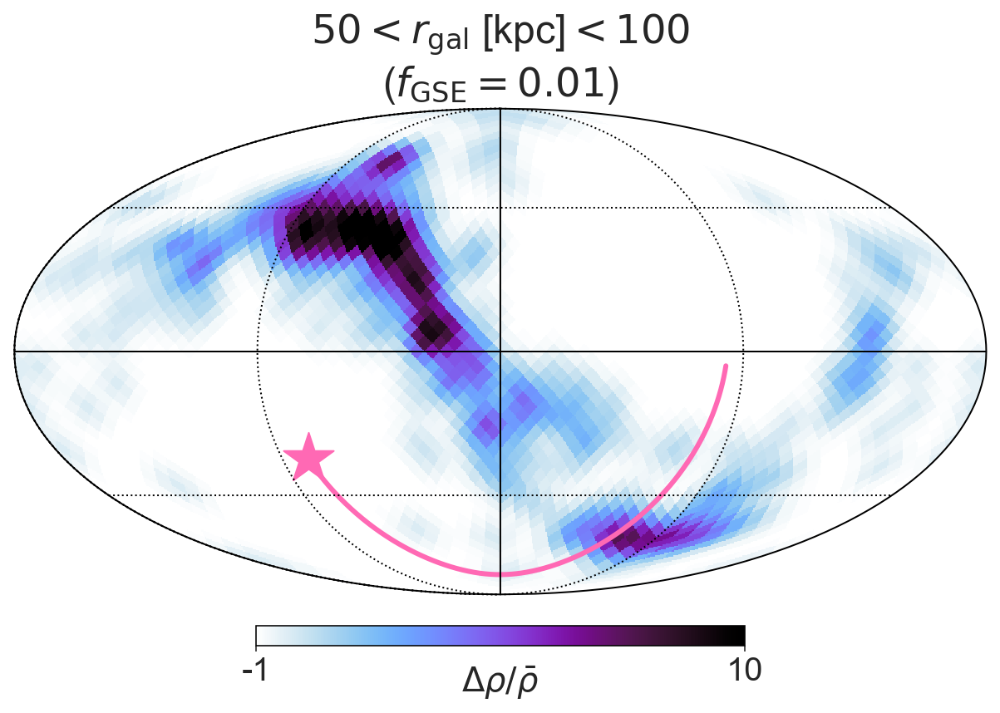

In [1379]:
#produce_map_gal(ge_500, )


mask = (ge_500['R_gal']>50) & (ge_500['R_gal']<100) 
#m = produce_map_gal(ge_500['l_gal_rad'][mask], ge_500['b_gal_rad'][mask])
m = produce_map(ge_500, mask)

hp.mollview(hp.smoothing(m/np.mean(m) - 1, fwhm=np.radians(10.)), 
            title=r"$50<r_{\rm{gal}}$ [kpc]$<100$""\n"r"($f_{\rm{GSE}}=%.2f$)"%np.mean(mask), 
            cmap="cmr.voltage_r", flip="geo", unit="\n"r"$\Delta\rho/\bar{\rho}$",
           min=-1, max=10)

fontsize=20
matplotlib.rcParams.update({'font.size':fontsize})

f = matplotlib.pyplot.gcf().get_children()
HpxAx = f[1]
CbAx = f[2]

coord_text_obj = HpxAx.get_children()[0]
coord_text_obj.set_fontsize(fontsize)

unit_text_obj = CbAx.get_children()[1]
unit_text_obj.set_fontsize(fontsize)


#hp.projplot(com_l_deg, com_b_deg, lonlat=True, c="silver", ls="-", lw=3)

hp.projscatter(lmc_l_deg[0], lmc_b_deg[0], lonlat=True, c="hotpink", marker="*", s=1000)
hp.projplot(lmc_l_deg, lmc_b_deg, lonlat=True, c="hotpink", ls="-", lw=3)


hp.graticule(dpar=45, dmer=90)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/HP_0010.pdf", dpi=300, bbox_inches = "tight")

In [469]:
def produce_quantity_map(df, mask, plot_quantity):
    
    plot_quantity_masked = df[plot_quantity][mask]
    
    l = df['l_rad'][mask]
    b = df['b_rad'][mask]
    
    phi = l
    theta = -(b - np.pi/2)


    nside = 16
    pixel_indices = hp.ang2pix(nside, theta, phi)
    m = np.zeros(hp.nside2npix(nside))

    unq, counts = np.unique(pixel_indices, return_counts=True)

    for x, y in zip(unq, counts):
        m[x] = y

    #m[m==0] = hp.UNSEEN
    
    for x, y in zip(unq, counts):
        m[x] = np.mean(plot_quantity_masked[pixel_indices==x])
        
    return m

In [470]:
ge_500['Vrad'] = coord.Galactocentric(ge_500['X_gal_501']*u.kpc, ge_500['Y_gal_501']*u.kpc, ge_500['Z_gal_501']*u.kpc,
                    ge_500['Vx_gal_501']*u.km/u.s, ge_500['Vy_gal_501']*u.km/u.s, 
                     ge_500['Vz_gal_501']*u.km/u.s).transform_to(coord.ICRS).radial_velocity

Sigma is 509.593080 arcmin (0.148235 rad) 
-> fwhm is 1200.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:306: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1451: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1429: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1389: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_lay

0.0 180.0 -180.0 180.0
The interval between parallels is 45 deg 0.00'.
The interval between meridians is 90 deg 0.00'.


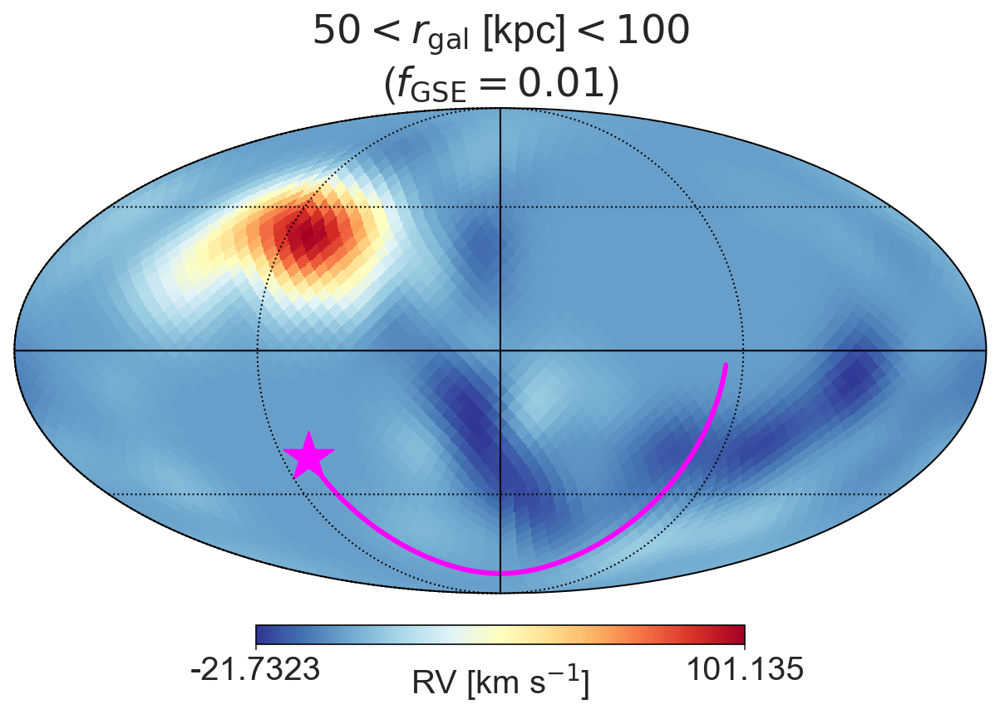

In [497]:
#produce_map_gal(ge_500, )


mask = (ge_500['R_gal']>50) & (ge_500['R_gal']<100) 
#m = produce_map_gal(ge_500['l_gal_rad'][mask], ge_500['b_gal_rad'][mask])
#m = produce_map(ge_500, mask)
m = produce_quantity_map(ge_500, mask, "Vrad")

hp.mollview(hp.smoothing(m, fwhm=np.radians(20.)), 
            title=r"$50<r_{\rm{gal}}$ [kpc]$<100$""\n"r"($f_{\rm{GSE}}=%.2f$)"%np.mean(mask), 
            cmap="RdYlBu_r", flip="geo", unit="\n"r"RV [km s$^{-1}$]")

fontsize=20
matplotlib.rcParams.update({'font.size':fontsize})

f = matplotlib.pyplot.gcf().get_children()
HpxAx = f[1]
CbAx = f[2]

coord_text_obj = HpxAx.get_children()[0]
coord_text_obj.set_fontsize(fontsize)

unit_text_obj = CbAx.get_children()[1]
unit_text_obj.set_fontsize(fontsize)


#hp.projplot(com_l_deg, com_b_deg, lonlat=True, c="silver", ls="-", lw=3)

hp.projscatter(lmc_l_deg[0], lmc_b_deg[0], lonlat=True, c="fuchsia", marker="*", s=1000)
hp.projplot(lmc_l_deg, lmc_b_deg, lonlat=True, c="fuchsia", ls="-", lw=3)


hp.graticule(dpar=45, dmer=90)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/HP_0010.pdf", dpi=300, bbox_inches = "tight")

Text(-1150, 95, 'Z [kpc]')

/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  fig.canvas.print_figure(bytes_io, **kw)


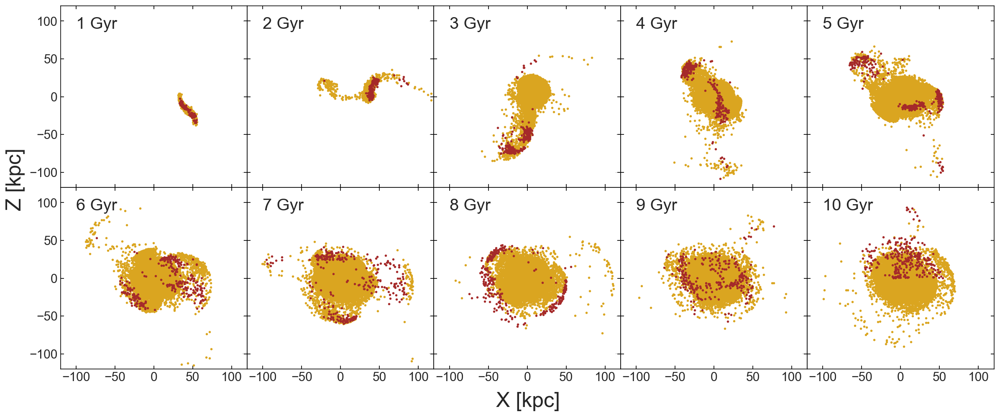

In [502]:
plt.subplots(2, 5, figsize=(20, 8))

counter = 1
for idx in (np.linspace(0, 500, 11)+1)[1::].astype(int):
    plt.subplot(2, 5, counter)
    
    mask = (ge_500['R_gal']>50) & (ge_500['R_gal']<100) & (ge_500['b_deg']>0) & (ge_500['l_deg']<0)
    
    plt.scatter(ge_500['X_gal_%s'%idx][~mask],
                ge_500['Z_gal_%s'%idx][~mask], s=3, c="goldenrod",
               rasterized=True)
    plt.scatter(ge_500['X_gal_%s'%idx][mask], 
                ge_500['Z_gal_%s'%idx][mask], s=3, c="brown", alpha=1,
               rasterized=True)
    plt.xlim(-120, 120)
    plt.ylim(-120, 120)
    plt.minorticks_off()
    
    plt.locator_params(axis='x',nbins=6)
    plt.locator_params(axis='y',nbins=6)

    
    if counter>5:
        plt.tick_params(axis='x', labelsize=15, length=4, width=1,top="off", direction="in")
    else:
        plt.tick_params(axis='x', labelsize=0, length=4, width=1,top="off", direction="in")
        
    if (counter==1)|(counter==6):
        plt.tick_params(axis='y', labelsize=15, length=4, width=1,right="off", direction="in")
    else:
        plt.tick_params(axis='y', labelsize=0, length=4, width=1,right="off", direction="in")
    
    plt.text(-100, 90, "%i Gyr"%(counter), fontsize=20)
    
    counter = counter+1
    
plt.subplots_adjust(wspace=0, hspace=0)
plt.text(-520, -170, "X [kpc]", fontsize=25)
plt.text(-1150, 95, "Z [kpc]", fontsize=25, rotation="90")
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Sim_Pics_pt2.pdf", bbox_inches='tight', dpi=300)

In [492]:
mask = (ge_500['R_gal']>50) & (ge_500['R_gal']<100) & (ge_500['b_deg']>0) & (ge_500['l_deg']<0)

In [496]:
np.median(ge_500[mask]['R_com_0'])/(1.75*1.5)

3.2041033790225075

In [490]:
np.mean((ge_500['Vrad'][mask]))

70.55613758481199

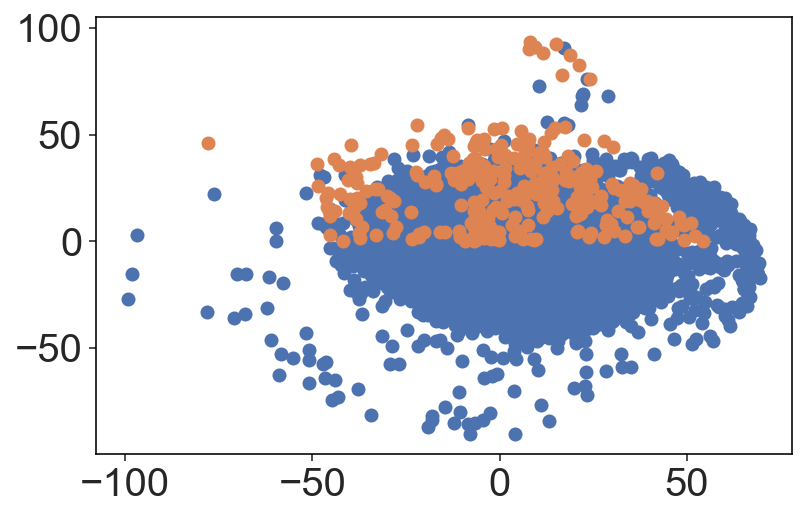

In [480]:
plt.scatter(ge_500['X_gal_501'][~mask], ge_500['Z_gal_501'][~mask])
plt.scatter(ge_500['X_gal_501'][mask], ge_500['Z_gal_501'][mask])

# Orbits

In [46]:
def track_com_3d(ge):
    
    com_init = np.array([np.mean(ge['X_gal_1']), np.mean(ge['Y_gal_1']), np.mean(ge['Z_gal_1'])])
    com_dist = np.linalg.norm(np.array([ge['X_gal_1'], ge['Y_gal_1'], ge['Z_gal_1']]).T - com_init,
                      axis=1)
    bound_stars = (com_dist < np.percentile(com_dist, 5))
    
    com_x = []
    com_y = []
    com_z = []

    for indx in range(501):
        try:
            com_x.append(np.mean(ge['X_gal_%s'%(indx+1)][bound_stars]))
            com_y.append(np.mean(ge['Y_gal_%s'%(indx+1)][bound_stars]))
            com_z.append(np.mean(ge['Z_gal_%s'%(indx+1)][bound_stars]))
        except:
            break
    
    return np.array(com_x), np.array(com_y), np.array(com_z)

In [47]:
time = np.arange(500)/50
ge_x, ge_y, ge_z = track_com_3d(ge_165)

In [48]:
import scipy
from scipy.signal import find_peaks

peaks, _ = find_peaks(ge_165['com'][0:500])
troughs,_ = find_peaks(-ge_165['com'][0:500])

In [49]:
print("apo",(np.arange(500)/50)[peaks[0:3]]) 
print("peri", (np.arange(500)/50)[troughs[0:3]])

apo [1.44 2.48 2.92]
peri [0.78 2.24 2.76]


In [50]:
-ge_x[peaks[0:3]], ge_y[peaks[0:3]], ge_z[peaks[0:3]]

(array([-66.644226 ,   6.1979446,  -4.5519485], dtype=float32),
 array([-30.745506,  19.709854, -11.531832], dtype=float32),
 array([ 14.472447, -18.820374,   9.280062], dtype=float32))

In [51]:
(6**2 + 20**2 + 19**2)**0.5, (4**2 + 11**2 + 9**2)**0.5

(28.231188426986208, 14.7648230602334)

In [52]:
(14**2 + 20**2 + 19**2)**0.5, (3.5**2 + 11**2 + 9**2)**0.5

(30.93541659651604, 14.637281168304447)

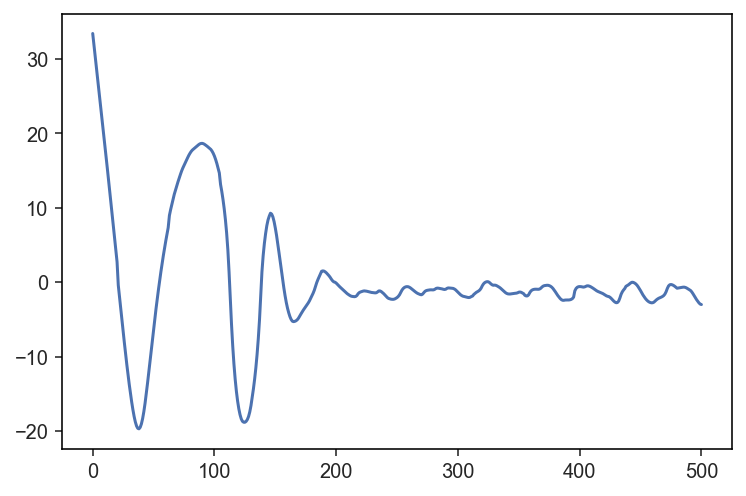

In [68]:
plt.plot(ge_z)

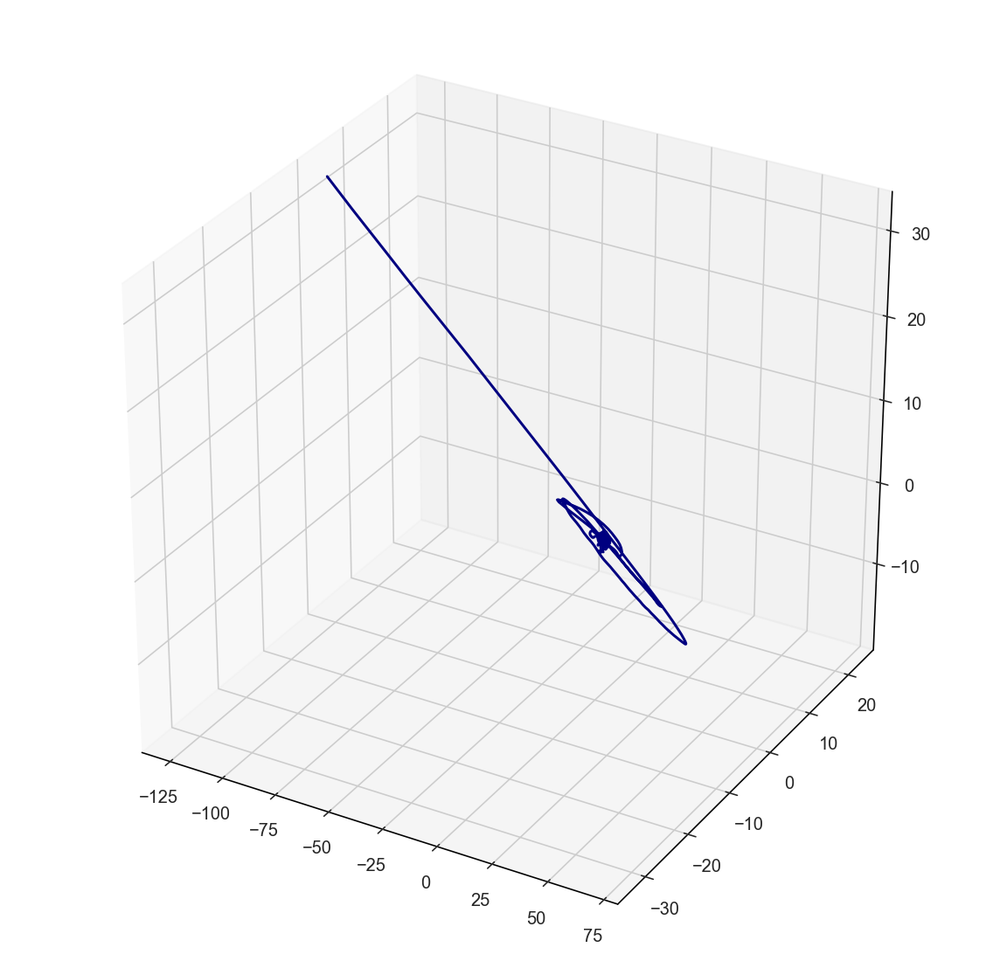

In [75]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure(figsize=(10., 10.))
color = "dodgerblue"
ax = fig.add_subplot(111, projection='3d')
ax.plot3D(ge_x,ge_y,ge_z, c="navy")
#ax.set_zlim(-30, 30)
#ax.set_xlim(-30, 30)
#ax.set_ylim(-30, 30)
#ax.plot_wireframe(ge_x, ge_y, ge_z,  rstride=4, cstride=4, color=color, alpha=0.2)

In [ ]:
(5, 20, -20)
(-5, -10, 10)

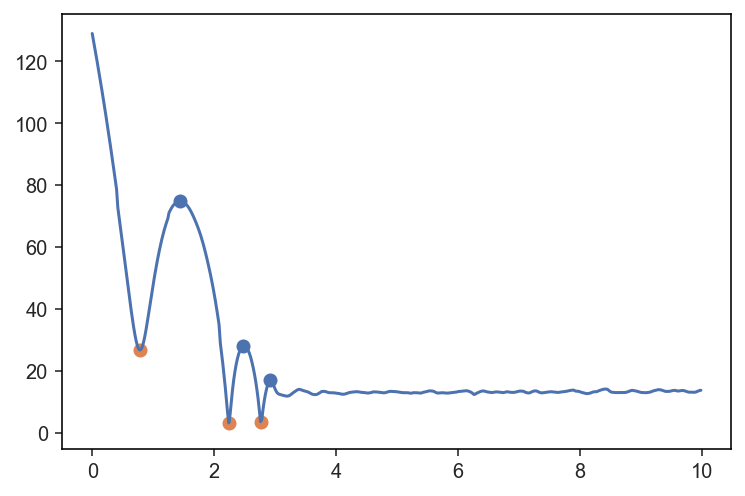

In [19]:
plt.plot(np.arange(500)/50, ge_165['com'][0:500])

plt.scatter( (np.arange(500)/50)[peaks[0:3]], (ge_165['com'][0:500])[peaks[0:3]] )

plt.scatter( (np.arange(500)/50)[troughs[0:3]], (ge_165['com'][0:500])[troughs[0:3]] )

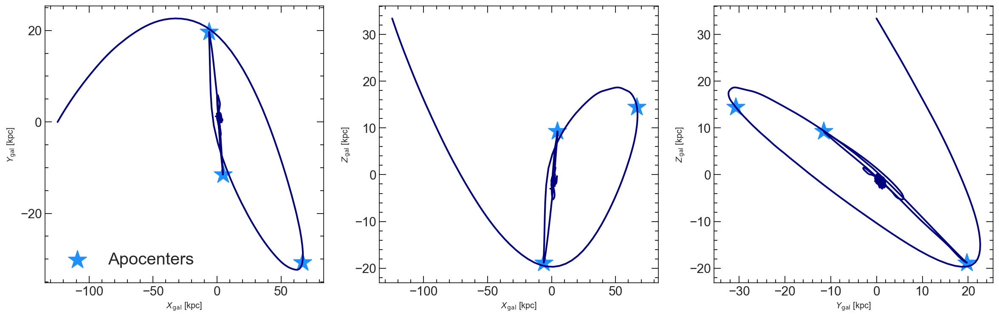

In [74]:
plt.subplots(1,3,figsize=(20, 6))
plt.subplot(131)
plt.plot(ge_x, ge_y, zorder=0, c="Navy", lw=2)


plt.scatter(ge_x[peaks[0:3]], ge_y[peaks[0:3]], c="dodgerblue", 
           marker="*", s=500, zorder=0, label="Apocenters")

#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

#plt.xlim(-70, 70)
#plt.ylim(-70, 70)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc]")
plt.ylabel(r"$Y_{\rm{gal}}$ [kpc]")
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

plt.legend(fontsize=20, frameon=False)

plt.subplot(132)
plt.plot(ge_x, ge_z, zorder=0, c="Navy", lw=2)

plt.scatter(ge_x[peaks[0:3]], ge_z[peaks[0:3]], c="dodgerblue", 
           marker="*", s=500, zorder=0)

#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

#plt.xlim(-70, 70)
#plt.ylim(-70, 70)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc]")
plt.ylabel(r"$Z_{\rm{gal}}$ [kpc]")

plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(133)
plt.plot(ge_y, ge_z, zorder=0, c="Navy", lw=2)

plt.scatter(ge_y[peaks[0:3]], ge_z[peaks[0:3]], c="dodgerblue", 
           marker="*", s=500, zorder=0)

plt.xlabel(r"$Y_{\rm{gal}}$ [kpc]")
plt.ylabel(r"$Z_{\rm{gal}}$ [kpc]")


#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

#plt.xlim(-70, 70)
#plt.ylim(-70, 70)

plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Orbit.pdf", bbox_inches='tight', dpi=300)

ValueError: x and y must have same first dimension, but have shapes (500,) and (3, 500)

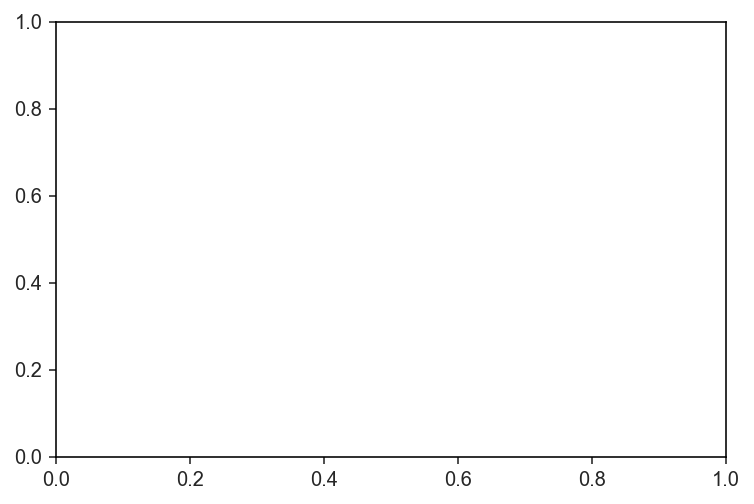

In [21]:
def track_lz(ge):

    lz_median = []
    lz_84 = []
    lz_16 = []
    for idx in (np.arange(500)+1).astype(int):
        try:
            w = gd.PhaseSpacePosition(pos=[-ge['X_gal_%s'%idx], ge['Y_gal_%s'%idx], ge['Z_gal_%s'%idx]]*u.kpc, 
                          vel=[-ge['Vx_gal_%s'%idx], ge['Vy_gal_%s'%idx], ge['Z_gal_%s'%idx]]*u.km/u.s )
            lz_med,lz_plus,lz_minus = medianize(w.angular_momentum()[2].value/1e+3)
            
            lz_median.append(lz_med)
            lz_84.append(lz_plus)
            lz_16.append(lz_minus)
    
        except:
            break
        
    lz_median = np.array(lz_median)
    lz_84 = np.array(lz_84)
    lz_16 = np.array(lz_16)
    
    return lz_median, lz_84, lz_16

plt.plot(np.arange(500)/50, track_lz(ge_165))

In [5]:
inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_165.pickle", "rb"))
ge_165 = read_file(hstack(inp), 501)

ge_x, ge_y, ge_z = track_com_3d(ge_165)

In [27]:
pickle.dump(ge_165[list(ge_165.columns[0:-48])], open("/Users/rohannaidu/Dropbox/GE_stars_fullsequence.pickle","wb"))

In [23]:
ge_x[peaks[0:3]], ge_y[peaks[0:3]]

(array([66.644226 , -6.1979446,  4.5519485], dtype=float32),
 array([-30.745506,  19.709854, -11.531832], dtype=float32))

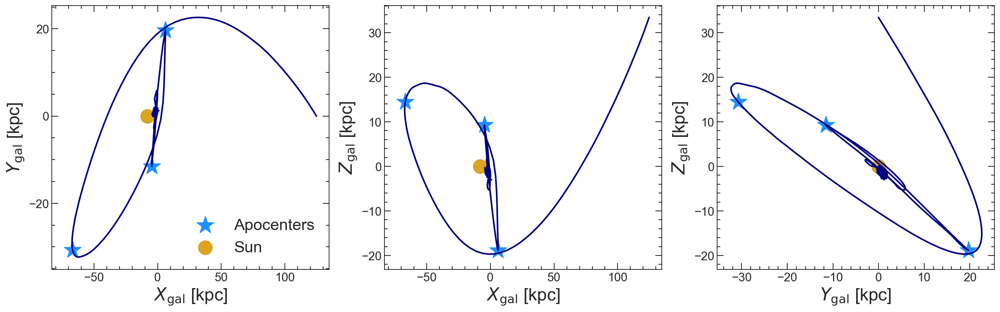

In [359]:
peaks, _ = find_peaks(ge_165['com'][0:501])
troughs,_ = find_peaks(-ge_165['com'][0:501])

plt.subplots(1,3,figsize=(21.2, 6.1))
plt.subplot(131)
plt.plot(-ge_x, ge_y, zorder=0, c="Navy", lw=2)

plt.scatter(-ge_x[peaks[0:3]], ge_y[peaks[0:3]], c="dodgerblue", 
           marker="*", s=500, zorder=0, label="Apocenters")

plt.scatter(-8.122, 0, s=300, c="goldenrod", label="Sun", zorder=0, alpha=1)

#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

#plt.xlim(-70, 70)
#plt.ylim(-70, 70)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$ [kpc]", fontsize=22)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

plt.legend(fontsize=20, frameon=False)

plt.subplot(132)
plt.plot(-ge_x, ge_z, zorder=0, c="Navy", lw=2)
plt.scatter(-8.122, 20.8/1000,  s=300, c="goldenrod", label="Sun",  zorder=0)

plt.scatter(-ge_x[peaks[0:3]], ge_z[peaks[0:3]], c="dodgerblue", 
           marker="*", s=500, zorder=0)

#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

#plt.xlim(-70, 70)
#plt.ylim(-70, 70)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc]",fontsize=22)
plt.ylabel(r"$Z_{\rm{gal}}$ [kpc]",fontsize=22)

plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(133)
plt.plot(ge_y, ge_z, zorder=0, c="Navy", lw=2)
plt.scatter(0, 20.8/1000,  s=300, c="goldenrod", label="Sun", zorder=0)

plt.scatter(ge_y[peaks[0:3]], ge_z[peaks[0:3]], c="dodgerblue", 
           marker="*", s=500, zorder=0)

plt.xlabel(r"$Y_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$Z_{\rm{gal}}$ [kpc]", fontsize=22)


#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

#plt.xlim(-70, 70)
#plt.ylim(-70, 70)

plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Orbitv2.pdf", bbox_inches='tight', dpi=300)

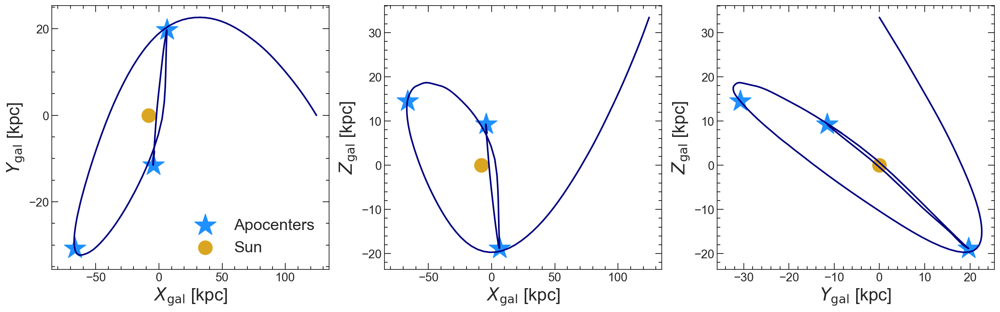

In [368]:
peaks, _ = find_peaks(ge_165['com'][0:501])
troughs,_ = find_peaks(-ge_165['com'][0:501])
t_end = 151

plt.subplots(1,3,figsize=(21.2, 6.1))
plt.subplot(131)
plt.plot(-ge_x[0:t_end], ge_y[0:t_end], zorder=0, c="Navy", lw=2)

plt.scatter(-ge_x[peaks[0:3]], ge_y[peaks[0:3]], c="dodgerblue", 
           marker="*", s=800, zorder=0, label="Apocenters")

plt.scatter(-8.122, 0, s=300, c="goldenrod", label="Sun", zorder=0, alpha=1)

#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

#plt.xlim(-70, 70)
#plt.ylim(-70, 70)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$ [kpc]", fontsize=22)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

plt.legend(fontsize=20, frameon=False)

plt.subplot(132)
plt.plot(-ge_x[0:t_end], ge_z[0:t_end], zorder=0, c="Navy", lw=2)
plt.scatter(-8.122, 20.8/1000,  s=300, c="goldenrod", label="Sun",  zorder=0)

plt.scatter(-ge_x[peaks[0:3]], ge_z[peaks[0:3]], c="dodgerblue", 
           marker="*", s=800, zorder=0)

#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

#plt.xlim(-70, 70)
#plt.ylim(-70, 70)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc]",fontsize=22)
plt.ylabel(r"$Z_{\rm{gal}}$ [kpc]",fontsize=22)

plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(133)
plt.plot(ge_y[0:t_end], ge_z[0:t_end], zorder=0, c="Navy", lw=2)
plt.scatter(0, 20.8/1000,  s=300, c="goldenrod", label="Sun", zorder=0)

plt.scatter(ge_y[peaks[0:3]], ge_z[peaks[0:3]], c="dodgerblue", 
           marker="*", s=800, zorder=0)

plt.xlabel(r"$Y_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$Z_{\rm{gal}}$ [kpc]", fontsize=22)

plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Orbitv2.pdf", bbox_inches='tight', dpi=300)

In [326]:
coord.Galactocentric()

<Galactocentric Frame (galcen_coord=<ICRS Coordinate: (ra, dec) in deg
    (266.4051, -28.936175)>, galcen_distance=8.122 kpc, galcen_v_sun=(12.9, 245.6, 7.78) km / s, z_sun=20.8 pc, roll=0.0 deg)>

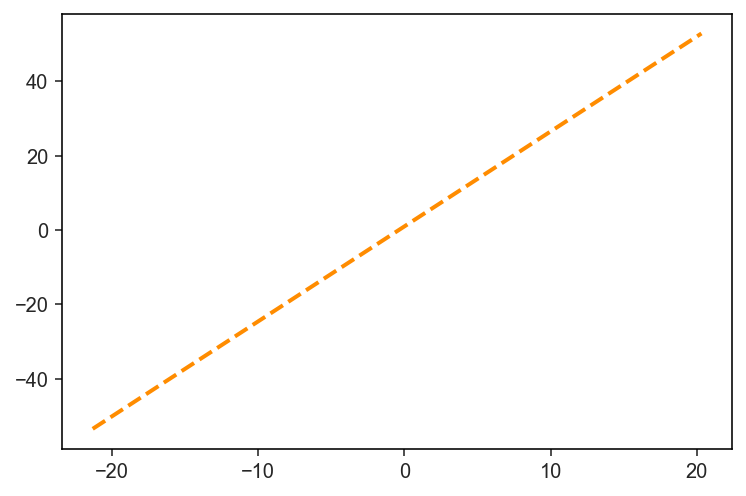

In [26]:
plt.plot(np.array([-21.324, 20.313]), np.array([-53.523, 52.829]), lw=2, ls="--", 
        label= "Iorio & Belokurov, 2018", c="darkorange", zorder=0)

# LMC connection

In [1416]:
inp = pickle.load(open("./snaps/GEM1UMresize_disk_129_129_50_pro_150.pickle", "rb"))
ge = hstack(inp)

ge_10 = read_file(ge, 500)

In [39]:
inp = pickle.load(open("./snaps/GEM1UMresize_disk_129_129_50_pro_150.pickle", "rb"))
ge = hstack(inp)

ge_500 = read_file(ge, 500)

In [1388]:
test_rgal = ((ge['X_gal_500']**2 + ge['Y_gal_500']**2 + ge['Z_gal_500']**2)**0.5)
np.count_nonzero( (test_rgal>50)  & (test_rgal<100))

601

In [1385]:
np.count_nonzero((ge_500['R_gal']>50) & (ge_500['R_gal']<100) )

480

In [1386]:
np.count_nonzero((ge_10['R_gal']>50) & (ge_10['R_gal']<100) )

526

In [194]:
import healpy as hp

Sigma is 254.796540 arcmin (0.074117 rad) 
-> fwhm is 600.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


NameError: name 'lmc_l_deg' is not defined

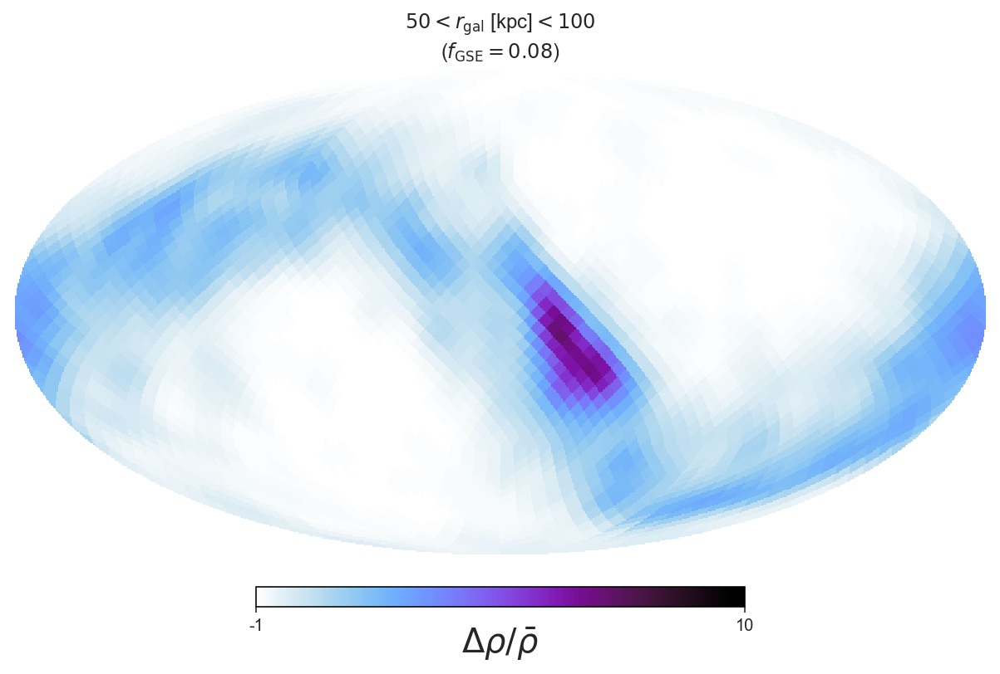

In [195]:
#produce_map_gal(ge_500, )


mask = (ge_165['R_gal']>30) & (ge_165['R_gal']<50) 

m = produce_map(ge_165, mask)

hp.mollview(hp.smoothing(m/np.mean(m) - 1, fwhm=np.radians(10.)), 
            title=r"$50<r_{\rm{gal}}$ [kpc]$<100$""\n"r"($f_{\rm{GSE}}=%.2f$)"%np.mean(mask), 
            cmap="cmr.voltage_r", flip="geo", unit="\n"r"$\Delta\rho/\bar{\rho}$",
           min=-1, max=10)

fontsize=20
matplotlib.rcParams.update({'font.size':fontsize})

f = matplotlib.pyplot.gcf().get_children()
HpxAx = f[1]
CbAx = f[2]

coord_text_obj = HpxAx.get_children()[0]
coord_text_obj.set_fontsize(fontsize)

unit_text_obj = CbAx.get_children()[1]
unit_text_obj.set_fontsize(fontsize)


#hp.projplot(com_l_deg, com_b_deg, lonlat=True, c="silver", ls="-", lw=3)

hp.projscatter(lmc_l_deg[0], lmc_b_deg[0], lonlat=True, c="hotpink", marker="*", s=1000)
hp.projplot(lmc_l_deg, lmc_b_deg, lonlat=True, c="hotpink", ls="-", lw=3)


hp.graticule(dpar=45, dmer=90)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/HP_0010.pdf", dpi=300, bbox_inches = "tight")

Sigma is 509.593080 arcmin (0.148235 rad) 
-> fwhm is 1200.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:306: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1451: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1429: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/healpy/visufunc.py:1389: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pylab.draw()


0.0 180.0 -180.0 180.0
The interval between parallels is 45 deg 0.00'.
The interval between meridians is 90 deg 0.00'.


/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


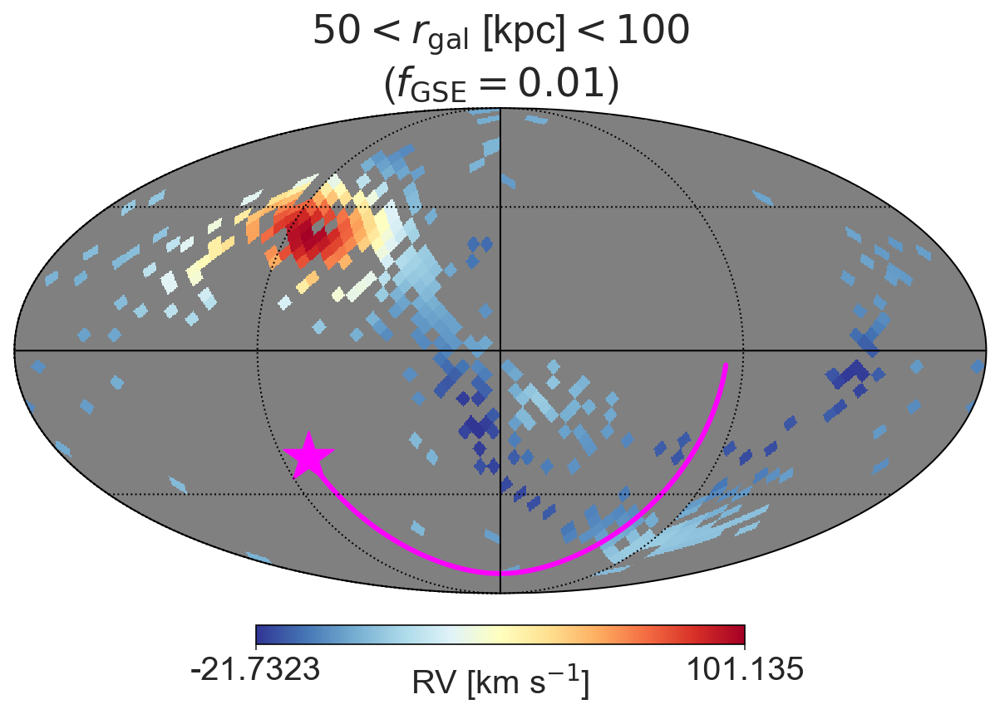

In [1364]:
#produce_map_gal(ge_500, )


mask = (ge_500['R_gal']>50) & (ge_500['R_gal']<100) 
#m = produce_map_gal(ge_500['l_gal_rad'][mask], ge_500['b_gal_rad'][mask])
#m = produce_map(ge_500, mask)
m = produce_quantity_map(ge_500, mask, "Vrad")

hp.mollview(hp.smoothing(m, fwhm=np.radians(20.)), 
            title=r"$50<r_{\rm{gal}}$ [kpc]$<100$""\n"r"($f_{\rm{GSE}}=%.2f$)"%np.mean(mask), 
            cmap="RdYlBu_r", flip="geo", unit="\n"r"RV [km s$^{-1}$]")

fontsize=20
matplotlib.rcParams.update({'font.size':fontsize})

f = matplotlib.pyplot.gcf().get_children()
HpxAx = f[1]
CbAx = f[2]

coord_text_obj = HpxAx.get_children()[0]
coord_text_obj.set_fontsize(fontsize)

unit_text_obj = CbAx.get_children()[1]
unit_text_obj.set_fontsize(fontsize)


#hp.projplot(com_l_deg, com_b_deg, lonlat=True, c="silver", ls="-", lw=3)

hp.projscatter(lmc_l_deg[0], lmc_b_deg[0], lonlat=True, c="fuchsia", marker="*", s=1000)
hp.projplot(lmc_l_deg, lmc_b_deg, lonlat=True, c="fuchsia", ls="-", lw=3)


hp.graticule(dpar=45, dmer=90)
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/HP_0010.pdf", dpi=300, bbox_inches = "tight")

In [1414]:
np.count_nonzero(ge_500['Z_gal_501']>50)

28

In [1418]:
np.count_nonzero(ge_10['R_gal']>50)

628

In [1419]:
np.count_nonzero(ge_500['R_gal']>50)

520

In [1422]:
np.mean(ge_10['R_com_0'][ (ge_10['Lz_noisy']>2) & (ge_10['h3_mask']) & (ge_10['dist_adpt']>3) ])/(1.67*1.5)

2.632036037787706

In [1423]:
np.mean(ge_10['R_com_0'][ (np.abs(ge_10['Lz_noisy'])<0.5) & (ge_10['h3_mask']) & (ge_10['dist_adpt']>3) ])/(1.67*1.5)

1.137981110228274

In [1425]:
ge_enhanced = ge_500

arr = (ge_enhanced['R_com_0'][(np.abs(ge_enhanced['Lz_noisy'])<0.5) & (ge['h3_mask'])]/(1.7*1.55))[0:-1:3]

medianize(bootstrap(arr, bootnum=100, bootfunc=np.mean))

(1.06, 0.010000000000000009, -0.020000000000000018)

In [1426]:
ge_enhanced = ge_10

arr = (ge_enhanced['R_com_0'][(np.abs(ge_enhanced['Lz_noisy'])<0.5) & (ge['h3_mask'])]/(1.7*1.55))[0:-1:3]

medianize(bootstrap(arr, bootnum=100, bootfunc=np.mean))

(1.08, 0.010000000000000009, -0.010000000000000009)

In [1430]:
np.mean(ge_500['Z_gal_501']>0)

0.3534358769476628

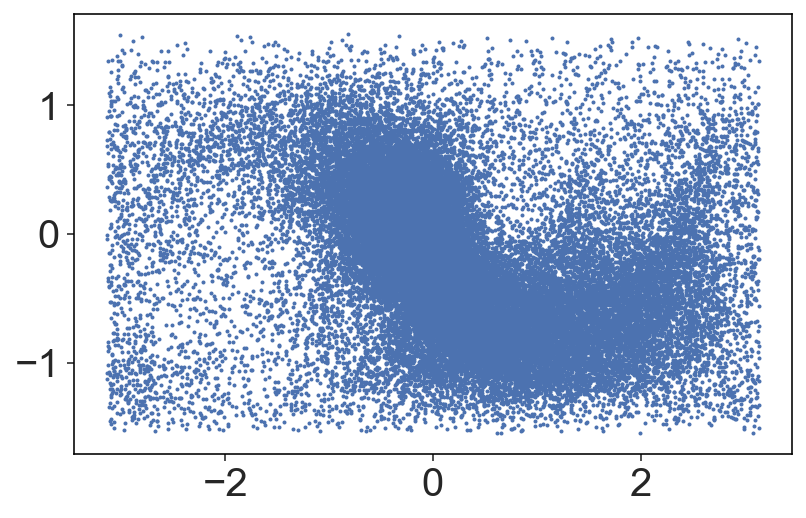

In [1433]:
plt.scatter(ge_500['l_rad'], ge_500['b_rad'], s=1)

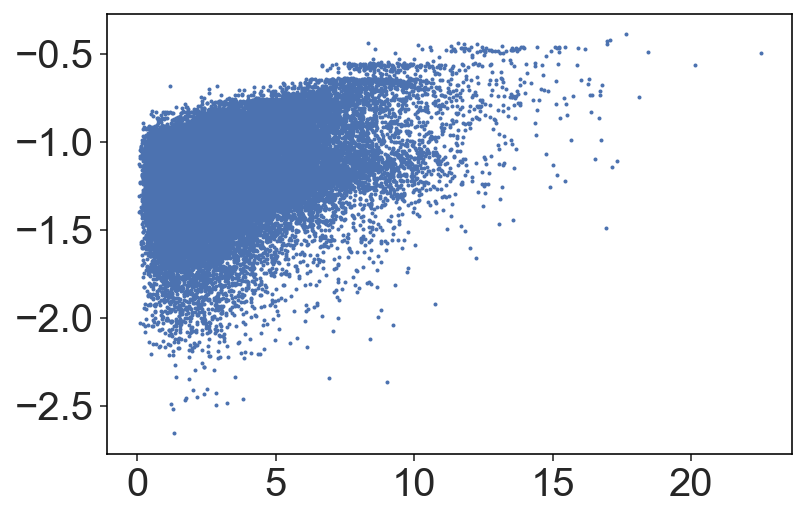

In [1435]:
plt.scatter(ge_500['R_com_0'], ge_500['E_tot_pot1'], s=1)

# HAC and VOD

In [116]:
coord.Galactocentric(x=10*u.kpc, y=10*u.kpc, z=-20*u.kpc).transform_to(coord.Galactic)

<Galactic Coordinate: (l, b, distance) in (deg, deg, kpc)
    (28.82230472, -43.91883703, 28.79649894)>

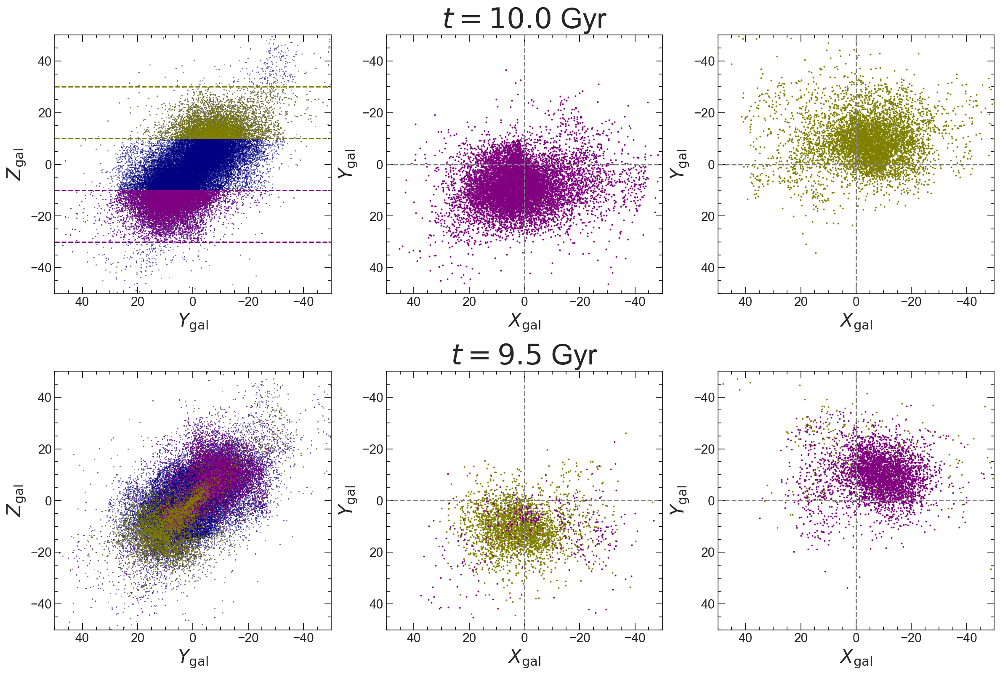

In [212]:
hac_col = "purple"
vod_col = "olive"
basic_col = "navy"


plt.subplots(2,3, figsize=(20,13))


plt.subplot(2,3,1)

plt.scatter(ge_165['Y_gal_501'], ge_165['Z_gal_501'], s=0.1, c=basic_col,
           rasterized=True)

hac_mask =  (ge_165['Z_gal_501']<-10) & (ge_165['Z_gal_501']>-30)
plt.scatter(ge_165['Y_gal_501'][hac_mask], ge_165['Z_gal_501'][hac_mask],
            s=0.1, c=hac_col, rasterized=True)

vod_mask =  (ge_165['Z_gal_501']<30) & (ge_165['Z_gal_501']>10)
plt.scatter(ge_165['Y_gal_501'][vod_mask], ge_165['Z_gal_501'][vod_mask],
            s=0.1, c=vod_col, rasterized=True)
plt.xlim(50, -50)
plt.ylim(-50, 50)

plt.axhline(10, ls="--", c=vod_col)
plt.axhline(30, ls="--", c=vod_col)

plt.axhline(-10, ls="--", c=hac_col)
plt.axhline(-30, ls="--",c=hac_col)

plt.xlabel(r"$Y_{\rm{gal}}$", fontsize=22)
plt.ylabel(r"$Z_{\rm{gal}}$", fontsize=22)
plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.minorticks_on()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")



plt.subplot(2,3,2)
plt.title("$t=10.0$ Gyr", fontsize=34)
plane_mask =  (ge_165['Z_gal_501']<-10) & (ge_165['Z_gal_501']>-30)

plt.scatter(ge_165['X_gal_501'][plane_mask], ge_165['Y_gal_501'][plane_mask], s=1,
           c=hac_col, rasterized=True)
plt.xlim(50, -50)
plt.ylim(50, -50)

plt.xlabel(r"$X_{\rm{gal}}$", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$", fontsize=22)
#plt.title(r"$-30<Z_{\rm{gal}}<-10$", fontsize=22, pad=15)
plt.axhline(0,ls="--", c="gray")
plt.axvline(0,ls="--", c="gray")
plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.minorticks_on()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(2,3,3)

plane_mask =  (ge_165['Z_gal_501']>10) & (ge_165['Z_gal_501']<30)

plt.scatter(ge_165['X_gal_501'][plane_mask], ge_165['Y_gal_501'][plane_mask], s=1,
           c=vod_col, rasterized=True)
plt.xlim(50, -50)
plt.ylim(50, -50)

plt.xlabel(r"$X_{\rm{gal}}$", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$", fontsize=22)
#plt.title(r"$10<Z_{\rm{gal}}<30$", fontsize=22, pad=15)
plt.axhline(0,ls="--", c="gray")
plt.axvline(0,ls="--", c="gray")
plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.minorticks_on()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

################################################################

plt.subplot(2,3,4)

plt.scatter(ge_165['Y_gal_480'], ge_165['Z_gal_480'], s=0.1, c=basic_col,
           rasterized=True)

hac_mask =  (ge_165['Z_gal_501']<-10) & (ge_165['Z_gal_501']>-30)
plt.scatter(ge_165['Y_gal_480'][hac_mask], ge_165['Z_gal_480'][hac_mask],
            s=0.1, c=hac_col, rasterized=True)

vod_mask =  (ge_165['Z_gal_501']<30) & (ge_165['Z_gal_501']>10)
plt.scatter(ge_165['Y_gal_480'][vod_mask], ge_165['Z_gal_480'][vod_mask],
            s=0.1, c=vod_col,rasterized=True)
plt.xlim(50, -50)
plt.ylim(-50, 50)

plt.xlabel(r"$Y_{\rm{gal}}$", fontsize=22)
plt.ylabel(r"$Z_{\rm{gal}}$", fontsize=22)
plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.minorticks_on()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")



plt.subplot(2,3,5)

plt.title("$t=9.5$ Gyr", fontsize=34)

master_plane_mask = (ge_165['Z_gal_480']>-30) & (ge_165['Z_gal_480']<-10)
plane_mask_1 =  (ge_165['Z_gal_501']>10) & (ge_165['Z_gal_501']<30) & (master_plane_mask)
plane_mask_2 =  (ge_165['Z_gal_501']<-10) & (ge_165['Z_gal_501']>-30) & (master_plane_mask)


plt.scatter(-ge_165['X_gal_480'][plane_mask_1], ge_165['Y_gal_480'][plane_mask_1], s=1,
           c=vod_col, rasterized=True)
plt.scatter(-ge_165['X_gal_480'][plane_mask_2], ge_165['Y_gal_480'][plane_mask_2], s=1,
           c=hac_col, rasterized=True)


plt.xlim(50, -50)
plt.ylim(50, -50)

plt.xlabel(r"$X_{\rm{gal}}$", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$", fontsize=22)
#plt.title(r"$-30<Z_{\rm{gal}}<-10$", fontsize=22, pad=15)
plt.axhline(0,ls="--", c="gray")
plt.axvline(0,ls="--", c="gray")
plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.minorticks_on()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(2,3,6)

master_plane_mask = (ge_165['Z_gal_480']>10) & (ge_165['Z_gal_480']<30)
plane_mask_1 =  (ge_165['Z_gal_501']>10) & (ge_165['Z_gal_501']<30) & (master_plane_mask)
plane_mask_2 =  (ge_165['Z_gal_501']<-10) & (ge_165['Z_gal_501']>-30) & (master_plane_mask)


plt.scatter(-ge_165['X_gal_480'][plane_mask_1], ge_165['Y_gal_480'][plane_mask_1], s=1,
           c=vod_col, rasterized=True)
plt.scatter(-ge_165['X_gal_480'][plane_mask_2], ge_165['Y_gal_480'][plane_mask_2], s=1,
           c=hac_col, rasterized=True)



plt.xlim(50, -50)
plt.ylim(50, -50)

plt.xlabel(r"$X_{\rm{gal}}$", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$", fontsize=22)
plt.axhline(0,ls="--", c="gray")
plt.axvline(0,ls="--", c="gray")
plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.minorticks_on()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

plt.subplots_adjust(hspace=0.3)

plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/HAC_VOD_500Myr.pdf", 
            bbox_inches="tight", dpi=300)

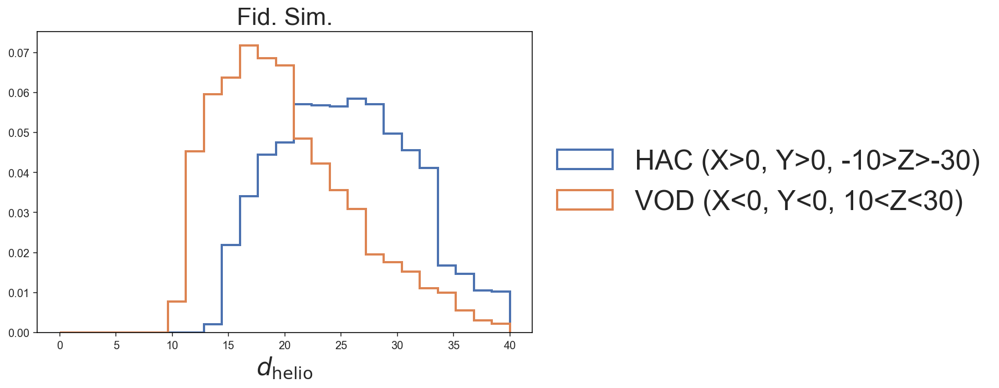

In [698]:
plt.figure(figsize=(8, 5))
plt.hist(ge_165['dist_adpt'][ (ge_165['Z_gal']<-10) & (ge_165['Z_gal']>-30) \
                             & (ge_165['X_gal']>0) & (ge_165['Y_gal']>0)\
                            & (ge_165['dist_adpt']<50)], 
         histtype="step", lw=2, range=(0,40), bins=25,
        label="HAC (X>0, Y>0, -10>Z>-30)", density=True)


plt.hist(ge_165['dist_adpt'][ (ge_165['Z_gal']>10) & (ge_165['Z_gal']<30) \
                             & (ge_165['X_gal']<0) & (ge_165['Y_gal']<0)\
                            & (ge_165['dist_adpt']<50)], 
         histtype="step", lw=2, range=(0,40), bins=25,
         label="VOD (X<0, Y<0, 10<Z<30)", density=True)
#plt.legend(fontsize=22, loc=3)
plt.title("Fid. Sim.", fontsize=22)
plt.xlabel(r"$d_{\rm{helio}}$", fontsize=22)
plt.legend(fontsize=25, loc="center left", markerscale=5, frameon=False, 
          bbox_to_anchor=(1, 0.5))

In [707]:
hac_mask = (ge_165['Z_gal']<-10) & (ge_165['Z_gal']>-30) \
                             & (ge_165['X_gal']>0) & (ge_165['Y_gal']>0)

vod_mask = (ge_165['Z_gal']>10) & (ge_165['Z_gal']<30) \
                             & (ge_165['X_gal']<0) & (ge_165['Y_gal']<0)

np.count_nonzero(hac_mask), np.count_nonzero(vod_mask)

(5792, 3589)

In [710]:
np.mean(ge_165['Z_gal']<0), np.mean(ge_165['Z_gal']>0)

(0.5861566120655214, 0.4138433879344786)

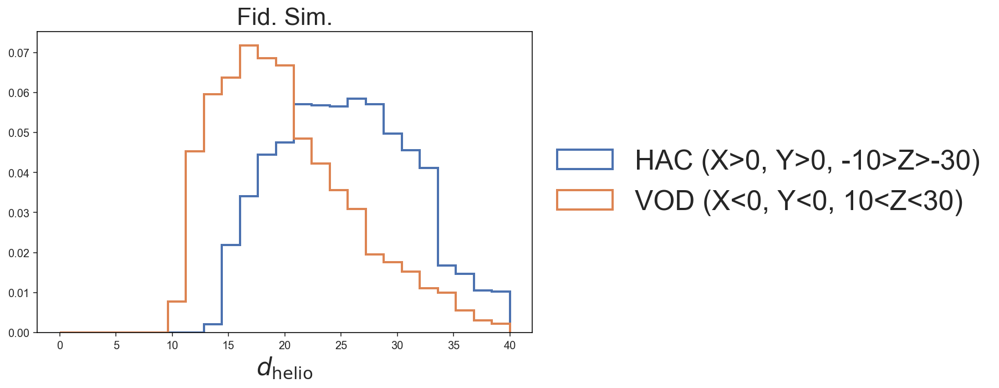

In [705]:
plt.figure(figsize=(8, 5))
plt.hist(ge_165['dist_adpt'][ (ge_165['Z_gal']<-10) & (ge_165['Z_gal']>-30) \
                             & (ge_165['X_gal']>0) & (ge_165['Y_gal']>0)\
                            & (ge_165['dist_adpt']<50)], 
         histtype="step", lw=2, range=(0,40), bins=25,
        label="HAC (X>0, Y>0, -10>Z>-30)", density=True)


plt.hist(ge_165['dist_adpt'][ (ge_165['Z_gal']>10) & (ge_165['Z_gal']<30) \
                             & (ge_165['X_gal']<0) & (ge_165['Y_gal']<0)\
                            & (ge_165['dist_adpt']<50)], 
         histtype="step", lw=2, range=(0,40), bins=25,
         label="VOD (X<0, Y<0, 10<Z<30)", density=True)
#plt.legend(fontsize=22, loc=3)
plt.title("Fid. Sim.", fontsize=22)
plt.xlabel(r"$d_{\rm{helio}}$", fontsize=22)
plt.legend(fontsize=25, loc="center left", markerscale=5, frameon=False, 
          bbox_to_anchor=(1, 0.5))

# PMs

In [56]:
import gala

In [436]:
inpv2 = pickle.load(open("./snaps/GE_disk_129_129_50_pro_165.pickle", "rb"))
ge_inpv2 = hstack(inpv2)
ge_165 = read_file(ge_inpv2, 501)

FileNotFoundError: [Errno 2] No such file or directory: './snaps/GE_disk_129_129_50_pro_165.pickle'

In [61]:
ge_galacto = coord.Galactocentric(x=ge_165['X_gal_501']*u.kpc,
                     y=ge_165['Y_gal_501']*u.kpc,
                     z=ge_165['Z_gal_501']*u.kpc,
                     v_x=ge_165['Vx_gal_501']*u.km/u.s,
                     v_y=ge_165['Vy_gal_501']*u.km/u.s,
                     v_z=ge_165['Vz_gal_501']*u.km/u.s)

#ge_galacto.tranform_to(coord.ICRS)
ge_165['pmra_corr'] = gala.coordinates.reflex_correct(ge_galacto.transform_to(coord.ICRS)).pm_ra_cosdec
ge_165['pmdec_corr'] = gala.coordinates.reflex_correct(ge_galacto.transform_to(coord.ICRS)).pm_dec

373


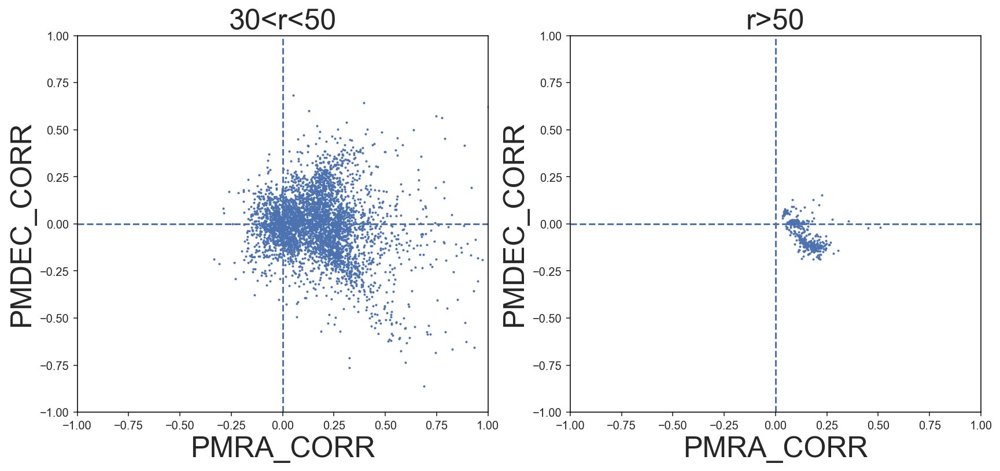

In [100]:
plt.subplots(1,2, figsize=(14,6))
plt.subplot(121)
mask = (ge_165['R_gal']>30) & (ge_165['R_gal']<50) #& (ge_165['Z_gal_501']>30)
#print(np.count_nonzero(mask))
plt.scatter(ge_165['pmra_corr'][mask], ge_165['pmdec_corr'][mask], 
           s=1)
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.title("30<r<50", fontsize=25)
plt.xlabel("PMRA_CORR", fontsize=25)
plt.ylabel("PMDEC_CORR", fontsize=25)
plt.axvline(0,ls="--")
plt.axhline(0,ls="--")

plt.subplot(122)
mask = (ge_165['R_gal']>60) #& (ge_165['Z_gal_501']>30) #& (ge_165['R_gal']<50)
print(np.count_nonzero(mask))
plt.scatter(ge_165['pmra_corr'][mask], ge_165['pmdec_corr'][mask], 
           s=1)
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.title("r>50", fontsize=25)
plt.xlabel("PMRA_CORR", fontsize=25)
plt.ylabel("PMDEC_CORR", fontsize=25)
plt.axvline(0,ls="--")
plt.axhline(0,ls="--")

In [118]:
np.mean(ge_165['Lz'])

0.16810870014031012

In [121]:
ge_165['X_gal_501','Y_gal_501','Z_gal_501','Vx_gal_501','Vy_gal_501','Vz_gal_501'].write("165_final_snap.fits")

# Shape of halo

In [36]:
import math
import numpy as np
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
import nestle

# seed RNG for reproducible results
np.random.seed(0)

def plot_ellipsoid_3d(ell, ax, color='#2980b9'):
    """Plot the 3-d Ellipsoid ell on the Axes3D ax."""

    # points on unit sphere
    u = np.linspace(0.0, 2.0 * np.pi, 100)
    v = np.linspace(0.0, np.pi, 100)
    z = np.outer(np.cos(u), np.sin(v))
    y = np.outer(np.sin(u), np.sin(v))
    x = np.outer(np.ones_like(u), np.cos(v))

    # transform points to ellipsoid
    for i in range(len(x)):
        for j in range(len(x)):
            x[i,j], y[i,j], z[i,j] = ell.ctr + np.dot(ell.axes,
                                                      [x[i,j],y[i,j],z[i,j]])

    ax.plot_wireframe(x, y, z,  rstride=4, cstride=4, color=color, alpha=0.2)
    
    
def unit_vector(vector):
    """ Returns the unit vector of the vector.  """
    return vector / np.linalg.norm(vector)

def angle_between(v1, v2):
    """ Returns the angle in radians between vectors 'v1' and 'v2'::

            >>> angle_between((1, 0, 0), (0, 1, 0))
            1.5707963267948966
            >>> angle_between((1, 0, 0), (1, 0, 0))
            0.0
            >>> angle_between((1, 0, 0), (-1, 0, 0))
            3.141592653589793
    """
    v1_u = unit_vector(v1)
    v2_u = unit_vector(v2)
    return np.arccos(np.clip(np.dot(v1_u, v2_u), -1.0, 1.0))


def abg(v1):
    return 180*angle_between(v1, [1,0,0])/np.pi, 180*angle_between(v1, [0,1,0])/np.pi, 180*angle_between(v1, [0,0,1])/np.pi

def produce_rot(alpha, beta, gamma):
    
    alpha = (alpha/180)*np.pi
    beta = (beta/180)*np.pi
    gamma = (gamma/180)*np.pi
    
    row1 = np.array([np.cos(alpha)*np.cos(beta), 
                     np.cos(alpha)*np.sin(beta)*np.sin(gamma)-np.sin(alpha)*np.cos(gamma),
                    np.cos(alpha)*np.sin(beta)*np.cos(gamma)+np.sin(alpha)*np.sin(gamma)])
    row2 = np.array([np.sin(alpha)*np.cos(beta), 
                     np.sin(alpha)*np.sin(beta)*np.sin(gamma)+np.cos(alpha)*np.cos(gamma),
                    np.sin(alpha)*np.sin(beta)*np.cos(gamma)-np.cos(alpha)*np.sin(gamma)])
    row3 = np.array([-np.sin(beta), 
                     np.cos(beta)*np.sin(gamma),
                    np.cos(beta)*np.cos(gamma)])
    
    return np.array([row1, row2, row3])

In [37]:
produce_rot(56, 124, 0)

array([[-0.3126967 , -0.82903757,  0.46359193],
       [-0.46359193,  0.5591929 ,  0.6873033 ],
       [-0.82903757, -0.        , -0.5591929 ]])

In [630]:
abg((10, 10, -20)), abg((-10, -10, 20))

((65.90515744788931, 65.90515744788931, 144.73561031724535),
 (114.09484255211072, 114.09484255211072, 35.264389682754654))

In [156]:
dist = 100

mask = (np.abs(ge_165['X_gal_501'])<dist) & (np.abs(ge_165['Y_gal_501'])<dist)\
& (np.abs(ge_165['Z_gal_501'])<dist) 

points = ge_165['X_gal_501','Y_gal_501','Z_gal_501'][mask].to_pandas().to_numpy()

ells = nestle.bounding_ellipsoids(points)
ell = ells[0]

ell.axlens*(10/ell.axlens[0])

array([10.        ,  7.88803483,  4.50766019])

In [661]:
dist = 100

mask = (np.abs(ge_165['X_gal_501'])<dist) & (np.abs(ge_165['Y_gal_501'])<dist)\
& (np.abs(ge_165['Z_gal_501'])<dist) 

points = ge_165['X_gal_501','Y_gal_501','Z_gal_501'][mask].to_pandas().to_numpy()

ells = nestle.bounding_ellipsoids(points)
ell = ells[0]

ell.axlens*(10/ell.axlens[0])

array([10.        ,  7.88803483,  4.50766019])

In [137]:
X = points
ells = nestle.bounding_ellipsoids(points)
ell = ells[0]
#ell.scale_to_vol(ell.vol*0.9)
pca = PCA(n_components=3)
pca.fit(points)

NameError: name 'points' is not defined

In [663]:
ell.major_axis_endpoints()

(array([-84.6968513 , -84.93579276,  81.27500653]),
 array([ 81.50410514,  85.92980618, -85.32920003]))

In [ ]:
abg((81.50410514,  85.92980618, -85.32920003)), abg((-84.6968513 , -84.93579276,  81.27500653))

In [636]:
abg((81.50410514,  85.92980618, -85.32920003)), abg((-84.6968513 , -84.93579276,  81.27500653))

((56.05802079886656, 53.937184516929776, 125.77172382732162),
 (125.77173174758013, 125.88827395316805, 55.87912226215638))

In [120]:
#beta = 0 degrees
#eta = 47 degrees
#gamma = 60 degrees

array([[-0.4920693 , -0.61946446,  0.61166286],
       [ 0.86764   , -0.29151142,  0.40276766],
       [-0.07119357,  0.7288928 ,  0.6809161 ]], dtype=float32)

In [130]:
(np.arcsin(0.87)/np.pi)*180

60.458639499857206

(119.47668385791486, 128.27704117854677, 52.29015941494701)

In [726]:
dist = 100
mask = (np.abs(ge_165['X_gal_501'])<dist) & (np.abs(ge_165['Y_gal_501'])<dist)\
 & (np.abs(ge_165['Z_gal_501'])<dist) 

#mask = (np.abs(ge_165['Z_gal_501'])<30) & (np.abs(ge_165['Z_gal_501'])>10)

points = ge_165['X_gal_501','Y_gal_501','Z_gal_501'][mask].to_pandas().to_numpy()

pca = PCA(n_components=3)
pca.fit(points)

print(np.array([pca.components_[1], -pca.components_[0], pca.components_[2]]))

print(produce_rot(-35,-4,-135))

[[ 0.8178868  -0.35105097  0.45587763]
 [-0.5714961  -0.5875354   0.5728824 ]
 [ 0.06673331 -0.72908515 -0.6811618 ]]
[[ 0.81715663 -0.36517489  0.44598469]
 [-0.57217923 -0.60751978  0.55093615]
 [ 0.06975647 -0.7053843  -0.7053843 ]]


In [734]:
from scipy.optimize import minimize

def calc_rot(x):
    a, b, c = x
    return np.sum(np.abs(produce_rot(a, b, c) - \
                         np.array([pca.components_[1], -pca.components_[0], pca.components_[2]])))

minimize(calc_rot, [0, 0, 0])

      fun: 2.922630157609074e-07
 hess_inv: array([[ 3.49587181e-05, -8.14077154e-06, -2.79966615e-05],
       [-8.14077154e-06,  1.54105089e-05, -6.64450030e-06],
       [-2.79966615e-05, -6.64450030e-06,  3.64248827e-05]])
      jac: array([-0.00680642, -0.01156799, -0.00945033])
  message: 'Desired error not necessarily achieved due to precision loss.'
     nfev: 1037
      nit: 44
     njev: 205
   status: 2
  success: False
        x: array([ -34.94381763,   -3.82638075, -133.05370542])

In [735]:
coord.Galactocentric()

<Galactocentric Frame (galcen_coord=<ICRS Coordinate: (ra, dec) in deg
    (266.4051, -28.936175)>, galcen_distance=8.122 kpc, galcen_v_sun=(12.9, 245.6, 7.78) km / s, z_sun=20.8 pc, roll=0.0 deg)>

In [740]:
sun = gd.PhaseSpacePosition(pos=[-8, 0,0]*u.kpc, vel=[12.9, 245.6, 7.78]*u.km/u.s)
sun.angular_momentum(), sun.energy(gp.MilkyWayPotential())

(<Quantity [    0.  ,    62.24, -1964.8 ] km kpc / s>,
 <Quantity [-0.13273905] kpc2 / Myr2>)

In [716]:
abg(-pca.components_[0])

(124.85462557275642, 125.98230997325842, 55.04852501220756)

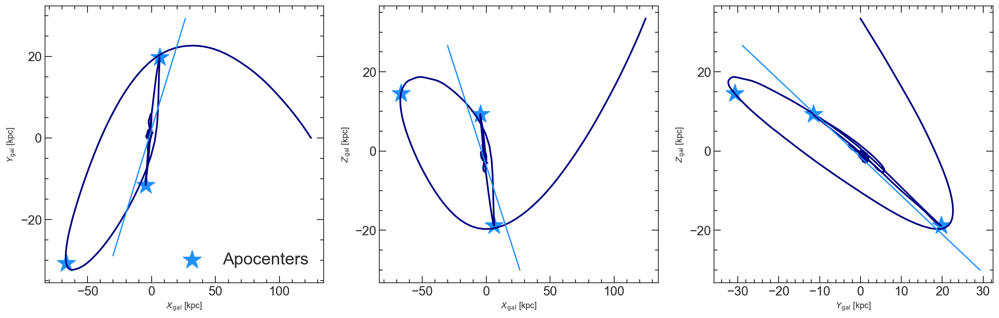

In [623]:
plt.subplots(1,3,figsize=(20, 6))
plt.subplot(131)
plt.plot(-ge_x, ge_y, zorder=0, c="Navy", lw=2)


plt.scatter(-ge_x[peaks[0:3]], ge_y[peaks[0:3]], c="dodgerblue", 
           marker="*", s=500, zorder=0, label="Apocenters")

#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

X = points
p = pca.components_[0]
centroid = np.mean(X, 0)
segments = np.arange(-50, 50)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,1], color="dodgerblue")


#plt.xlim(-70, 70)
#plt.ylim(-70, 70)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc]")
plt.ylabel(r"$Y_{\rm{gal}}$ [kpc]")
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

plt.legend(fontsize=20, frameon=False)

plt.subplot(132)
plt.plot(-ge_x, ge_z, zorder=0, c="Navy", lw=2)

plt.scatter(-ge_x[peaks[0:3]], ge_z[peaks[0:3]], c="dodgerblue", 
           marker="*", s=500, zorder=0)

#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

#plt.xlim(-70, 70)
#plt.ylim(-70, 70)

X = points
p = pca.components_[0]
centroid = np.mean(X, 0)
segments = np.arange(-50, 50)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,2], color="dodgerblue")


plt.xlabel(r"$X_{\rm{gal}}$ [kpc]")
plt.ylabel(r"$Z_{\rm{gal}}$ [kpc]")

plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")


plt.subplot(133)
plt.plot(ge_y, ge_z, zorder=0, c="Navy", lw=2)

plt.scatter(ge_y[peaks[0:3]], ge_z[peaks[0:3]], c="dodgerblue", 
           marker="*", s=500, zorder=0)

plt.xlabel(r"$Y_{\rm{gal}}$ [kpc]")
plt.ylabel(r"$Z_{\rm{gal}}$ [kpc]")


#plt.scatter(ge_x[troughs[0:3]], ge_y[troughs[0:3]], c="red")

#plt.xlim(-70, 70)
#plt.ylim(-70, 70)

X = points
p = pca.components_[0]
centroid = np.mean(X, 0)
segments = np.arange(-50, 50)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,1], (centroid+segments)[:,2], color="dodgerblue")


plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Orbit.pdf", bbox_inches='tight', dpi=300)

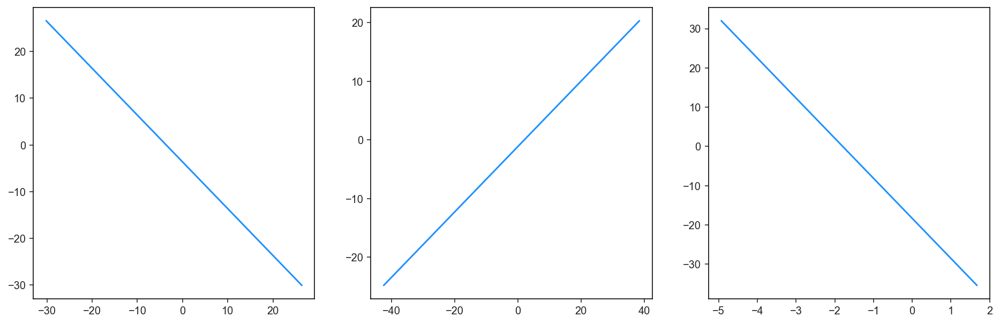

In [593]:
plt.subplots(1,3, figsize=(16, 5))
plt.subplot(1,3,1)
X = points
p = pca.components_[0]
centroid = np.mean(X, 0)
segments = np.arange(-50, 50)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,2], color="dodgerblue")

plt.subplot(1,3,2)
p = pca.components_[1]
centroid = np.mean(X, 0)
segments = np.arange(-50, 50)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,2], color="dodgerblue")

plt.subplot(1,3,3)
p = pca.components_[2]
centroid = np.mean(X, 0)
segments = np.arange(-50, 50)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,2], color="dodgerblue")

In [584]:
(np.arccos(1/(3**0.5)))*180/np.pi

54.735610317245346

In [638]:
np.mean(ge_165['Lz_noisy'][ge_165['h3_mask']]>1.5)

0.021189894050529748

In [580]:
pca.components_[0]

array([ 0.5714961,  0.5875354, -0.5728824], dtype=float32)

In [590]:
angle_between(pca.components_[0],[-5,20,-20])*(180/np.pi)

44.884838041603956

In [152]:
np.arccos(pca.components_[0][0])*(180/np.pi)

55.14537983026843

In [147]:
abg(-pca.components_[0])

(124.85462557275642, 125.98230997325842, 55.04852501220756)

In [760]:
abg((-0.5713938,-0.61457657,0.54387936 ))

(124.84747709747712, 127.9211597018807, 57.05188363721382)

In [755]:
dist = 30
mask = (np.abs(ge_165['X_gal_501'])<dist) & (np.abs(ge_165['Y_gal_501'])<dist)\
 & (np.abs(ge_165['Z_gal_501'])<dist) 

#mask = (np.abs(ge_165['Z_gal_501'])<30) & (np.abs(ge_165['Z_gal_501'])>10)

points = ge_165['X_gal_501','Y_gal_501','Z_gal_501'][mask].to_pandas().to_numpy()

pca = PCA(n_components=3)
pca.fit(points)

print(np.array([pca.components_[1], -pca.components_[0], pca.components_[2]]))

[[ 0.86764    -0.29151142  0.40276766]
 [ 0.4920693   0.61946446 -0.61166286]
 [-0.07119357  0.7288928   0.6809161 ]]


55.145374427243596

In [757]:
print(produce_rot(35,5,-135))

[[ 0.81603492  0.35509674 -0.45606283]
 [ 0.5713938  -0.61457657  0.54387936]
 [-0.08715574 -0.70441603 -0.70441603]]


In [ ]:
def produce_rot(alpha, beta, gamma):
    
    alpha = (alpha/180)*np.pi
    beta = (beta/180)*np.pi
    gamma = (gamma/180)*np.pi
    
    row1 = np.array([np.cos(alpha)*np.cos(beta), 
                     np.cos(alpha)*np.sin(beta)*np.sin(gamma)-np.sin(alpha)*np.cos(gamma),
                    np.cos(alpha)*np.sin(beta)*np.cos(gamma)+np.sin(alpha)*np.sin(gamma)])
    row2 = np.array([np.sin(alpha)*np.cos(beta), 
                     np.sin(alpha)*np.sin(beta)*np.sin(gamma)+np.cos(alpha)*np.cos(gamma),
                    np.sin(alpha)*np.sin(beta)*np.cos(gamma)-np.cos(alpha)*np.sin(gamma)])
    row3 = np.array([-np.sin(beta), 
                     np.cos(beta)*np.sin(gamma),
                    np.cos(beta)*np.cos(gamma)])
    
    return np.array([row1, row2, row3])

array([[ 0.81603492, -0.35509674,  0.45606283],
       [-0.5713938 , -0.61457657,  0.54387936],
       [ 0.08715574, -0.70441603, -0.70441603]])

In [752]:
abg((-0.5714961 , -0.5875354 ,  0.5728824 ))

(124.85462172207872, 125.98230951361278, 55.04852780118283)

In [751]:
abg(( -0.5714961 , -0.5875354 ,  0.5728824))

(124.85462172207872, 125.98230951361278, 55.04852780118283)

In [ ]:
produce_rot(, 0, )

In [676]:
np.arcsin(-0.4920693)*180/np.pi,  np.arcsin(0.7288928)*180/np.pi

(-29.47668163390673, 46.793653709175814)

In [664]:
#### y > x > z  #######

#alpha = 29.8 degrees
#beta = 0 degrees
#gamma = 47 degrees

#gamma = 29.8 degrees
#beta = 0 degrees
#eta = 47 degrees

np.array([pca.components_[1], pca.components_[0], pca.components_[2]])

array([[ 0.8178868 , -0.35105097,  0.45587763],
       [ 0.5714961 ,  0.5875354 , -0.5728824 ],
       [ 0.06673331, -0.72908515, -0.6811618 ]], dtype=float32)

In [668]:
np.arccos(0.8178)*180/np.pi, np.arcsin(-0.72908515)*180/np.pi 

(35.13483215359766, -46.8097536855218)

(29.814460244936917, 46.793653709175814)

[ 36.4131285   45.84036982 -45.26305199] [-35.92105919 -45.22090536  44.65138912]
[-49.45548105  16.61615074 -22.95775652] [ 48.58784103 -16.32463932  22.55498886]
[  2.42058133 -24.78235531 -23.15114641] [-2.34938776 24.05346251 22.47023034]


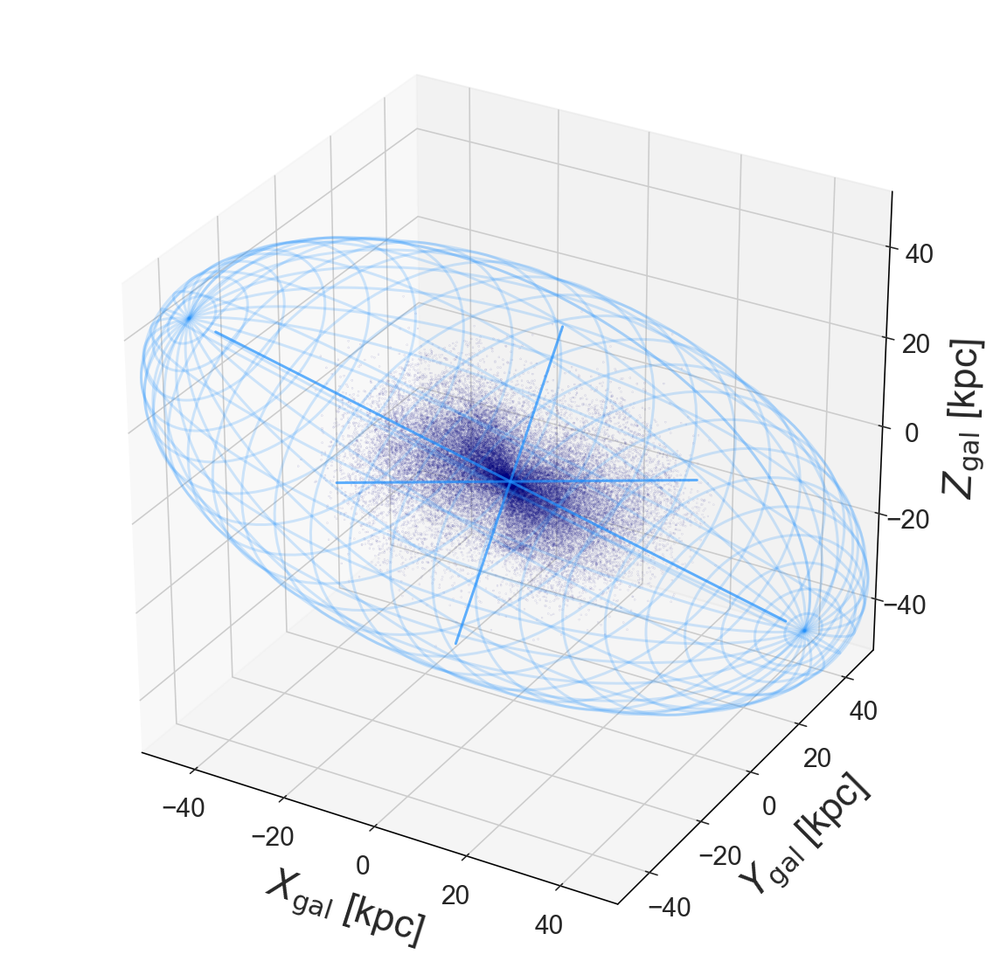

In [51]:
fig = plt.figure(figsize=(10., 10.))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(points[:, 0], points[:, 1], points[:, 2], c='navy', marker='.', s=0.01, 
           rasterized=True)

plot_ellipsoid_3d(ell, ax, color="dodgerblue")  

p = pca.components_[0]
centroid = np.mean(X, 0)
segments = np.arange(-74, 74)[:, np.newaxis] * p
print(segments[0], segments[-1])
plt.plot(*(centroid + segments).T, color="dodgerblue", alpha=0.7)

p = pca.components_[1]
centroid = np.mean(X, 0)
segments = np.arange(-57, 57)[:, np.newaxis] * p
print(segments[0], segments[-1])
plt.plot(*(centroid + segments).T, color="dodgerblue", alpha=0.7)


p = pca.components_[2]
centroid = np.mean(X, 0)
segments = np.arange(-34, 34)[:, np.newaxis] * p
print(segments[0], segments[-1])
plt.plot(*(centroid + segments).T, color="dodgerblue", alpha=0.7)


#ax.scatter(30,30, 30)

ax.set_xlim(-50, 50)
ax.set_ylim(-50, 50)
ax.set_zlim(-50, 50)

ax.set_zlabel("\n"r"$Z_{\rm{gal}}$ [kpc]", fontsize=22, rotation=90)
ax.set_xlabel("\n"r"$X_{\rm{gal}}$ [kpc]", fontsize=22)
ax.set_ylabel("\n"r"$Y_{\rm{gal}}$ [kpc]", fontsize=22)


#plt.locator_params(axis='x',nbins=6)
#plt.locator_params(axis='y',nbins=6)
#plt.minorticks_on()
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='z', labelsize=15, length=8, width=1,right="off", direction="in")
#plot_ellipsoid_3d(master_ells[-1], ax)
#lineplot = ax.plot(*(centroid + segments).T, color="red")
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Shape1.pdf", bbox_inches="tight", dpi=300)

NameError: name 'X' is not defined

/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWar

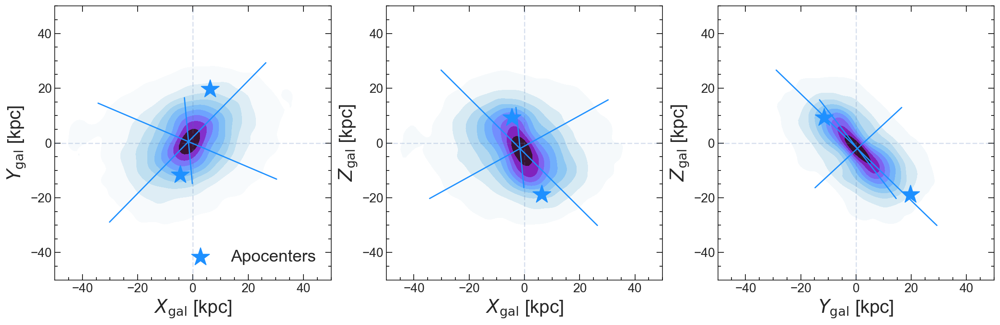

In [655]:
lim0 = 50
lim = 100
plt.subplots(1,3,figsize=(20,6))

plt.subplot(131)
sns.kdeplot(ge_165['X_gal_501'], 
            ge_165['Y_gal_501'],
           cmap="cmr.voltage_r",
           fill=True)
plt.xlim(-lim0, lim0)
plt.ylim(-lim0, lim0)
plt.axvline(0, ls="--", alpha=0.2)
plt.axhline(0, ls="--", alpha=0.2)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$ [kpc]", fontsize=22)
#plt.legend(loc=3,fontsize=20, frameon=False)

p = pca.components_[0]
centroid = np.mean(X, 0)
segments = np.arange(-50, 50)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,1], color="dodgerblue",
        ls="-")

p = pca.components_[1]
centroid = np.mean(X, 0)
segments = np.arange(-40, 40)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,1], color="dodgerblue",
        ls="-")

p = pca.components_[2]
centroid = np.mean(X, 0)
segments = np.arange(-22, 22)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,1], color="dodgerblue",
        ls="-")

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=7, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=7, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='both', which="minor", labelsize=0, length=3.5, width=1, direction="in",
               right="off", left="on")

plt.scatter(-ge_x[peaks[1:3]], ge_y[peaks[1:3]], c="dodgerblue", 
           marker="*", s=500, label="Apocenters")
plt.legend(loc="lower right",fontsize=20, frameon=False)

plt.subplot(133)

sns.kdeplot(ge_165['Y_gal_501'], 
            ge_165['Z_gal_501'],
           cmap="cmr.voltage_r",
           fill=True)
plt.xlim(-lim0, lim0)
plt.ylim(-lim0, lim0)
plt.axvline(0, ls="--", alpha=0.2)
plt.axhline(0, ls="--", alpha=0.2)
plt.xlabel(r"$Y_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$Z_{\rm{gal}}$ [kpc]", fontsize=22)

p = pca.components_[0]
centroid = np.mean(X, 0)
segments = np.arange(-50, 50)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,1], (centroid+segments)[:,2], color="dodgerblue",
        ls="-")

p = pca.components_[1]
centroid = np.mean(X, 0)
segments = np.arange(-40, 40)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,1], (centroid+segments)[:,2], color="dodgerblue",
        ls="-")

p = pca.components_[2]
centroid = np.mean(X, 0)
segments = np.arange(-22, 22)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,1], (centroid+segments)[:,2], color="dodgerblue",
        ls="-")

plt.scatter(ge_y[peaks[1:3]], ge_z[peaks[1:3]], c="dodgerblue", 
           marker="*", s=500)

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=7, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=7, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='both', which="minor", labelsize=0, length=3.5, width=1, direction="in",
               right="off", left="on")


plt.subplot(1,3,2)
sns.kdeplot(ge_165['X_gal_501'], 
            ge_165['Z_gal_501'],
           cmap="cmr.voltage_r",
           fill=True)
plt.xlim(-lim0, lim0)
plt.ylim(-lim0, lim0)
plt.axvline(0, ls="--", alpha=0.2)
plt.axhline(0, ls="--", alpha=0.2)


p = pca.components_[0]
centroid = np.mean(X, 0)
segments = np.arange(-50, 50)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,2], color="dodgerblue",
        ls="-")

p = pca.components_[1]
centroid = np.mean(X, 0)
segments = np.arange(-40, 40)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,2], color="dodgerblue",
        ls="-")

p = pca.components_[2]
centroid = np.mean(X, 0)
segments = np.arange(-22, 22)[:, np.newaxis] * p
plt.plot((centroid+segments)[:,0], (centroid+segments)[:,2], color="dodgerblue",
        ls="-")

plt.scatter(-ge_x[peaks[1:3]], ge_z[peaks[1:3]], c="dodgerblue", 
           marker="*", s=500)


plt.xlabel(r"$X_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$Z_{\rm{gal}}$ [kpc]", fontsize=22)

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=7, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=7, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='both', which="minor", labelsize=0, length=3.5, width=1, direction="in",
               right="off", left="on")
#plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/HAC_VOD.pdf", bbox_inches="tight", dpi=300)
plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/Shape2_v2.pdf", bbox_inches="tight", dpi=300)

In [606]:
ge_y[peaks[0:3]], ge_z[peaks[0:3]]

(array([-30.745506,  19.709854, -11.531832], dtype=float32),
 array([ 14.472447, -18.820374,   9.280062], dtype=float32))

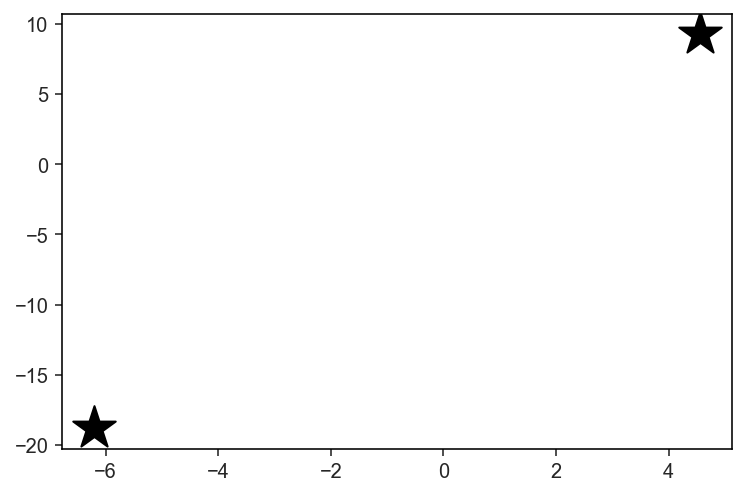

In [652]:
plt.scatter(ge_x[peaks[1:3]], ge_z[peaks[1:3]], 
           marker="*", s=500,facecolors='k', edgecolors='k', lw=1)

In [293]:
plot_ellipsoid_3d?

In [329]:
ell.ctr

array([-1.067964  ,  0.65117955, -2.1717172 ], dtype=float32)

In [271]:
ell.axes?

In [162]:
ell.

(array([-43.14661219, -42.21939302,  39.62395489]),
 array([ 39.95386603,  43.21340645, -43.67814839]))

In [222]:
(np.arctan2(43.62395489, ((43.2**2+39.95**2)**0.5))/np.pi)*180

36.55284085137328

In [167]:
(np.arctan2(39.62395489, ((43.14661219**2+42.21939302**2)**0.5))/np.pi)*180

33.28051176747893

In [165]:
np.arctan2?

In [ ]:
-43.14661219, -42.21939302,  39.62395489

In [333]:
ell.vol

728002.9462834614

array([10.        ,  7.25135429,  4.80976137])

In [117]:
ell.axlens

array([79.28066622, 57.48921993, 38.13210857])

In [338]:
ell.axlens

array([76.54464164, 55.50523157, 36.81614604])

In [334]:
ell.scale_to_vol(ell.vol*0.9)

In [335]:
ell.major_axis_endpoints()

(array([ 36.59727953,  48.06788073, -48.9912435 ]),
 array([-38.73320745, -46.76552163,  44.64780917]))

In [342]:
in_ellipse = np.array([ell.contains(x) for x in points])

In [377]:
100*((0.99)**40)

66.89717585696803

In [378]:
#####algorithm
# compute ellipse for all points
# shrink by 1%
# remove points outside the 1%
# fit new ellipse
# repeat till axes slopes are stable

mask = (np.abs(ge_165['X_gal_501'])<35) & (np.abs(ge_165['Y_gal_501'])<35)\
& (np.abs(ge_165['Z_gal_501'])<35)
points = ge_165['X_gal_501','Y_gal_501','Z_gal_501'][mask].to_pandas().to_numpy()

slopes = []
master_ells = []

for x in range(100):
    ells = nestle.bounding_ellipsoids(points)
    ell = ells[0]
    master_ells.append(ell)
    
    diffs = (ell.major_axis_endpoints()[1] - ell.major_axis_endpoints()[0])
    slopes.append([diffs[0]/diffs[1], diffs[0]/diffs[2], diffs[1]/diffs[2]])

    ell.scale_to_vol(ell.vol*0.99)
    in_ellipse = np.array([ell.contains(x) for x in points])
    points = points[in_ellipse]
    
slopes = np.array(slopes)

In [379]:
slopes = np.array(slopes)
len(slopes)

100

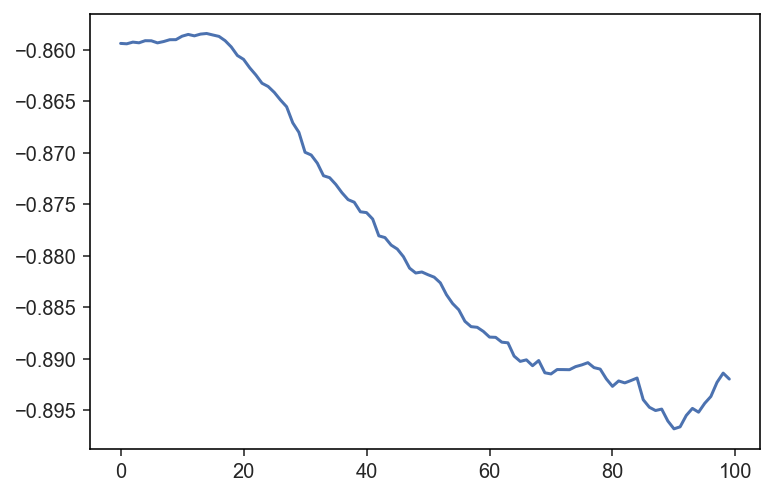

In [380]:
plt.plot(slopes[:,1])

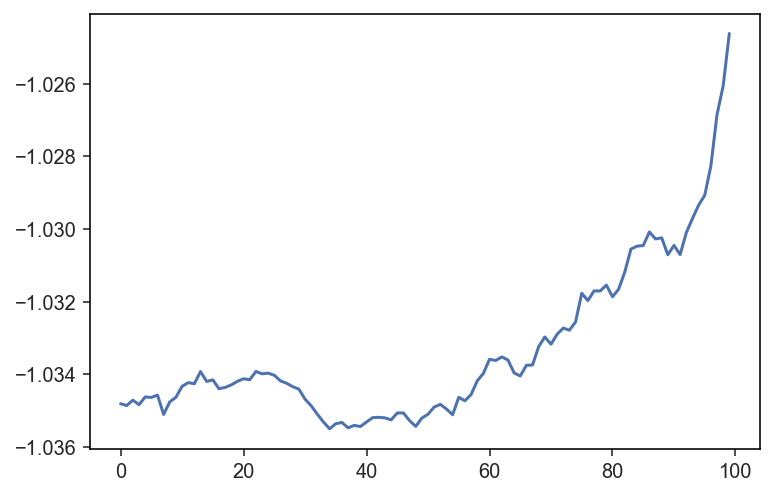

In [381]:
plt.plot(slopes[:,2])

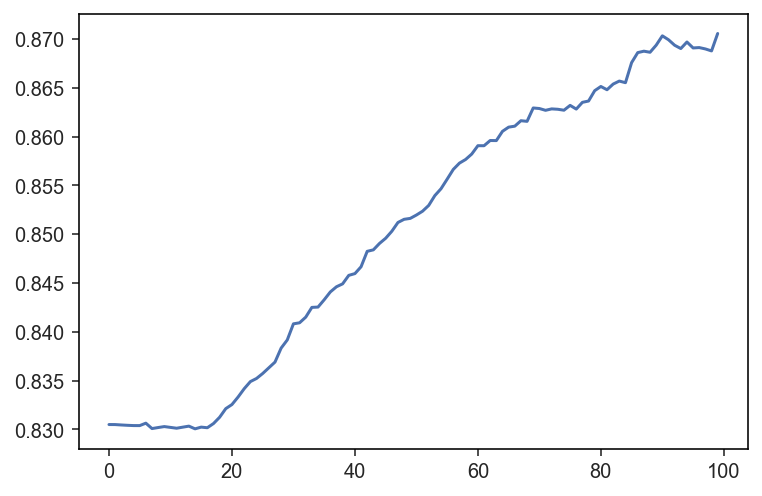

In [382]:
plt.plot(slopes[:,0])

/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


5792


/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


3589


/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


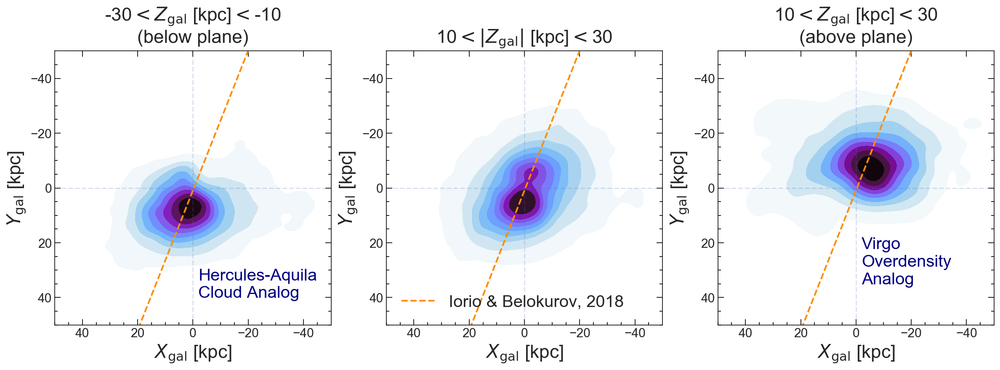

In [318]:
plt.subplots(1,3,figsize=(20,6))

plt.subplot(132)
mask = (np.abs(ge_165['Z_gal_501'])<30) & (np.abs(ge_165['Z_gal_501'])>5) & (np.abs(ge_165['X_gal_501'])<50) & (np.abs(ge_165['Y_gal_501'])<50)
sns.kdeplot(ge_165['X_gal_501'][mask], 
            ge_165['Y_gal_501'][mask],
           cmap="cmr.voltage_r",
           fill=True)
plt.xlim(50, -50)
plt.ylim(50, -50)
plt.axvline(0, ls="--", alpha=0.2)
plt.axhline(0, ls="--", alpha=0.2)


plt.xlabel(r"$X_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$ [kpc]", fontsize=22)
plt.plot(np.array([-21.324, 20.313]), np.array([-53.523, 52.829]), lw=2, ls="--", 
        label= "Iorio & Belokurov, 2018", c="darkorange")

#p = pca.components_[0]
#centroid = np.mean(X, 0)
#segments = np.arange(-50, 50)[:, np.newaxis] * p
#plt.plot((centroid+segments)[:,0], (centroid+segments)[:,1], color="dodgerblue")



plt.legend(loc=3,fontsize=20, frameon=False)
plt.title(r"10$<|Z_{\rm{gal}}|$ [kpc]$<$30 ", fontsize=22, pad=10)

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=7, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=7, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='both', which="minor", labelsize=0, length=3.5, width=1, direction="in",
               right="off", left="on")

plt.subplot(131)
mask = (ge_165['Z_gal_501']<-10) & (ge_165['Z_gal_501']>-30)

print(np.count_nonzero(mask & (ge_165['X_gal_501']>0) & (ge_165['Y_gal_501']>0) ))
#plt.scatter(ge_165['X_gal_501'][mask], ge_165['Y_gal_501'][mask], s=2)
sns.kdeplot(ge_165['X_gal_501'][mask], 
            ge_165['Y_gal_501'][mask],
           cmap="cmr.voltage_r",
           fill=True)
plt.xlim(50, -50)
plt.ylim(50, -50)
plt.axvline(0, ls="--", alpha=0.2)
plt.axhline(0, ls="--", alpha=0.2)
plt.title(r"-30$<Z_{\rm{gal}}$ [kpc]$<$-10""\n(below plane)", fontsize=22, pad=10)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$ [kpc]", fontsize=22)
plt.plot(np.array([-21.324, 20.313]), np.array([-53.523, 52.829]), lw=2, ls="--", 
        label= "Iorio & Belokurov, 2018", c="darkorange")


#plt.plot((centroid+segments)[:,0], (centroid+segments)[:,1], color="dodgerblue")

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=7, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=7, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='both', which="minor", labelsize=0, length=3.5, width=1, direction="in",
               right="off", left="on")
plt.text(-2, 40,"Hercules-Aquila\nCloud Analog", color="Navy", fontsize=20,)

plt.subplot(1,3,3)
mask = (ge_165['Z_gal_501']<30) & (ge_165['Z_gal_501']>10)
print(np.count_nonzero(mask & (ge_165['X_gal_501']<0) & (ge_165['Y_gal_501']<0) ))
#plt.scatter(ge_165['X_gal_501'][mask], ge_165['Y_gal_501'][mask], s=2)
sns.kdeplot(ge_165['X_gal_501'][mask], 
            ge_165['Y_gal_501'][mask],
           cmap="cmr.voltage_r",
           fill=True)

#plt.scatter(-10, -10, marker="*", color="darkorange", s=500)

#plt.plot((centroid+segments)[:,0], (centroid+segments)[:,1], color="dodgerblue")

plt.xlim(50, -50)
plt.ylim(50, -50)
plt.axvline(0, ls="--", alpha=0.2)
plt.axhline(0, ls="--", alpha=0.2)
plt.title(r"10$<Z_{\rm{gal}}$ [kpc]$<$30""\n(above plane)", fontsize=22, pad=10)
plt.xlabel(r"$X_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$Y_{\rm{gal}}$ [kpc]", fontsize=22)

plt.plot(np.array([-21.324, 20.313]), np.array([-53.523, 52.829]), lw=2, ls="--", 
        label= "Iorio & Belokurov, 2018", c="darkorange")

plt.locator_params(axis='x',nbins=6)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=7, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=7, width=1,right="off", direction="in")
plt.minorticks_on()
plt.tick_params(axis='both', which="minor", labelsize=0, length=3.5, width=1, direction="in",
               right="off", left="on")
plt.text(-2, 35,"Virgo\nOverdensity\nAnalog", color="Navy", fontsize=20,)

plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/HAC_VOD_v4.pdf", bbox_inches="tight", dpi=300)

# Shape of halo for other models

In [157]:
inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_150.pickle", "rb"))
ge_inp = hstack(inp)
ge_150 = read_file(ge_inp, 501)

inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_155.pickle", "rb"))
ge_inp = hstack(inp)
ge_155 = read_file(ge_inp, 501)

inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_160.pickle", "rb"))
ge_inp = hstack(inp)
ge_160 = read_file(ge_inp, 501)

inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_170.pickle", "rb"))
ge_inp = hstack(inp)
ge_170 = read_file(ge_inp, 501)

inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_175.pickle", "rb"))
ge_inp = hstack(inp)
ge_175 = read_file(ge_inp, 501)

inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_180.pickle", "rb"))
ge_inp = hstack(inp)
ge_180 = read_file(ge_inp, 501)

/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/astropy/coordinates/angles.py:522: RuntimeWarning: invalid value encountered in less
  if np.any(angles.value < lower) or np.any(angles.value > upper):
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/astropy/coordinates/angles.py:522: RuntimeWarning: invalid value encountered in greater
  if np.any(angles.value < lower) or np.any(angles.value > upper):
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:1020: RuntimeWarning: invalid value encountered in greater
  result = getattr(super(), op)(other)
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:1020: RuntimeWarning: invalid value encountered in less
  result = getattr(super(), op)(other)
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/numpy/core/_methods.py:161

In [189]:
inp[0]

X_gal,Y_gal,Z_gal,Vx_gal,Vy_gal,Vz_gal
float32,float32,float32,float32,float32,float32
nan,nan,nan,nan,nan,nan
nan,nan,nan,nan,nan,nan
nan,nan,nan,nan,nan,nan
nan,nan,nan,nan,nan,nan
nan,nan,nan,nan,nan,nan
nan,nan,nan,nan,nan,nan
nan,nan,nan,nan,nan,nan
nan,nan,nan,nan,nan,nan
nan,nan,nan,nan,nan,nan


In [183]:
inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_170.pickle", "rb"))
ge_inp = hstack(inp)
ge_170 = read_file(ge_inp, 501)

/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/astropy/coordinates/angles.py:522: RuntimeWarning: invalid value encountered in less
  if np.any(angles.value < lower) or np.any(angles.value > upper):
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/astropy/coordinates/angles.py:522: RuntimeWarning: invalid value encountered in greater
  if np.any(angles.value < lower) or np.any(angles.value > upper):
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:1020: RuntimeWarning: invalid value encountered in greater
  result = getattr(super(), op)(other)
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:1020: RuntimeWarning: invalid value encountered in less
  result = getattr(super(), op)(other)
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/numpy/core/_methods.py:161

In [174]:
for ge in [ge_150, ge_155, ge_160, ge_165, ge_170, ge_175, ge_180]:
    
    dist = 30
    
    mask = (np.abs(ge['X_gal_501'])<dist) & (np.abs(ge['Y_gal_501'])<dist)\
    & (np.abs(ge['Z_gal_501'])<dist) 

    points = ge['X_gal_501','Y_gal_501','Z_gal_501'][mask].to_pandas().to_numpy()

    pca = PCA(n_components=3)
    pca.fit(points)

    print(np.array([pca.components_[1], pca.components_[0], pca.components_[2]]))

[[ 0.64894015 -0.27736387  0.7084817 ]
 [-0.7004048  -0.58148307  0.413897  ]
 [ 0.29717004 -0.7648181  -0.5716146 ]]


/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:1020: RuntimeWarning: invalid value encountered in less
  result = getattr(super(), op)(other)


ValueError: Found array with 0 sample(s) (shape=(0, 3)) while a minimum of 1 is required.

# SFH Schematic

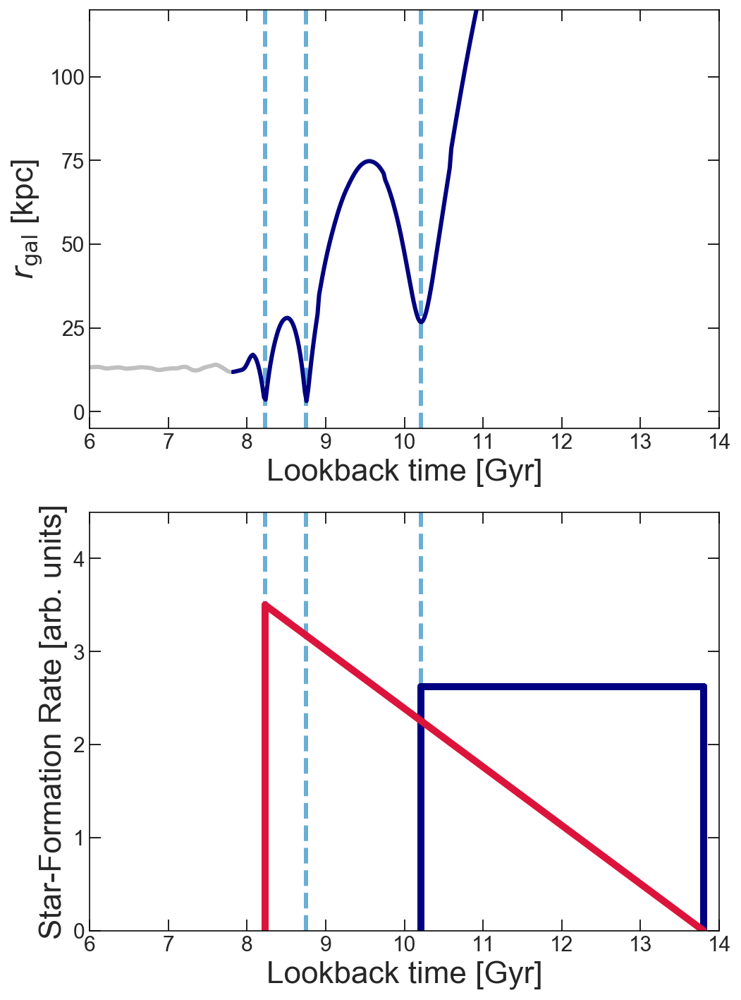

In [11]:
plt.subplots(2,1,figsize=(8,12))
plt.subplot(211)

cmap = plt.get_cmap('Blues')
ge_500 = ge_165

plt.axvline(10.206, ls="--", c=cmap(0.5), lw=3,alpha=1,
            label="Pericenters")
plt.axvline(10.206 - (2.25-0.79), ls="--", c=cmap(0.5), lw=3,alpha=1)
plt.axvline(10.206 - (2.77-0.79), ls="--", c=cmap(0.5), lw=3,alpha=1)

plt.plot( 10.206 - ((np.arange(500)/50)[(np.arange(500)/50)<3.2] -0.79), 
         ge_500['com'][0:500][(np.arange(500)/50)<3.2], lw=3, c="navy")

plt.plot( 10.206 - ((np.arange(500)/50)[(np.arange(500)/50)>3.2]-0.79), 
         ge_500['com'][0:500][(np.arange(500)/50)>3.2], lw=3, c="silver")

#plt.plot(np.arange(500)/50, ge_165['com'][0:500], lw=3, c="navy")
#plt.axhline(27, ls="--", c=cmap(0.6), zorder=0, lw=2)
plt.xlabel(r"Lookback time [Gyr]", fontsize=22)
plt.ylabel(r"$r_{\rm{gal}}$ [kpc]", fontsize=22)
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
plt.xlim(6, 14)
plt.ylim(-5,120)
#plt.legend(fontsize=20,frameon=False)

#plt.text(6.4, 18, "merger\ncomplete", color="gray", fontsize=18)


plt.subplot(212)

plt.axvline(10.206, ls="--", c=cmap(0.5), lw=3,alpha=1)
plt.axvline(10.206 - (2.25-0.79), ls="--", c=cmap(0.5), lw=3,alpha=1)
plt.axvline(10.206 - (2.77-0.79), ls="--", c=cmap(0.5), lw=3,alpha=1)

ge_col = "navy"
plt.plot( [10.206, 10.206], [0, 2.62], lw=5, c=ge_col)
plt.plot( [13.8, 13.8], [0, 2.62], lw=5, c=ge_col)
plt.plot( [10.206, 13.8], [2.62, 2.62], lw=5, c=ge_col)
situ_col = "crimson"
plt.plot( [8.2305, 8.2305], [0, 3.50], lw=5, c=situ_col)
plt.plot( [8.2305, 13.8], [3.50, 0], lw=5, c=situ_col)
plt.ylim(0, 4.5)
plt.xlim(6, 14)
plt.ylabel("Star-Formation Rate [arb. units]", fontsize=22)
plt.xlabel("Lookback time [Gyr]", fontsize=22)
#plt.minorticks_on()
plt.locator_params(axis='y',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")
plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/sfh_v2.pdf",bbox_inches='tight', dpi=300)

In [242]:
pot = gp.MilkyWayPotential()

In [243]:
pot.mass_enclosed(50*u.kpc)

<Quantity [4.37691879e+11] solMass>

# Net rotation

In [119]:
def track_lz(ge):

    lz =[]
    for indx in range(500):
        idx = indx+1
        w = gd.PhaseSpacePosition(pos=[ge['X_gal_%s'%idx], ge['Y_gal_%s'%idx], ge['Z_gal_%s'%idx]]*u.kpc, 
                      vel=[ge['Vx_gal_%s'%idx], ge['Vy_gal_%s'%idx], ge['Z_gal_%s'%idx]]*u.km/u.s )
        lz.append(w.angular_momentum()[2]/1e+3)        
    lz = np.array(lz)
    
    return lz

In [484]:
mask = rc_mask & (rcat['R_gal']<20) #& (rcat['R_gal']<50) #& (rcat['eccen_pot1']<0.7)
weights = rcat['mag_weights'][mask]
#weights[weights>600] = 600

print(np.count_nonzero(rc_mask))
np.median(weighted_bootstrap(rcat['Lz'][mask], weights,
                      np.mean, samples=1000))*1000

2801


67.15211126908846

In [488]:
np.mean(ge_165['Lz'][ge_165['h3_mask'] & (ge_165['R_gal']<10) & (ge_165['R_gal']>8)])*1000

49.14135020798754

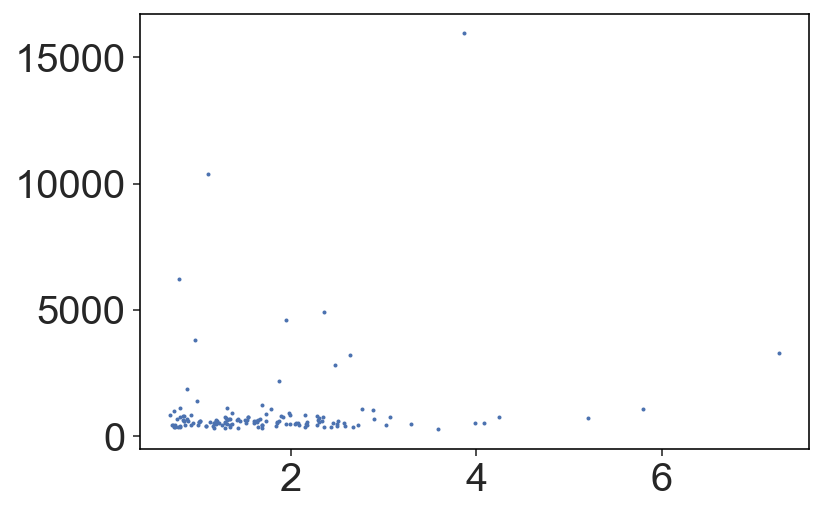

In [457]:
plt.scatter(rcat['Lz'][mask],rcat['mag_weights'][mask], s=1)

In [448]:
np.count_nonzero(ge_165['Ly_noisy'] < -0.3*ge_165['Lz_noisy'] -2.5)

6

[ 5.  12.5 17.5 22.5 27.5 40. ] [ 30.34403186  49.62901704  51.81257482  85.79604595 214.6474283
 777.6603658 ]
[ 5.  12.5 17.5 22.5 27.5 40. ] [-21.75394966   9.33646321   9.42576707  78.49192493 114.78479446
 400.87355618]
[ 5.  12.5 17.5 22.5 27.5 40. ] [ 90.55149646  61.2410837   61.31478195  85.70498683  85.33489443
 357.99416312]


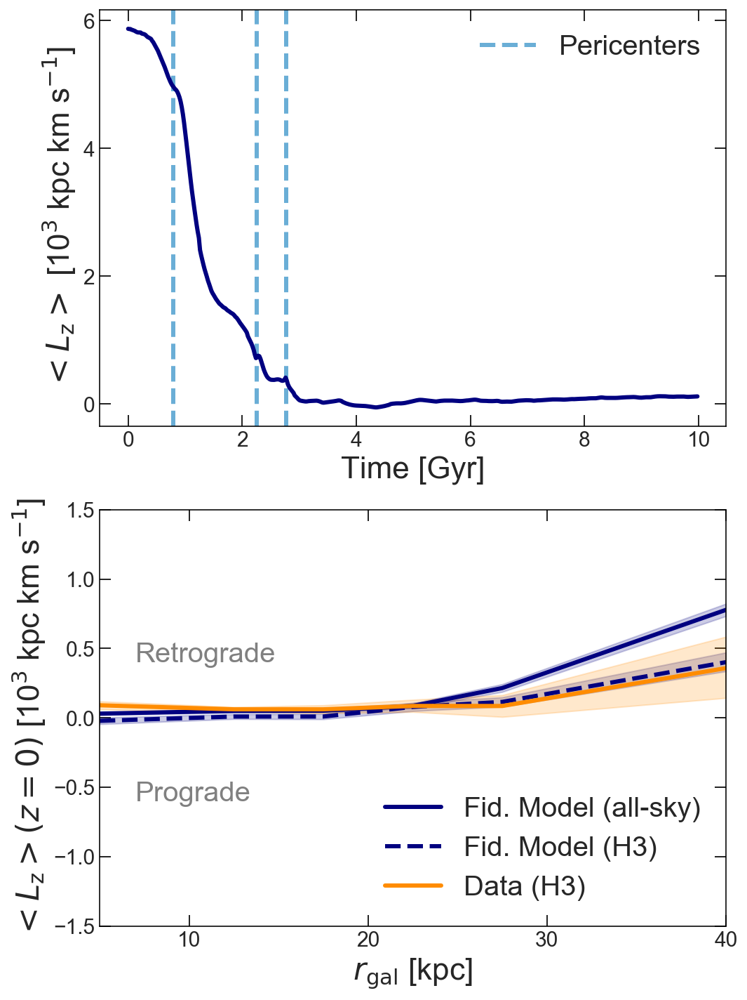

In [535]:
#plt.subplots(2,1, figsize=(16, 6))

plt.subplots(2,1,figsize=(8,12))


plt.subplot(212)

distarr1 = np.array([0,10,15,20,25,30]) 
distarr2 = np.array([10,15,20,25,30,50])

#############################

mean_lz = []
per16_lz = []
per84_lz = []
for dist1, dist2 in zip(distarr1, distarr2):
    mask = (ge_165['R_gal_noisy']>dist1) & (ge_165['R_gal_noisy']<dist2)
    #& (ge_165['h3_mask']) #& (ge_165['Lz_noisy']>-1)
    mean_samples = weighted_bootstrap(ge_165['Lz_noisy'][mask][0:-1:5], 
                                      (np.ones(np.count_nonzero(mask))*639)[0:-1:5],
                      np.mean, samples=1000)
    mean_lz.append(np.mean(mean_samples))
    per16_lz.append(np.percentile(mean_samples, 16) )
    per84_lz.append(np.percentile(mean_samples, 84) )
    

plt.plot( (distarr1+distarr2)/2,
        mean_lz,c="navy", ls="-", label="Fid. Model (all-sky)", lw=3)
print((distarr1+distarr2)/2, np.array(mean_lz)*1000)
plt.fill_between((distarr1+distarr2)/2, np.array(per16_lz),
                 np.array(per84_lz), color="navy", alpha=0.2)

########################################################

# distarr1 = np.array([0,10,15,20,25,30]) 
# distarr2 = np.array([10,15,20,25,30,50])

mean_lz = []
per16_lz = []
per84_lz = []
for dist1, dist2 in zip(distarr1, distarr2):
    mask = (ge_165['R_gal_noisy']>dist1) & (ge_165['R_gal_noisy']<dist2) \
    & (ge_165['h3_mask']) & (ge_165['dist_adpt_noisy']>3) & (ge_165['dist_adpt_noisy']<50) #& (ge_165['Lz_noisy']>-1)
    mean_samples = weighted_bootstrap(ge_165['Lz_noisy'][mask][0:-1:5], 
                                      (np.ones(np.count_nonzero(mask))*639)[0:-1:5],
                      np.mean, samples=1000)
    mean_lz.append(np.mean(mean_samples))
    per16_lz.append(np.percentile(mean_samples, 16) )
    per84_lz.append(np.percentile(mean_samples, 84) )
    

plt.plot( (distarr1+distarr2)/2,
        mean_lz,c="navy", label="Fid. Model (H3)", lw=3, ls="--")
print((distarr1+distarr2)/2, np.array(mean_lz)*1000)
plt.fill_between((distarr1+distarr2)/2, np.array(per16_lz),
                 np.array(per84_lz), color="navy", alpha=0.2)


############################################

# distarr1 = np.array([0,10,15,20,25,30]) 
# distarr2 = np.array([10,15,20,25,30,50])

# mean_lz = []
# per16_lz = []
# per84_lz = []
# for dist1, dist2 in zip(distarr1, distarr2):
#     mask = (local_rapo.value>dist1 ) & (local_rapo.value<dist2)
    
#     mean_samples = weighted_bootstrap(local['Lz'][mask], 
#                                       np.ones(np.count_nonzero(mask))*639,
#                       np.mean, samples=1000)
    
#     mean_lz.append(np.mean(mean_samples))
#     per16_lz.append(np.percentile(mean_samples, 16) )
#     per84_lz.append(np.percentile(mean_samples, 84) )
    

# plt.plot( (distarr1+distarr2)/2,
#         mean_lz, c="green", label="Fid. Model\n(local halo extrapol.)", lw=3, ls="--",)
# print((distarr1+distarr2)/2, np.array(mean_lz)*1000)
# plt.fill_between((distarr1+distarr2)/2, np.array(per16_lz),
#                  np.array(per84_lz), color="green", alpha=0.2)


##################################################

mean_lz = []

# distarr1 = np.array([0,10,15,20,25,30]) 
# distarr2 = np.array([10,15,20,25,30,50])

for dist1, dist2 in zip(distarr1, distarr2):
    
    mask = rc_mask & (rcat['R_gal']>dist1 ) & (rcat['R_gal']<dist2)
    
    mean_lz.append(weighted_bootstrap(rcat['Lz'][mask], rcat['mag_weights'][mask],
                      np.mean, samples=1000))

mean_lz = np.array(mean_lz)

plt.plot( (distarr1+distarr2)/2,
        np.mean(mean_lz, axis=1), c="darkorange", label="Data (H3)", lw=3)
print((distarr1+distarr2)/2,np.array(np.mean(mean_lz, axis=1))*1000)
plt.fill_between((distarr1+distarr2)/2, np.percentile(mean_lz, axis=1, q=16),
                 np.percentile(mean_lz, axis=1, q=84), color="darkorange", alpha=0.2)


#####################################################

plt.xlabel(r"$r_{\rm{gal}}$ [kpc]", fontsize=22)
plt.ylabel(r"$<L_{\rm{z}}> (z=0)$ [10$^{3}$ kpc km s$^{-1}$]", fontsize=22)

plt.ylim(-1.5, 1.5)
plt.xlim(5,40)

plt.legend(fontsize=20, loc="lower right", frameon=False)
plt.text(7, -0.6, "Prograde", fontsize=20, color="gray")
plt.text(7, 0.4, "Retrograde", fontsize=20, color="gray")

plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

plt.subplot(211)

plt.axvline(0.79, ls="--", c=cmap(0.5), lw=3,alpha=1,label="Pericenters")
plt.axvline(2.25, ls="--", c=cmap(0.5), lw=3,alpha=1)
plt.axvline(2.77, ls="--", c=cmap(0.5), lw=3,alpha=1)

plt.plot(np.arange(500)/50, 
         -np.mean(track_lz(ge_165), axis=1),
        c="navy", lw=3)

plt.xlabel("Time [Gyr]", fontsize=22)
plt.ylabel(r"$<L_{\rm{z}}>$ [10$^{3}$ kpc km s$^{-1}$]", fontsize=22)

plt.legend(fontsize=20, loc="upper right", frameon=False)
#plt.ylim(-6, 6)

plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")
plt.tick_params(axis='x', which="minor" , length=4, width=1, top="off", direction="in", )
plt.tick_params(axis='y', which="minor", length=4, width=1, right="off", direction="in")

# plt.savefig("/Users/rohannaidu/Dropbox/Arjuna_figs/net_rot.pdf",
#             bbox_inches='tight', dpi=300)

In [530]:
(distarr1+distarr2)/2,np.mean(mean_lz, axis=1)*1e+3

(array([ 5. , 12.5, 17.5, 22.5, 27.5, 40. ]),
 array([ 91.31954559,  61.46837118,  60.9413378 ,  83.39404852,
         88.69020219, 352.75382823]))

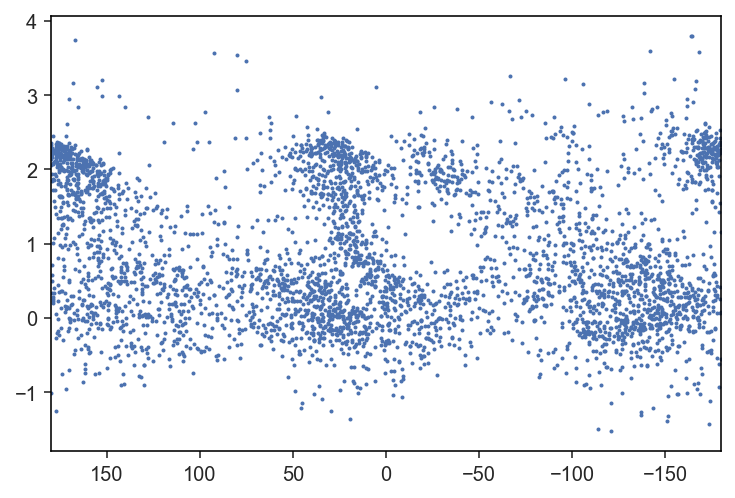

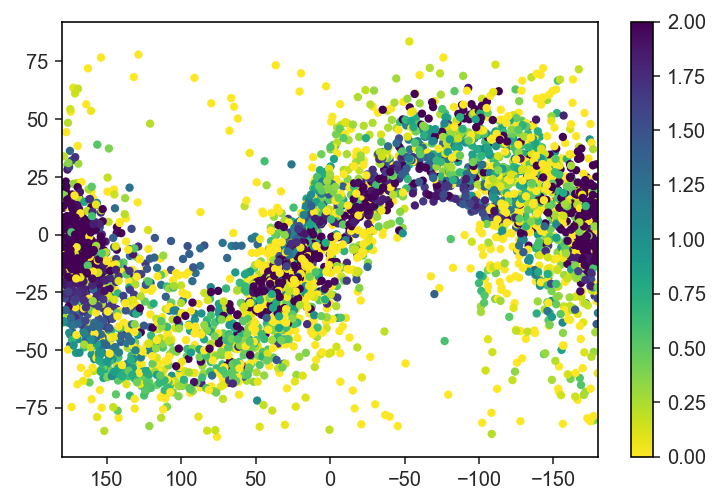

In [570]:
mask = (ge_165['R_gal']>30) & (ge_165['R_gal']<50)

cgal = coord.Galactic(ge_165['l_deg'], ge_165['b_deg'])

plt.scatter(cgal.l.wrap_at(180*u.deg)[mask],
            ge_165['Lz'][mask], s=1)
plt.xlim(180,-180)
plt.show()
#plt.ylim(-3, 3)

plt.scatter(cgal.l.wrap_at(180*u.deg)[mask],
            cgal.b[mask],
            c=ge_165['Lz'][mask], s=10,
           vmin=0, vmax=2, cmap="viridis_r")
plt.colorbar()
plt.xlim(180,-180)
plt.show()

In [551]:
ge_165['l_deg'][mask]

96.32884023355842
-129.04452266072684
108.9855811779546
-32.75715988118441
-19.604025178438008
38.0317918856274
4.343569913414882
-20.347003114348695
18.633241475172355
157.32145850976167
-15.32876969248531


In [184]:
np.mean(ge_165['R_gal']>25)

0.19184978026368357

In [171]:
np.mean(ge_165['Lz'])

0.16810870014031012

# Local halo

In [273]:
local = ge_165[ge_165['dist_adpt']<5]
w_local = gd.PhaseSpacePosition(pos=[local['X_gal_501'],local['Y_gal_501'],local['Z_gal_501']]*u.kpc,
                      vel=[local['Vx_gal_501'],local['Vy_gal_501'],local['Vz_gal_501']]*u.km/u.s)
orb_local = h3ify_utils.compute_orbit(w_local, gp.MilkyWayPotential(),
                          dt=1*u.Myr, t1=0*u.Gyr, t2=10*u.Gyr,)

local_zmax = orb_local.zmax()
local_rapo = orb_local.apocenter()

[ 5.  12.5 17.5 22.5 27.5 40. ] [ -83.56511578  -12.15537038  -28.51729334  138.67996426  855.32814116
 1319.66369707]


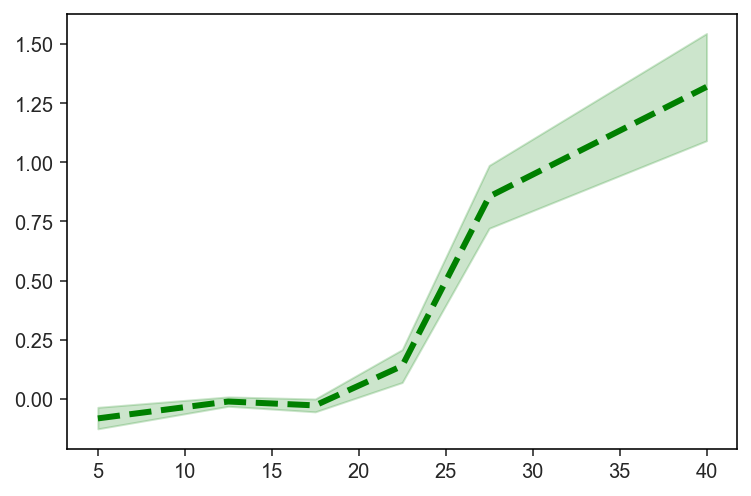

In [309]:
distarr1 = np.array([0,10,15,20,25,30]) 
distarr2 = np.array([10,15,20,25,30,50])

mean_lz = []
per16_lz = []
per84_lz = []
for dist1, dist2 in zip(distarr1, distarr2):
    mask = (local_rapo.value>dist1 ) & (local_rapo.value<dist2)
    
    mean_samples = weighted_bootstrap(local['Lz'][mask], 
                                      np.ones(np.count_nonzero(mask))*639,
                      np.mean, samples=1000)
    
    mean_lz.append(np.mean(mean_samples))
    per16_lz.append(np.percentile(mean_samples, 16) )
    per84_lz.append(np.percentile(mean_samples, 84) )
    

plt.plot( (distarr1+distarr2)/2,
        mean_lz,c="green", label="Fid. Model (H3)", lw=3, ls="--",)
print((distarr1+distarr2)/2, np.array(mean_lz)*1000)
plt.fill_between((distarr1+distarr2)/2, np.array(per16_lz),
                 np.array(per84_lz), color="green", alpha=0.2)

(-3, 3)

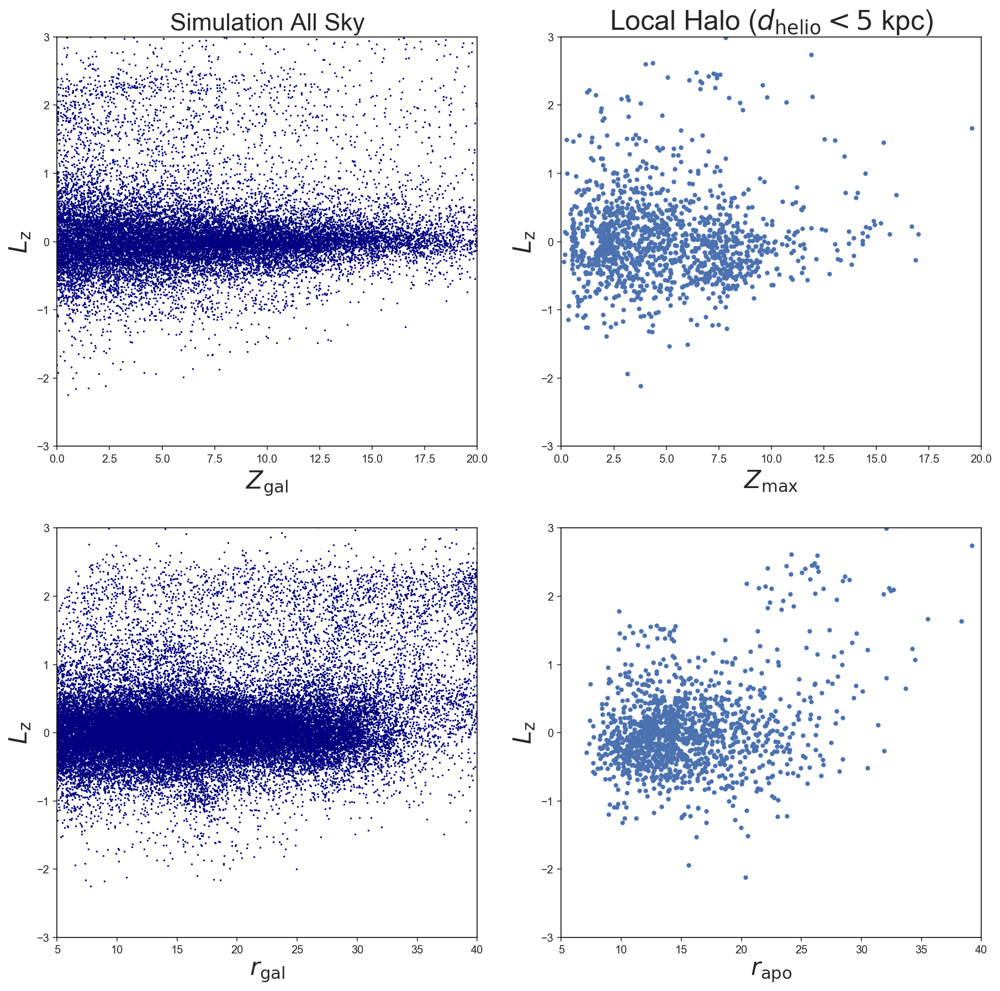

In [534]:
plt.subplots(2,2, figsize=(15,15))

plt.subplot(221)
plt.scatter(ge_165['Z_gal'], ge_165['Lz'], s=0.5,
           c="navy", rasterized=True)
plt.xlabel(r"$Z_{\rm{gal}}$", fontsize=22)
plt.ylabel(r"$L_{\rm{z}}$", fontsize=22)
plt.xlim(0, 20)
plt.ylim(-3,3)
plt.title("Simulation All Sky", fontsize=22)

plt.subplot(222)
plt.scatter(local_zmax, local['Lz'], s=10)
plt.xlabel(r"$Z_{\rm{max}}$", fontsize=22)
plt.ylabel(r"$L_{\rm{z}}$", fontsize=22)
plt.title(r"Local Halo ($d_{\rm{helio}}<5$ kpc)", fontsize=25)
plt.xlim(0, 20)
plt.ylim(-3,3)


plt.subplot(223)
plt.scatter(ge_165['R_gal'], ge_165['Lz'],  s=0.5,
           c="navy", rasterized=True)
plt.xlabel(r"$r_{\rm{gal}}$", fontsize=22)
plt.ylabel(r"$L_{\rm{z}}$", fontsize=22)
plt.xlim(5, 40)
plt.ylim(-3,3)

plt.subplot(224)
plt.scatter(local_rapo, local['Lz'], s=10)
plt.xlabel(r"$r_{\rm{apo}}$", fontsize=22)
plt.ylabel(r"$L_{\rm{z}}$", fontsize=22)
#plt.title(r"$d_{\rm{helio}}<5$ kpc", fontsize=25)
plt.xlim(5, 40)
plt.ylim(-3,3)
#plt.title(r"$d_{\rm{helio}}<5$ kpc", fontsize=25)

(-3, 3)

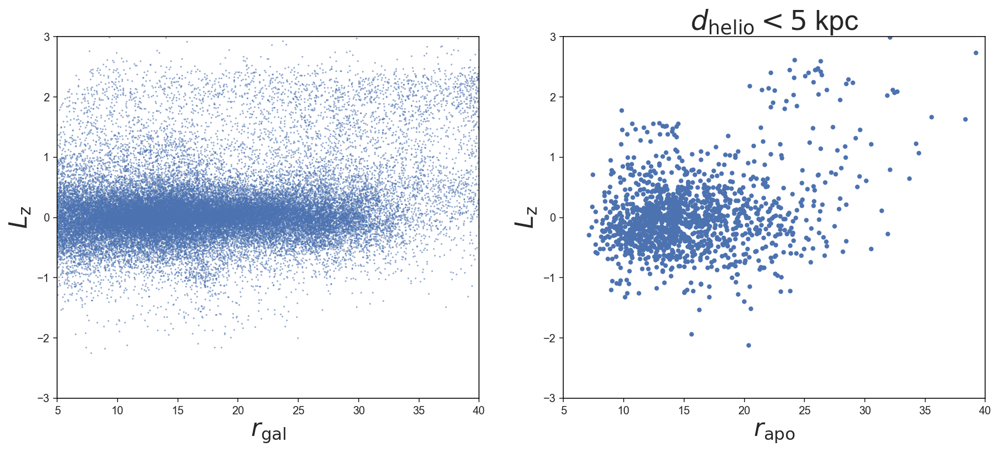

In [381]:
plt.subplots(1,2, figsize=(15,6))
plt.subplot(121)
plt.scatter(ge_165['R_gal'], ge_165['Lz'], s=0.1)
plt.xlabel(r"$r_{\rm{gal}}$", fontsize=22)
plt.ylabel(r"$L_{\rm{z}}$", fontsize=22)
plt.xlim(5, 40)
plt.ylim(-3,3)

plt.subplot(122)
plt.scatter(local_rapo, local['Lz'], s=10)
plt.xlabel(r"$r_{\rm{apo}}$", fontsize=22)
plt.ylabel(r"$L_{\rm{z}}$", fontsize=22)
plt.title(r"$d_{\rm{helio}}<5$ kpc", fontsize=25)
plt.xlim(5, 40)
plt.ylim(-3,3)
#plt.title(r"$d_{\rm{helio}}<5$ kpc", fontsize=25)

In [482]:
x_arr = []
y_arr = []
z_arr = []

for idx in range(501):
    x_arr.append(ge_165['X_gal_%s'%(idx+1)])
    y_arr.append(ge_165['Y_gal_%s'%(idx+1)])
    z_arr.append(ge_165['Z_gal_%s'%(idx+1)])
    
x_arr = np.array(x_arr)
y_arr = np.array(y_arr)
z_arr = np.array(z_arr)

(-30, 30)

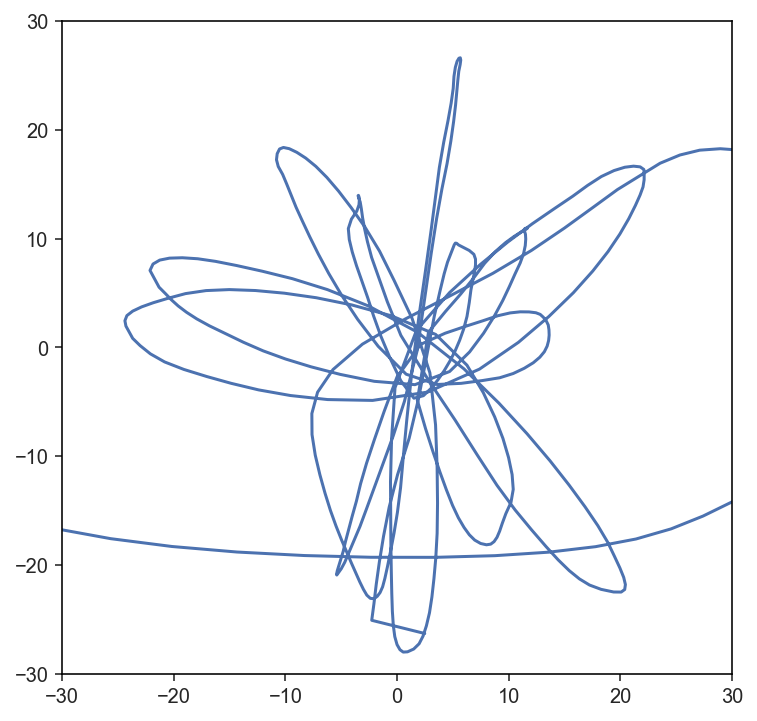

In [511]:
lim = 30
idx = 25
plt.figure(figsize=(6,6))
plt.plot(x_arr.T[idx], z_arr.T[idx])

plt.xlim(-lim, lim)
plt.ylim(-lim, lim)

In [472]:
mask = (ge_165['R_gal']>30) & (ge_165['R_gal']<50)  & (np.abs(ge_165['Lz'])<0.01/2)
print(np.count_nonzero(mask))

distant = ge_165[mask]

24


In [473]:
w_distant = gd.PhaseSpacePosition(pos=[distant['X_gal_501'],distant['Y_gal_501'],distant['Z_gal_501']]*u.kpc,
                      vel=[distant['Vx_gal_501'],distant['Vy_gal_501'],distant['Vz_gal_501']]*u.km/u.s)
orb_distant = h3ify_utils.compute_orbit(w_distant, gp.MilkyWayPotential(),
                          dt=1*u.Myr, t1=0*u.Gyr, t2=10*u.Gyr,)

#distant_zmax = orb_distant.zmax()
#distant_rapo = orb_distant.apocenter()

In [480]:
orb_distant[:,0].shape

(10000,)

/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/gala/dynamics/plot.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  **subplots_kwargs)


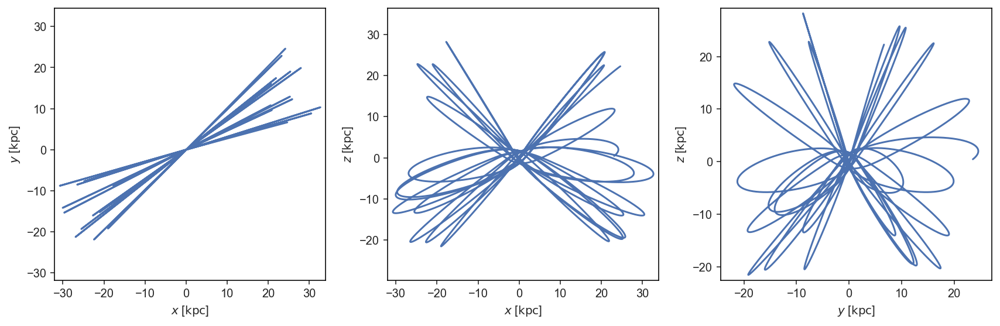

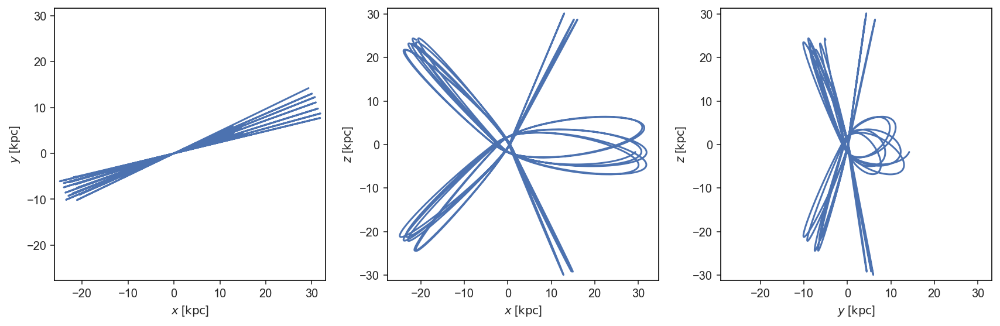

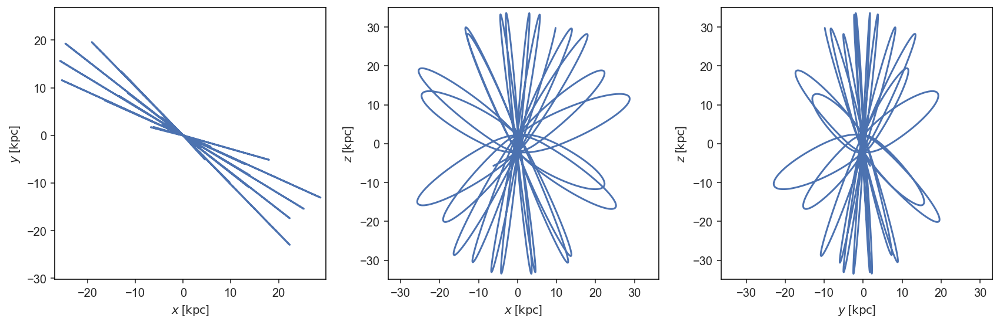

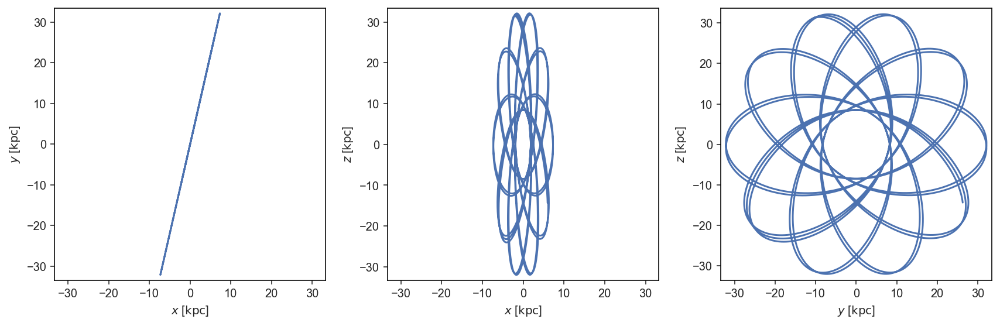

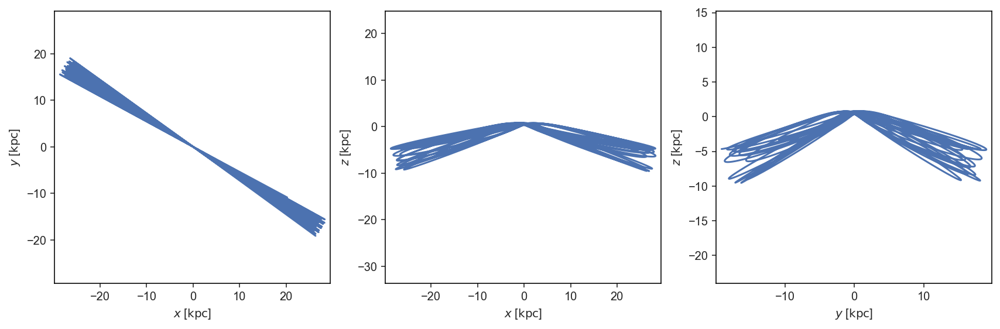

...

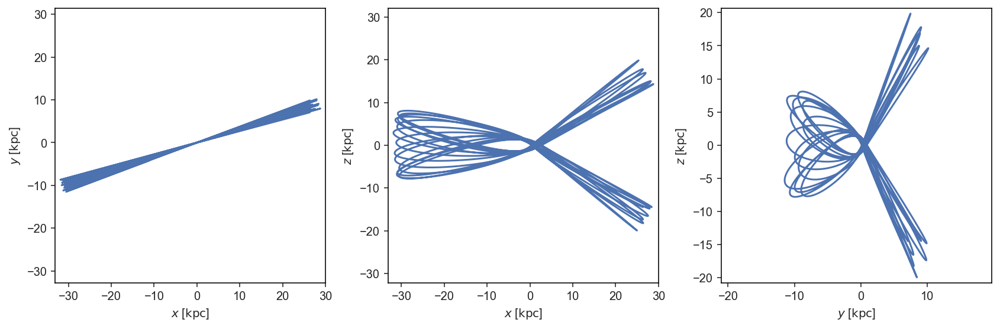

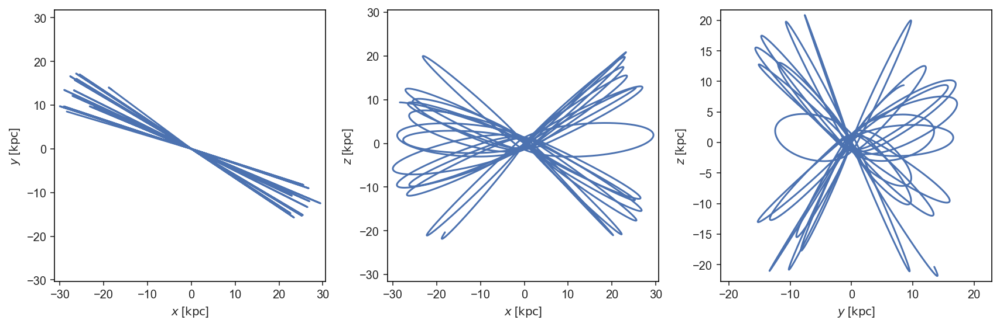

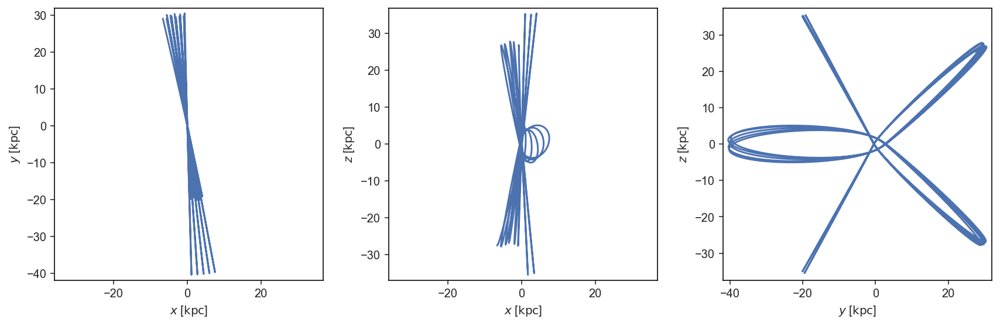

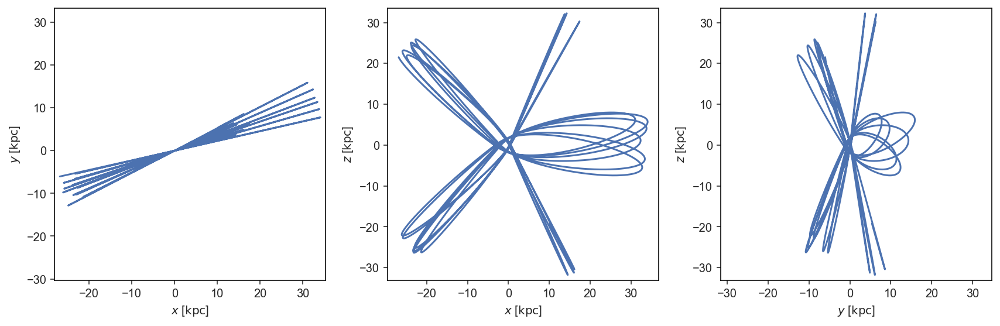

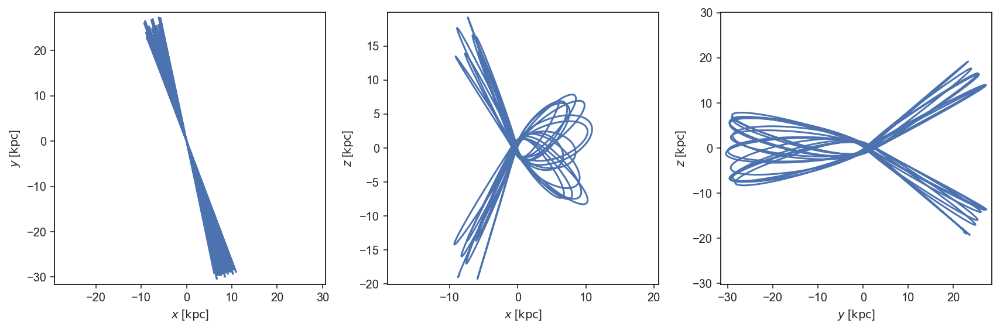

In [479]:
for idx in np.arange(np.count_nonzero(mask)):
    orb_distant[:,idx].plot()

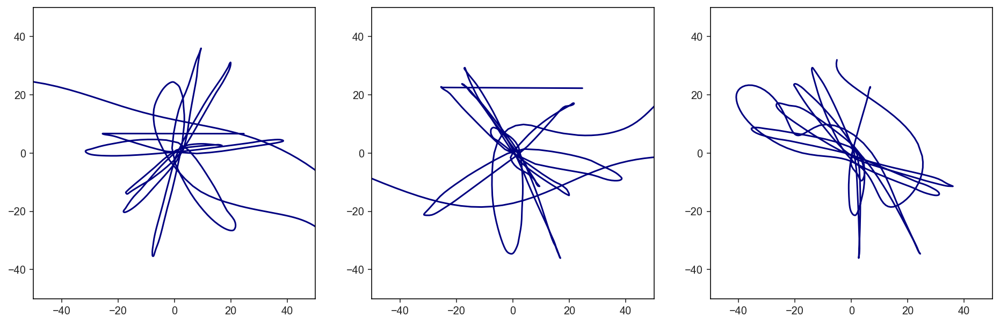

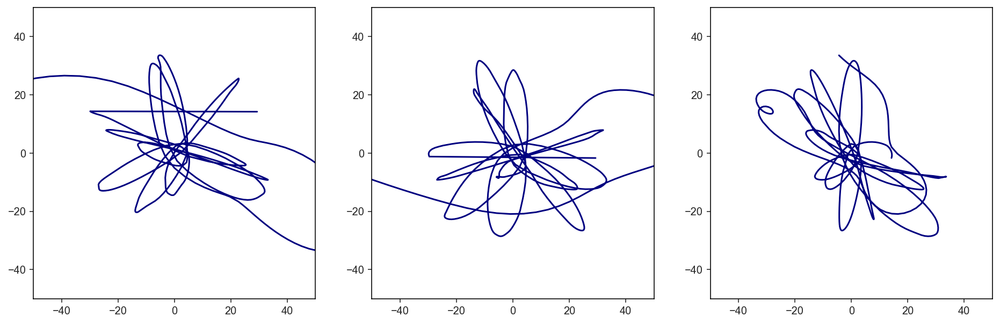

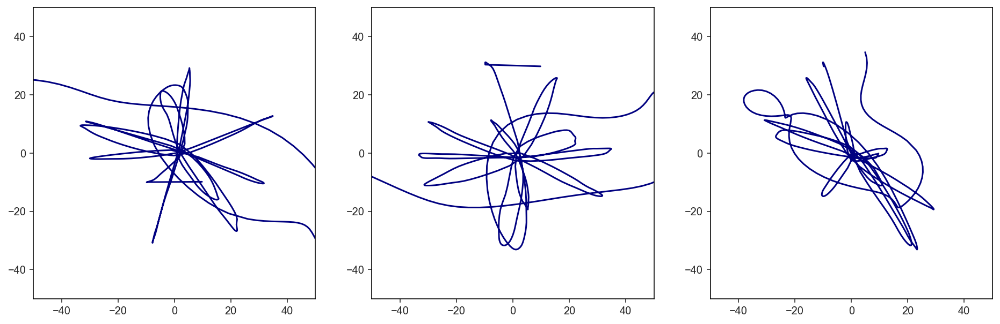

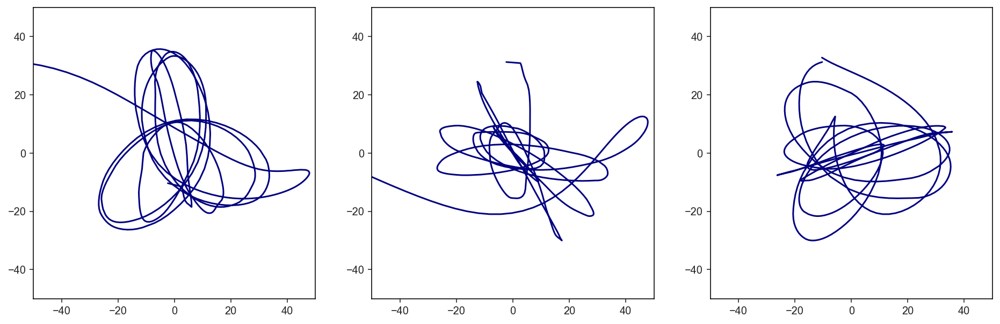

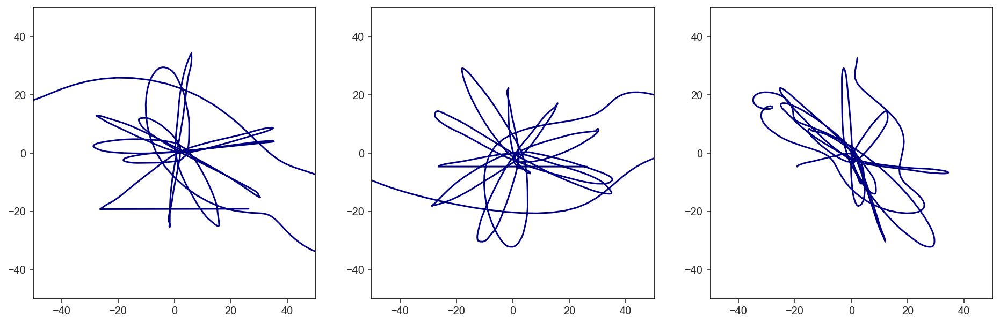

...

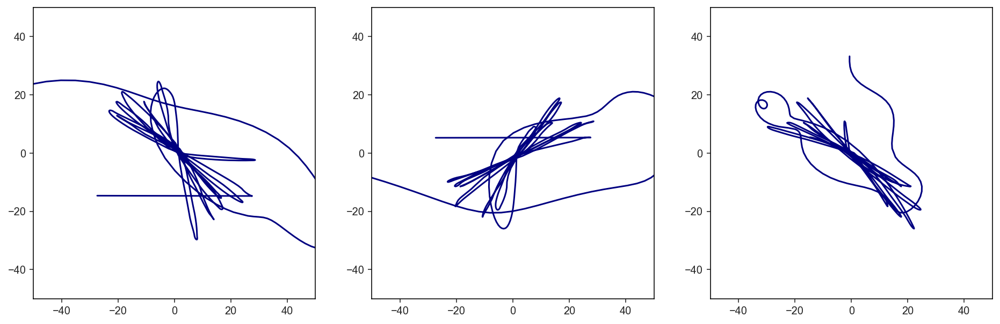

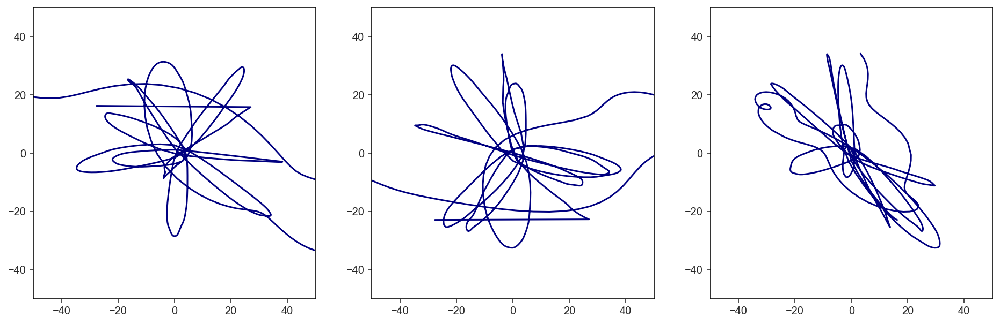

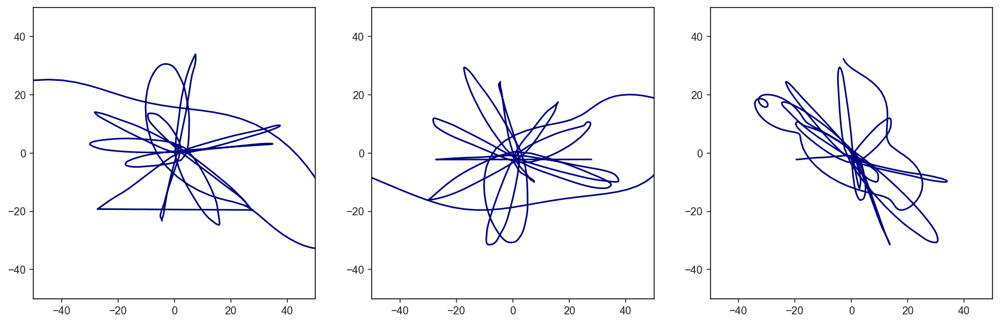

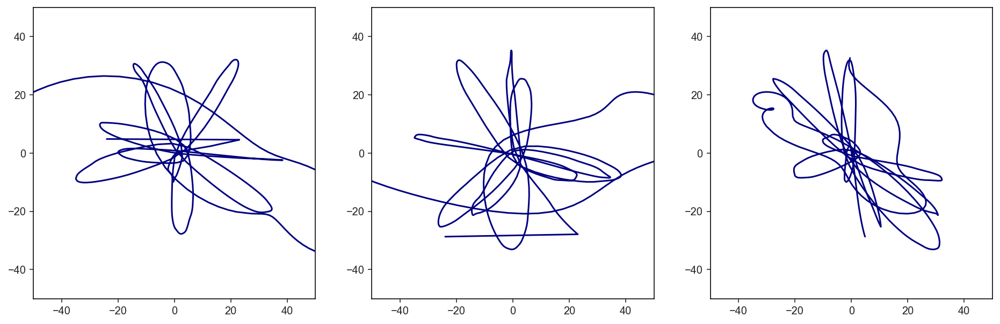

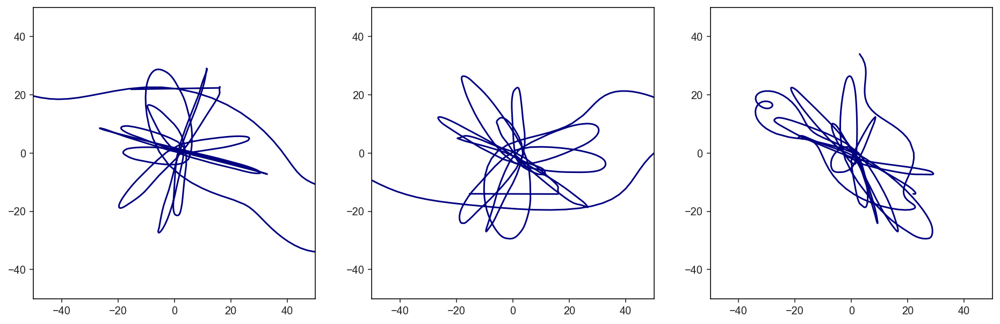

In [513]:
lim = 50
for idx in range(14):
    plt.subplots(1,3, figsize=(16,5))
    
    plt.subplot(131)
    plt.plot( (((x_arr.T)[mask]).T)[:,idx],
             (((y_arr.T)[mask]).T)[:,idx],c="navy")
    plt.xlim(-lim, lim)
    plt.ylim(-lim, lim)
    
    plt.subplot(132)
    plt.plot( (((x_arr.T)[mask]).T)[:,idx],
             (((z_arr.T)[mask]).T)[:,idx],c="navy")
    plt.xlim(-lim, lim)
    plt.ylim(-lim, lim)
    
    plt.subplot(133)    
    plt.plot( (((y_arr.T)[mask]).T)[:,idx],
             (((z_arr.T)[mask]).T)[:,idx],c="navy")
    plt.xlim(-lim, lim)
    plt.ylim(-lim, lim)
   
    #circle1 = plt.Circle((-8, 0), 5, color='r', fill=False, lw=2)
    #plt.gca().add_patch(circle1)
    plt.show()

array([[-125.769104 , -121.917244 , -122.560555 , -126.42258  ],
       [-124.52702  , -119.631325 , -121.7608   , -124.94405  ],
       [-122.98913  , -117.6262   , -121.047226 , -123.07721  ],
       ...,
       [  24.794052 ,   -2.270279 ,   22.317398 ,   -6.551895 ],
       [  25.065186 ,   -2.2319489,   23.840088 ,   -6.3683624],
       [ -25.056992 ,    2.2146454,  -25.036453 ,    6.156601 ]],
      dtype=float32)

Text(0, 0.5, '$L_{\\rm{z}}$')

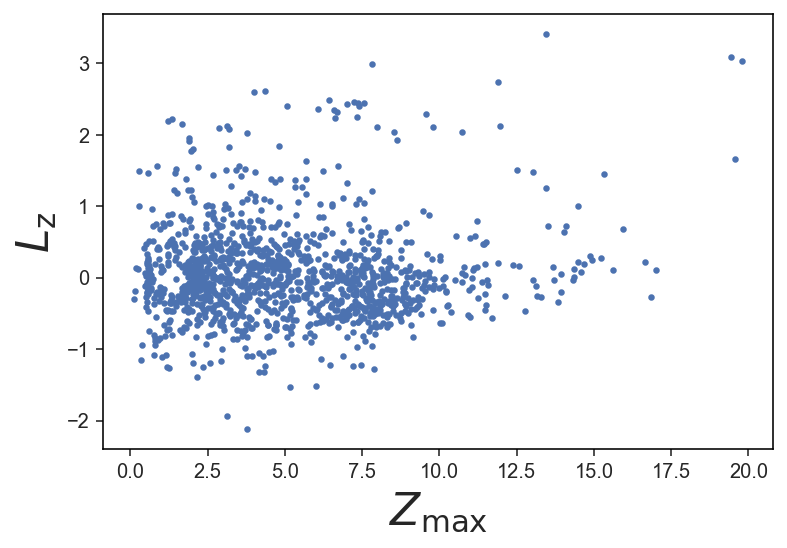

In [284]:
plt.scatter(local_zmax, local['Lz'], s=5)
plt.xlabel(r"$Z_{\rm{max}}$", fontsize=22)
plt.ylabel(r"$L_{\rm{z}}$", fontsize=22)

In [373]:
np.count_nonzero(ge_165['h3_mask'])/2801

3.9425205283827203

In [476]:
np.mean(ge_165['R_gal']<25)

0.8081502197363164

In [303]:
def track_lz(ge):

    lz =[]
    for indx in range(500):
        idx = indx+1
        w = gd.PhaseSpacePosition(pos=[ge['X_gal_%s'%idx], ge['Y_gal_%s'%idx], ge['Z_gal_%s'%idx]]*u.kpc, 
                      vel=[ge['Vx_gal_%s'%idx], ge['Vy_gal_%s'%idx], ge['Z_gal_%s'%idx]]*u.km/u.s )
        lz.append(w.angular_momentum()[2]/1e+3)
            
    lz = np.array(lz)
    
    return lz

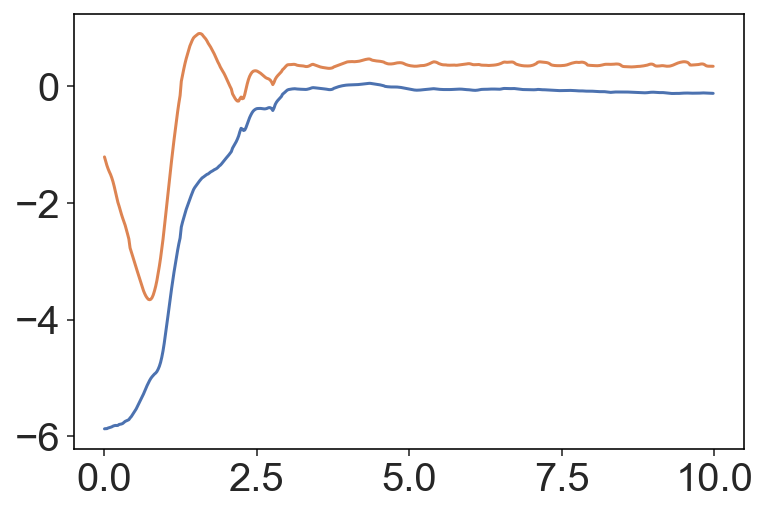

In [407]:
plt.plot(np.arange(500)/50, np.mean(track_lz(ge_165), axis=1))

plt.plot(np.arange(500)/50,np.mean(track_lz(ge_165), axis=1)+ np.std(track_lz(ge_165), axis=1))

#plt.plot(np.arange(500)/50, np.percentile(track_lz(ge_165), axis=1,q=16))
#plt.plot(np.arange(500)/50, np.percentile(track_lz(ge_165), axis=1,q=84))

In [606]:
distarr1 = np.array([0,10,20,30]) 
distarr2 = np.array([10,20,30,50])
mean_lz = []

for dist1, dist2 in zip(distarr1, distarr2):
    
    mask = rc_mask & (rcat['R_gal']>dist1 ) & (rcat['R_gal']<dist2)
    
    mean_lz.append(weighted_bootstrap(rcat['Lz'][mask], rcat['mag_weights'][mask],
                      np.mean, samples=1000))

mean_lz = np.array(mean_lz)


In [607]:
mean_lz*1000

array([[ 53.74320502, 150.68982105,  93.71156102, ...,  64.50540174,
        120.37280331,  92.59553986],
       [ 80.93089373,  38.15381834,  60.68697536, ...,  63.13989367,
         26.55894297,  72.56789349],
       [ 44.81353728,  55.48852614,  37.87352998, ..., 105.47512829,
        131.06641049, 102.04467243],
       [397.08174119,  83.79325674, 798.66917894, ..., 510.48642757,
        224.60127539, 678.98253472]])

In [618]:
np.percentile(mean_lz, axis=1, q=50)*1000 - np.percentile(mean_lz, axis=1, q=16)*1000

array([ 28.93236569,  16.8676564 ,  37.18045297, 199.71812553])

In [617]:
np.percentile(mean_lz, axis=1, q=50)*1000

array([ 90.79082271,  63.14724559,  86.04204461, 338.98414084])

In [619]:
np.percentile(mean_lz, axis=1, q=84)*1000 - np.percentile(mean_lz, axis=1, q=50)*1000

array([ 26.56604523,  17.50179144,  37.14710555, 229.08073106])

# Omega-Cen

In [27]:
inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_165.pickle", "rb"))
ge_inp = hstack(inp)
ge_165_new = read_file(ge_inp, 425)

In [10]:
inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_165.pickle", "rb"))
ge_inp = hstack(inp)
ge_165 = read_file(ge_inp, 501)

In [27]:
plt.colorbar?

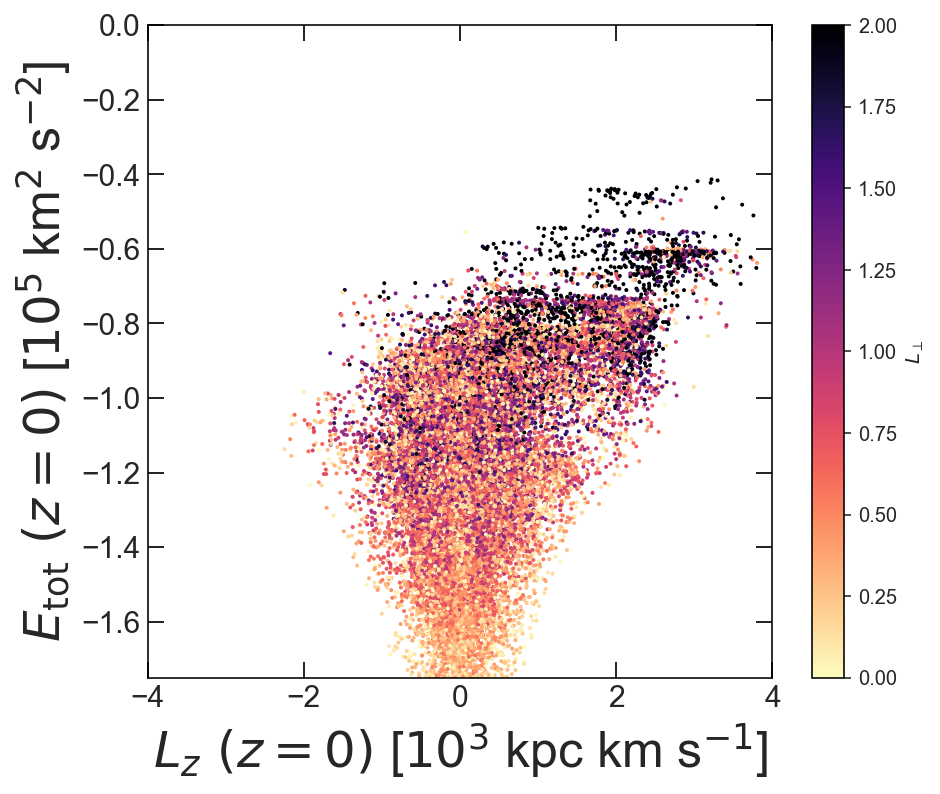

In [32]:
plt.figure(figsize=(7,6))
plt.scatter(ge_165['Lz'], ge_165['E_tot_pot1'], s=1,
           c= (ge_165['Lx']**2 + ge_165['Ly']**2)**0.5,
           vmin=0, vmax=2, cmap="magma_r")
plt.xlim(-4, 4)
plt.ylim(-1.75, 0)
plt.colorbar(label=r"$L_{\rm{\perp}}$")

plt.ylabel(r"$E_{\mathrm{tot}}\ (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=25)
plt.xlabel(r"$L_{z}\ (z=0)$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=25)

plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")

In [14]:
inp = pickle.load(open("./snaps/GEM1UMresize_disk_129_129_50_pro_165.pickle","rb"))
ge_inp = hstack(inp)
ge_165_old = read_file(ge_inp, 444)

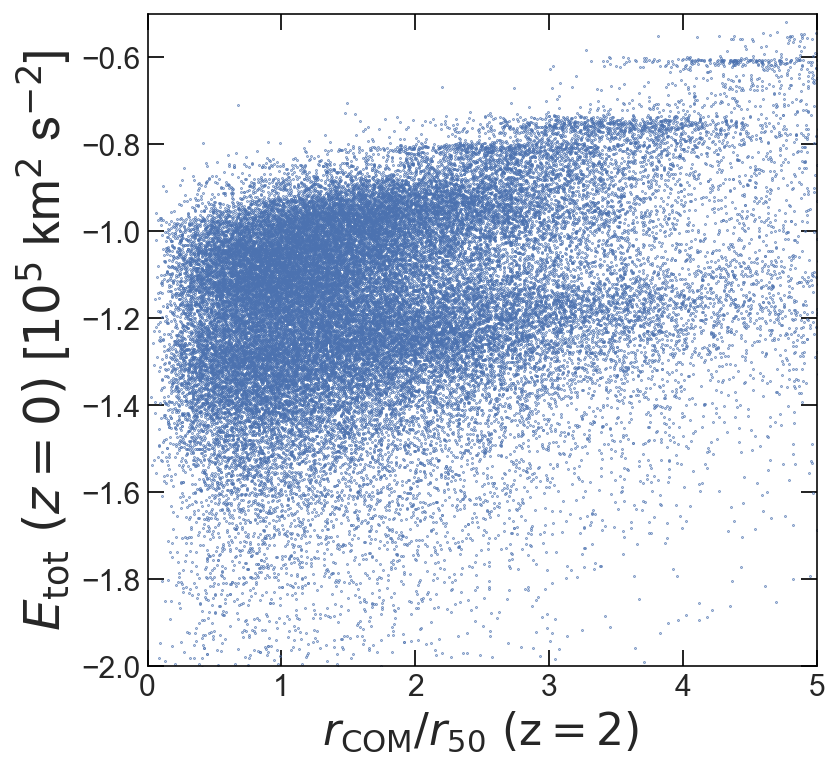

In [61]:
plt.figure(figsize=(6,6))
plt.scatter(ge_165['R_com_0']/1.75, ge_165['E_tot_pot1'], s=0.1)
#plt.xscale("log")
#plt.xlim(10**-1, 10**1.2)
plt.xlim(0, 5)
plt.ylim(-2, -0.5)
plt.xlabel(r"$r_{\rm{COM}}/r_{\rm{50}}\ \rm{(z=2)}$ ", fontsize=22)
plt.ylabel(r"$E_{\mathrm{tot}}\ (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=25)

plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")


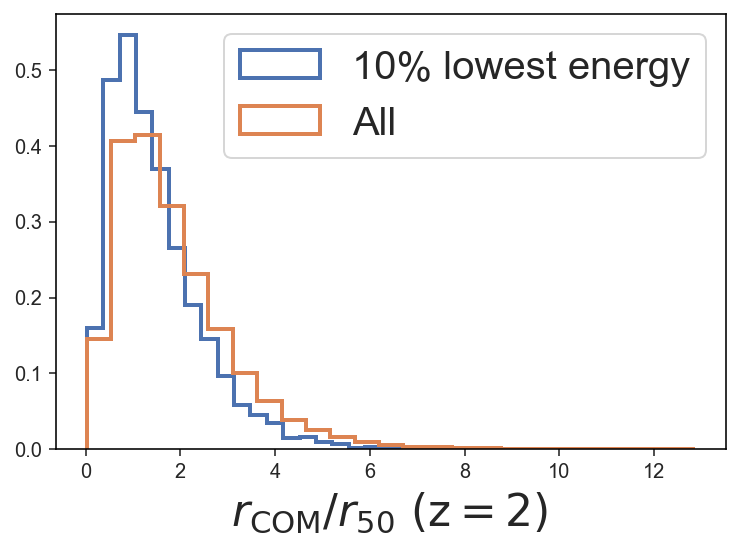

In [73]:
mask = (ge_165['E_tot_pot1'] < np.percentile(ge_165_old['E_tot_pot1'], 10))
plt.hist(ge_165['R_com_0'][mask]/1.75, histtype="step", lw=2, bins=25, density=True,
        label="10% lowest energy")
plt.hist(ge_165['R_com_0']/1.75, histtype="step", lw=2, bins=25, density=True,
        label="All")
#plt.title("10% lowest energy stars", fontsize=22)
plt.xlabel(r"$r_{\rm{COM}}/r_{\rm{50}}\ \rm{(z=2)}$ ", fontsize=22)
plt.legend(fontsize=20)
#plt.xscale("log")

(array([  11.,   11.,    8.,   18.,   17.,    6.,   17.,   21.,   33.,
          20.,   27.,   39.,   42.,   35.,   49.,   61.,   59.,   93.,
         106.,  111.,  121.,  170.,  194.,  243.,  278.,  334.,  374.,
         480.,  595.,  698.,  904., 1083., 1271., 1490., 1663., 2076.,
        2329., 2561., 2803., 3017., 2969., 2836., 2516., 2080., 1809.,
        1539., 1303., 1048.,  851.,  771.,  657.,  577.,  503.,  454.,
         412.,  367.,  286.,  266.,  262.,  241.,  245.,  253.,  213.,
         257.,  221.,  201.,  220.,  244.,  203.,  199.,  209.,  194.,
         162.,  174.,  185.,  177.,  200.,  193.,  217.,  159.]),
 array([-2.  , -1.95, -1.9 , -1.85, -1.8 , -1.75, -1.7 , -1.65, -1.6 ,
        -1.55, -1.5 , -1.45, -1.4 , -1.35, -1.3 , -1.25, -1.2 , -1.15,
        -1.1 , -1.05, -1.  , -0.95, -0.9 , -0.85, -0.8 , -0.75, -0.7 ,
        -0.65, -0.6 , -0.55, -0.5 , -0.45, -0.4 , -0.35, -0.3 , -0.25,
        -0.2 , -0.15, -0.1 , -0.05,  0.  ,  0.05,  0.1 ,  0.15,  0.2 ,
         0.

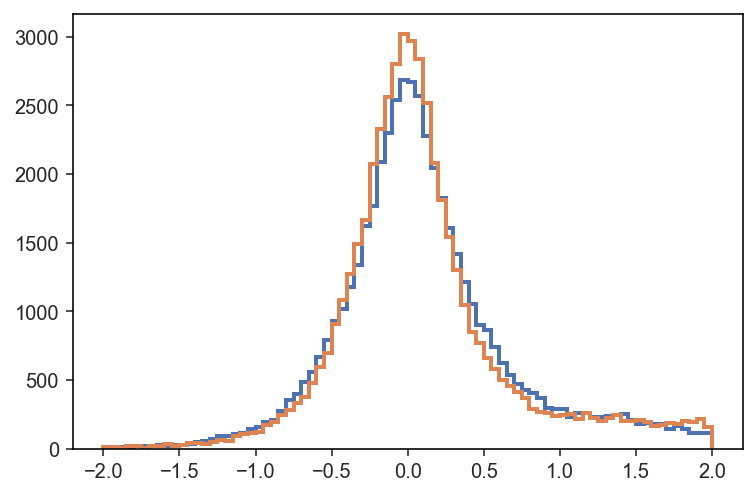

In [240]:
plt.hist(ge_165_old['Lz'], histtype="step", lw=2, range=(-2, 2), bins=80)
plt.hist(ge_165_new['Lz'], histtype="step", lw=2, range=(-2, 2), bins=80)

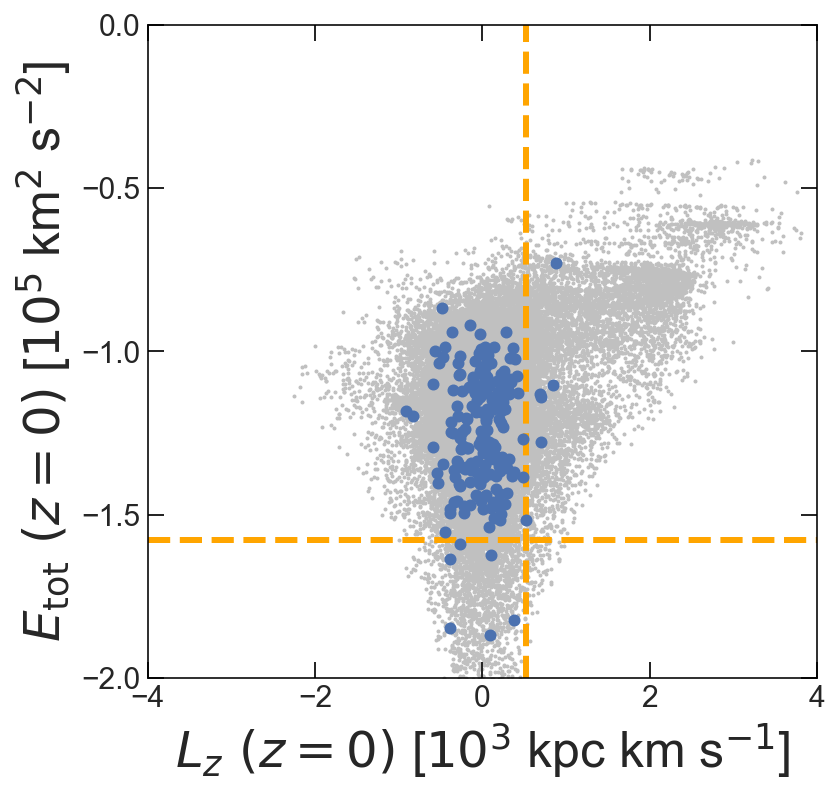

In [35]:
plt.figure(figsize=(6, 6))
plt.scatter(ge_165['Lz'], ge_165['E_tot_pot1'], s=1, c="silver", label="All Particles", zorder=0)

plt.xlim(-4, 4)
plt.ylim(-2,0)
plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)

plt.ylabel(r"$E_{\mathrm{tot}}\ (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=25)
plt.xlabel(r"$L_{z}\ (z=0)$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=25)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")


plt.axvline(0.522704488384978, ls="--", c="orange", lw=3, zorder=1)
plt.axhline(-1.579262, ls="--", c="orange", lw=3, label="Omega Cen", zorder=1)


plt.scatter(ge_165_new['Lz'][ge_165_new['R_com_0']<0.3], 
            ge_165_new['E_tot_pot1'][ge_165_new['R_com_0']<0.3], s=25,
           label=r"$r_{\rm{gal}}$ (pre-merger)<0.3 kpc", zorder=2)

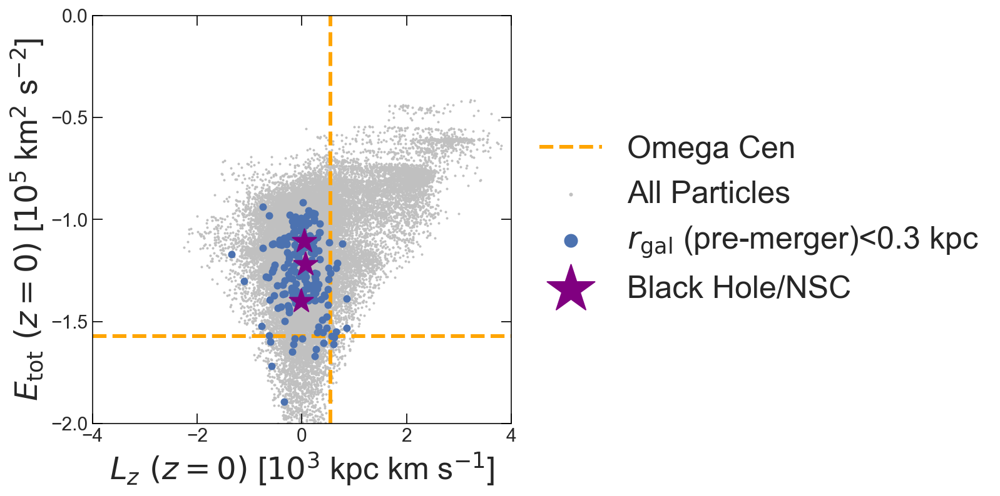

In [244]:
plt.figure(figsize=(6, 6))
plt.scatter(ge_165['Lz'], ge_165['E_tot_pot1'], s=1, c="silver", label="All Particles", zorder=0)

plt.xlim(-4, 4)
plt.ylim(-2,0)
plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")

plt.ylabel(r"$E_{\mathrm{tot}}\ (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=25)
plt.xlabel(r"$L_{z}\ (z=0)$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=25)


plt.axvline(0.5399593186091586, ls="--", c="orange", lw=3, zorder=1)
plt.axhline(-1.572801532672325, ls="--", c="orange", lw=3, label="Omega Cen", zorder=1)


plt.scatter(ge_165_old['Lz'][ge_165_old['R_com_0']<0.3], 
            ge_165_old['E_tot_pot1'][ge_165_old['R_com_0']<0.3], s=25,
           label=r"$r_{\rm{gal}}$ (pre-merger)<0.3 kpc", zorder=2)

bh_lz = [-0.019538054001517594, 0.06510290137305856, 0.041313477263749517]
bh_etot = [-1.3988276426919888, -1.220435734064102, -1.1047000355376249]

plt.scatter(bh_lz,bh_etot, s=400, marker="*",
           zorder=3, label="Black Hole/NSC", color="purple")

plt.legend(fontsize=25, loc="center left", markerscale=2, frameon=False, 
          bbox_to_anchor=(1, 0.5))

In [ ]:
pot = gp.MilkyWayPotential()
w = gd.PhaseSpacePosition(pos=[ge_165['X_gal_501'], 
                               ge_165['Y_gal_501'], 
                               ge_165['Z_gal_501']]*u.kpc, 
                          vel=[ge_165['Vx_gal_501'],
                               ge_165['Vy_gal_501'],
                               ge_165['Vz_gal_501']]*u.km/u.s )
orb = pot.integrate_orbit(w, dt=5*u.Myr, t1=0*u.Myr, t2=5*u.Gyr, 
                          Integrator=gi.DOPRI853Integrator)

784


(array([0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.00398597,
        0.02391582, 0.56202168, 1.91326531, 0.59789541, 0.02391582,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ]),
 array([-4.  , -3.68, -3.36, -3.04, -2.72, -2.4 , -2.08, -1.76, -1.44,
        -1.12, -0.8 , -0.48, -0.16,  0.16,  0.48,  0.8 ,  1.12,  1.44,
         1.76,  2.08,  2.4 ,  2.72,  3.04,  3.36,  3.68,  4.  ]),
 <a list of 1 Patch objects>)

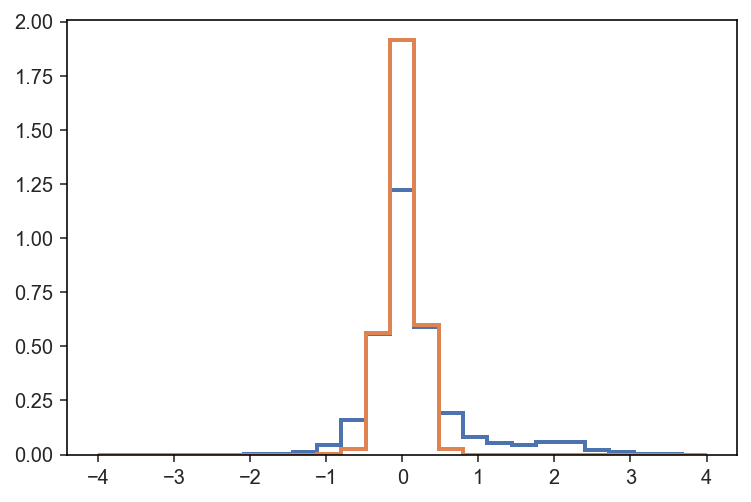

In [251]:
mask = (ge_165['R_com_0']<0.5)
print(np.count_nonzero(mask))
plt.hist(ge_165['Lz'], histtype="step", 
         lw=2, range=(-4, 4), bins=25, density=True)

plt.hist(ge_165['Lz'][mask], histtype="step", 
         lw=2, range=(-4, 4), bins=25, density=True)

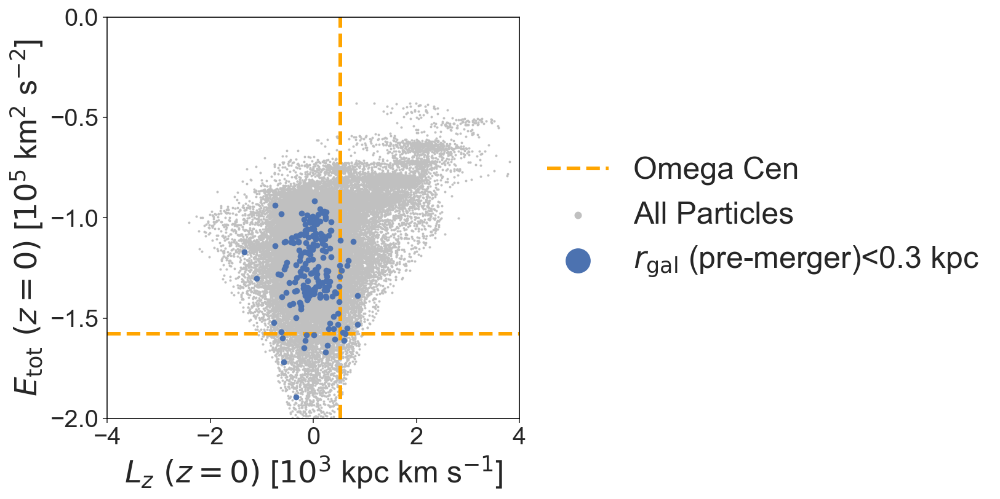

In [565]:
plt.figure(figsize=(6, 6))
plt.scatter(ge_165_old['Lz'], ge_165_old['E_tot_pot1'], s=1, c="silver", label="All Particles", zorder=0)

plt.xlim(-4, 4)
plt.ylim(-2,0)
plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)

plt.ylabel(r"$E_{\mathrm{tot}}\ (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=25)
plt.xlabel(r"$L_{z}\ (z=0)$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=25)


plt.axvline(0.522704488384978, ls="--", c="orange", lw=3, zorder=1)
plt.axhline(-1.579262, ls="--", c="orange", lw=3, label="Omega Cen", zorder=1)


plt.scatter(ge_165_old['Lz'][ge_165_old['R_com_0']<0.3], 
            ge_165_old['E_tot_pot1'][ge_165_old['R_com_0']<0.3], s=15,
           label=r"$r_{\rm{gal}}$ (pre-merger)<0.3 kpc", zorder=2)

plt.legend(fontsize=25, loc="center left", markerscale=5, frameon=False, 
          bbox_to_anchor=(1, 0.5))

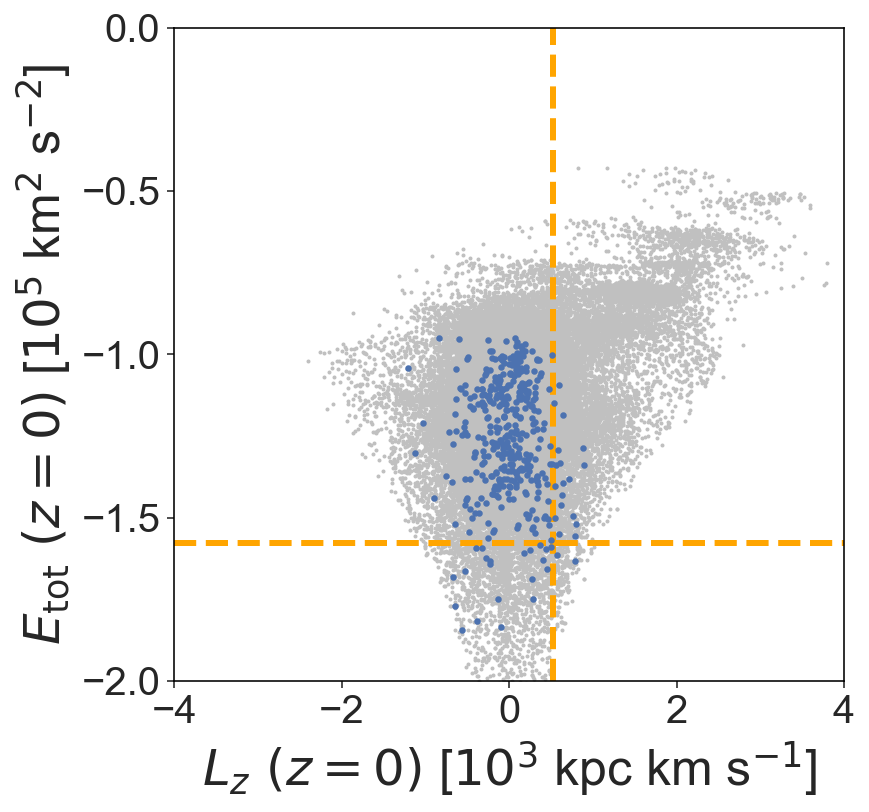

In [564]:
plt.figure(figsize=(6, 6))
plt.scatter(ge_165_new['Lz'], ge_165_new['E_tot_pot1'], s=1, c="silver", label="All Particles", zorder=0)

plt.xlim(-4, 4)
plt.ylim(-2,0)
plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)

plt.ylabel(r"$E_{\mathrm{tot}}\ (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=25)
plt.xlabel(r"$L_{z}\ (z=0)$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=25)


plt.axvline(0.522704488384978, ls="--", c="orange", lw=3, zorder=1)
plt.axhline(-1.579262, ls="--", c="orange", lw=3, label="Omega Cen", zorder=1)


mask = (ge_165_new['R_com_0']<0.4)
plt.scatter(ge_165_new['Lz'][mask], 
            ge_165_new['E_tot_pot1'][mask], s=5,
           label=r"$r_{\rm{gal}}$ (pre-merger)<0.3 kpc", zorder=2)

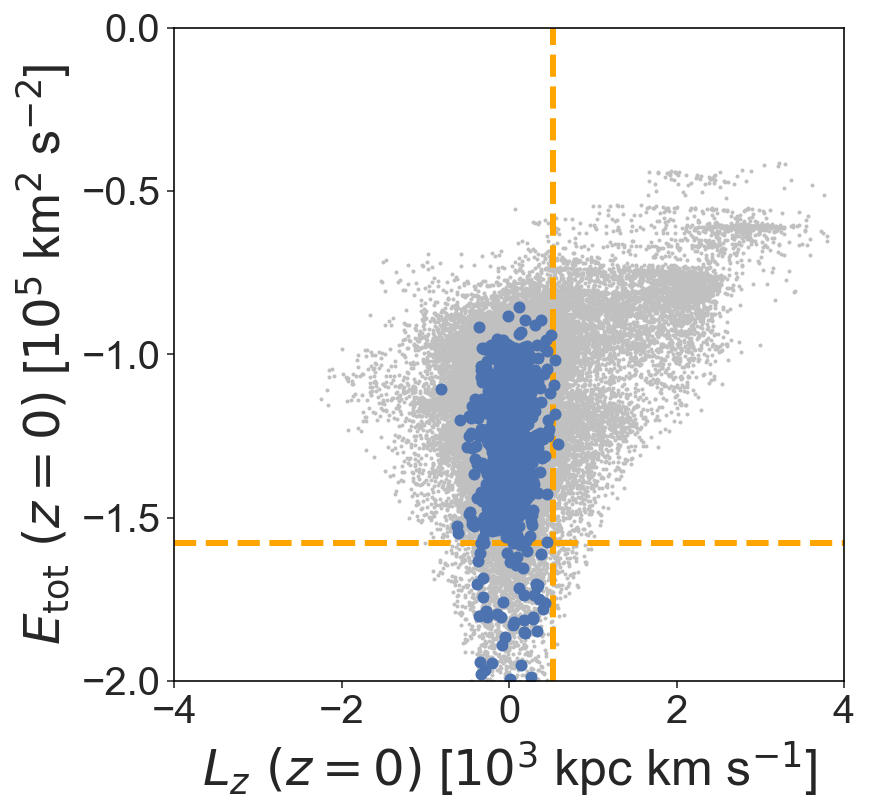

In [561]:
plt.figure(figsize=(6, 6))
plt.scatter(ge_165['Lz'], ge_165['E_tot_pot1'], s=1, c="silver", label="All Particles", zorder=0)

plt.xlim(-4, 4)
plt.ylim(-2,0)
plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)

plt.ylabel(r"$E_{\mathrm{tot}}\ (z=0)$ [$10^{5}$ km$^{2}$ s$^{-2}$]", fontsize=25)
plt.xlabel(r"$L_{z}\ (z=0)$ [$10^{3}$ kpc km s$^{-1}$]", fontsize=25)


plt.axvline(0.522704488384978, ls="--", c="orange", lw=3, zorder=1)
plt.axhline(-1.579262, ls="--", c="orange", lw=3, label="Omega Cen", zorder=1)


mask = (ge_165['R_com_0']<0.5)
plt.scatter(ge_165['Lz'][mask], 
            ge_165['E_tot_pot1'][mask], s=25,
           label=r"$r_{\rm{gal}}$ (pre-merger)<0.3 kpc", zorder=2)

(array([7.600e+02, 2.976e+03, 4.808e+03, 5.637e+03, 5.525e+03, 5.142e+03,
        4.525e+03, 3.728e+03, 3.209e+03, 2.734e+03, 2.266e+03, 1.798e+03,
        1.412e+03, 1.185e+03, 9.490e+02, 6.940e+02, 5.430e+02, 4.590e+02,
        3.980e+02, 2.610e+02, 2.290e+02, 1.910e+02, 1.390e+02, 1.010e+02,
        7.800e+01, 7.200e+01, 4.500e+01, 4.200e+01, 3.000e+01, 3.000e+01,
        2.900e+01, 1.000e+01, 9.000e+00, 1.300e+01, 7.000e+00, 4.000e+00,
        7.000e+00, 8.000e+00, 2.000e+00, 1.000e+00, 2.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00]),
 array([ 0.04281007,  0.49234277,  0.94187546,  1.3914082 ,  1.840941  ,
         2.2904737 ,  2.7400062 ,  3.189539  ,  3.6390717 ,  4.0886045 ,
         4.538137  ,  4.98767   ,  5.4372025 ,  5.8867354 ,  6.336268  ,
         6.7858005 ,  7.2353334 ,  7.684866  ,  8.134398  ,  8.583932  ,
         9.033464  ,  9.482997  ,  9.932529  , 10.382062  , 10.831595  ,
        11.

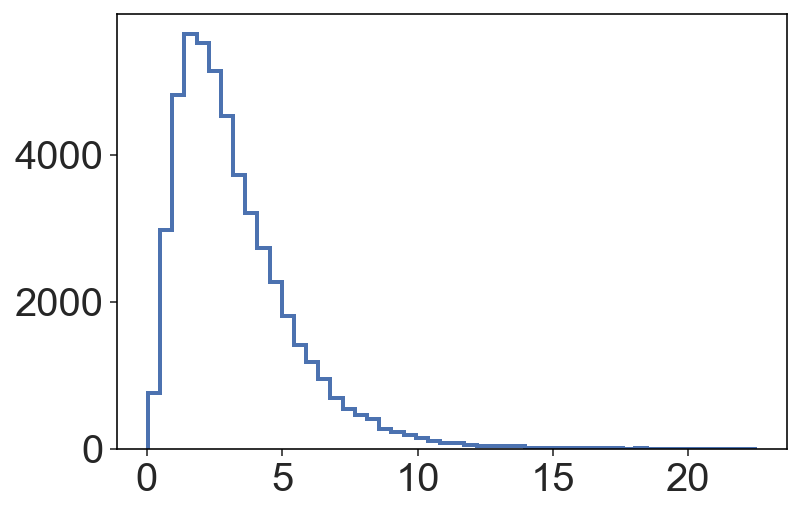

In [553]:
plt.hist(ge_165_new['R_com_0'], histtype="step", lw=2, bins=50)

# HAC, VOD timeseries and relative densities

In [584]:
hac_mask =  (ge_165['Z_gal_501']<-25) & (ge_165['Z_gal_501']>-30)
print(np.count_nonzero(hac_mask))

z_arr = []
vz_arr = []
for x in range(501):
    z_arr.append(ge_165['Z_gal_%s'%(x+1)][hac_mask])
    vz_arr.append(ge_165['Vz_gal_%s'%(x+1)][hac_mask])
    
z_arr = np.array(z_arr).T
vz_arr = np.array(vz_arr).T

497


In [711]:
hac_frac = []
vod_frac = []
for x in range(501):
    #hac_frac.append(np.mean((ge_165['Z_gal_%s'%(x+1)]<-10) & (ge_165['Z_gal_%s'%(x+1)]>-30) ))
    #vod_frac.append(np.mean((ge_165['Z_gal_%s'%(x+1)]<30) & (ge_165['Z_gal_%s'%(x+1)]>10)))
    
    hac_frac.append(np.mean((ge_165['Z_gal_%s'%(x+1)]<0)))
    vod_frac.append(np.mean((ge_165['Z_gal_%s'%(x+1)]>0)))


hac_frac = np.array(hac_frac)
vod_frac = np.array(vod_frac)
#z_arr = np.array(z_arr).T
#vz_arr = np.array(vz_arr).T

In [712]:
(hac_frac/vod_frac)[-1]

/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in true_divide
  """Entry point for launching an IPython kernel.


1.4163730269826713

(0, 10.5)

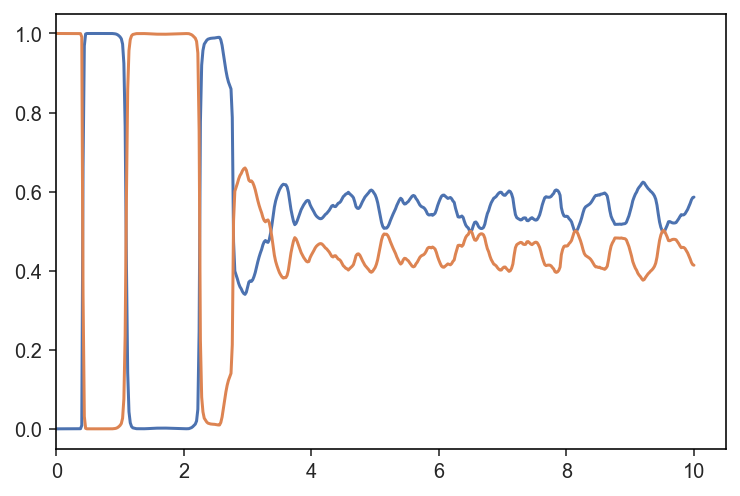

In [713]:
plt.plot(np.arange(501)/50, hac_frac )
plt.plot(np.arange(501)/50, vod_frac )
plt.xlim(0,)
#plt.ylim(0.4,0.7)
#plt.yscale("log")

NameError: name 'lmc' is not defined

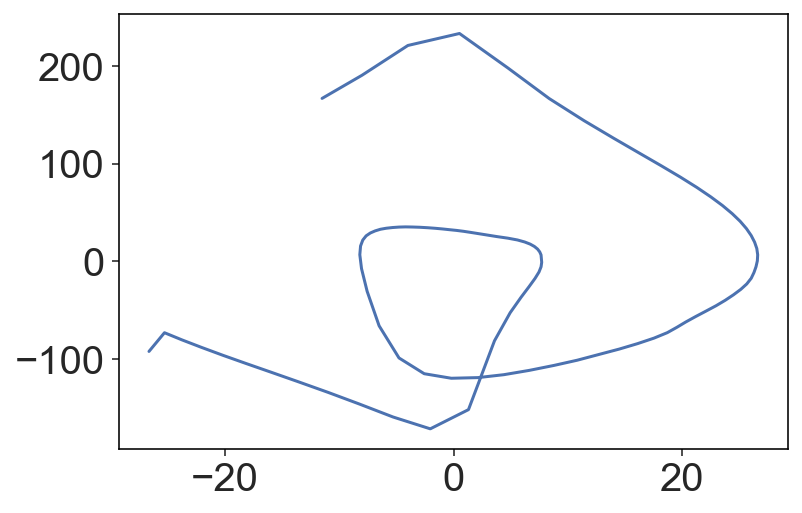

In [588]:
plt.plot(z_arr[20][400::], vz_arr[20][400::])

In [590]:
len(z_arr[20])

501

In [591]:
rcat

starname,tileID,selID,dateID,fibID,redID,pipeID,H3_ID,TMASS_ID,GAIADR2_ID,UNWISE_ID,RA,DEC,RA_S,DEC_S,GAIADR2_RA,GAIADR2_RA_ERROR,GAIADR2_DEC,GAIADR2_DEC_ERROR,L,B,xfocal,yfocal,CCDTEMP,mjd,night,RAND,GUIDE,XFIT_RANK,MGIANT,BHB,EBV,APOPAYNE_RA,APOPAYNE_DEC,APOPAYNE_ID,APOPAYNE_TEFF,APOPAYNE_LOGG,APOPAYNE_VMIC,APOPAYNE_VMAC,APOPAYNE_FEH,APOPAYNE_CH,APOPAYNE_NH,APOPAYNE_OH,APOPAYNE_MGH,APOPAYNE_ALH,APOPAYNE_SIH,APOPAYNE_SH,APOPAYNE_KH,APOPAYNE_CAH,APOPAYNE_TIH,APOPAYNE_CRH,APOPAYNE_MNH,APOPAYNE_NIH,APOPAYNE_CUH,APOPAYNE_C12C13,APOPAYNE_CHI2_R,APOPAYNE_QUALITY_FLAG,APOPAYNE_DMATCH,LAMOST_RA,LAMOST_DEC,LAMOST_ID,LAMOST_SPECCLASS,LAMOST_SUBCLASS,LAMOST_SNRG,LAMOST_SNRR,LAMOST_TEFF,LAMOST_TEFF_ERR,LAMOST_LOGG,LAMOST_LOGG_ERR,LAMOST_FEH,LAMOST_FEH_ERR,LAMOST_RV,LAMOST_RV_ERR,LAMOST_DMATCH,SEGUE_PLUG_RA,SEGUE_PLUG_DEC,SEGUE_ID,SEGUE_SURVEY,SEGUE_TEFF_ADOP,SEGUE_TEFF_ADOP_UNC,SEGUE_LOGG_ADOP,SEGUE_LOGG_ADOP_UNC,SEGUE_FEH_ADOP,SEGUE_FEH_ADOP_UNC,SEGUE_AFE,SEGUE_AFE_UNC,SEGUE_RV_ADOP,SEGUE_RV_ADOP_UNC,SEGUE_FLAG,SEGUE_DMATCH,PS_G,PS_G_ERR,PS_R,PS_R_ERR,PS_I,PS_I_ERR,PS_Z,PS_Z_ERR,PS_Y,PS_Y_ERR,TMASS_J,TMASS_J_ERR,TMASS_H,TMASS_H_ERR,TMASS_K,TMASS_K_ERR,WISE_W1,WISE_W1_ERR,WISE_W2,WISE_W2_ERR,UNWISE_W1,UNWISE_W1_ERR,UNWISE_W2,UNWISE_W2_ERR,SDSS_U,SDSS_U_ERR,SDSS_G,SDSS_G_ERR,SDSS_R,SDSS_R_ERR,SDSS_I,SDSS_I_ERR,SDSS_Z,SDSS_Z_ERR,GAIADR2_G,GAIADR2_G_ERR,GAIADR2_BP,GAIADR2_BP_ERR,GAIADR2_RP,GAIADR2_RP_ERR,GAIADR2_PMRA,GAIADR2_PMRA_ERROR,GAIADR2_PMDEC,GAIADR2_PMDEC_ERROR,GAIADR2_PARALLAX,GAIADR2_PARALLAX_ERROR,GAIADR2_PARALLAX_OVER_ERROR,GAIADR2_PHOT_BP_RP_EXCESS_FACTOR,GAIADR2_VISIBILITY_PERIODS_USED,GAIADR2_ASTROMETRIC_EXCESS_NOISE,GAIADR2_ASTROMETRIC_EXCESS_NOISE_SIG,GAIADR2_ASTROMETRIC_SIGMA5D_MAX,GAIADR2_ASTROMETRIC_CHI2_AL,GAIADR2_ASTROMETRIC_N_GOOD_OBS_AL,GAIADR2_RUWE,SNR,Teff,Teff_uerr,Teff_lerr,Teff_err,logg,logg_uerr,logg_lerr,logg_err,FeH,FeH_uerr,FeH_lerr,FeH_err,aFe,aFe_uerr,aFe_lerr,aFe_err,Vrad,Vrad_uerr,Vrad_lerr,Vrad_err,Vrot,Vrot_uerr,Vrot_lerr,Vrot_err,Inst_R,Inst_R_uerr,Inst_R_lerr,Inst_R_err,logA,logA_uerr,logA_lerr,logA_err,Av,Av_uerr,Av_lerr,Av_err,pc_0,pc_0_uerr,pc_0_lerr,pc_0_err,pc_1,pc_1_uerr,pc_1_lerr,pc_1_err,pc_2,pc_2_uerr,pc_2_lerr,pc_2_err,pc_3,pc_3_uerr,pc_3_lerr,pc_3_err,EEP,EEP_uerr,EEP_lerr,EEP_err,logAge,logAge_uerr,logAge_lerr,logAge_err,init_FeH,init_FeH_uerr,init_FeH_lerr,init_FeH_err,init_aFe,init_aFe_uerr,init_aFe_lerr,init_aFe_err,init_Mass,init_Mass_uerr,init_Mass_lerr,init_Mass_err,Mass,Mass_uerr,Mass_lerr,Mass_err,logL,logL_uerr,logL_lerr,logL_err,logR,logR_uerr,logR_lerr,logR_err,Para,Para_uerr,Para_lerr,Para_err,lnL,lnP,lnZ,chisq_spec,chisq_phot,chisq_phot_clip,Nbands,Nspecpix,mod_PS_g,mod_PS_g_err,mod_PS_r,mod_PS_r_err,mod_PS_i,mod_PS_i_err,mod_PS_z,mod_PS_z_err,mod_PS_y,mod_PS_y_err,mod_2MASS_J,mod_2MASS_J_err,mod_2MASS_H,mod_2MASS_H_err,mod_2MASS_Ks,mod_2MASS_Ks_err,mod_WISE_W1,mod_WISE_W1_err,mod_WISE_W2,mod_WISE_W2_err,mod_SDSS_u,mod_SDSS_u_err,mod_SDSS_g,mod_SDSS_g_err,mod_SDSS_r,mod_SDSS_r_err,mod_SDSS_i,mod_SDSS_i_err,mod_SDSS_z,mod_SDSS_z_err,mod_GaiaMAW_G,mod_GaiaMAW_G_err,mod_GaiaMAW_BPf,mod_GaiaMAW_BPf_err,mod_GaiaMAW_RP,mod_GaiaMAW_RP_err,dist_Gaia,dist_Gaia_uerr,dist_Gaia_lerr,dist_Gaia_err,dist_MS,dist_MS_uerr,dist_MS_lerr,dist_MS_err,dist_BHB,dist_BHB_uerr,dist_BHB_lerr,dist_BHB_err,dist_RRLy,dist_RRLy_uerr,dist_RRLy_lerr,dist_RRLy_err,dist_adpt,dist_adpt_uerr,dist_adpt_lerr,dist_adpt_err,dist_adpt_flag,R_gal,R_gal_err,X_gal,X_gal_err,Y_gal,Y_gal_err,Z_gal,Z_gal_err,Vx_gal,Vx_gal_err,Vy_gal,Vy_gal_err,Vz_gal,Vz_gal_err,V_tan,V_tan_err,V_gsr,V_gsr_err,Vr_gal,Vr_gal_err,Vtheta_gal,Vtheta_gal_err,Vphi_gal,Vphi_gal_err,lnprior_thin,lnprior_thick,lnprior_halo,Lx,Lx_err,Ly,Ly_err,Lz,Lz_err,Ltot,Ltot_err,phase_cov,E_kin_pot1,E_kin_pot1_err,E_pot_pot1,E_pot_pot1_err,E_tot_pot1,E_tot_pot1_err,eccen_pot1,zmax_pot1,Rapo_pot1,Rperi_pot1,orbit_period_pot1,Jphi_pot1,wR_pot1,wphi_pot1,wz_pot1,wdotR_pot1,wdotphi_pot1,wdotz_pot1,Sgr_l,Sgr_b,Sgr_FLAG,dup,FLAG,FLAG_BITMASK,rank_weight,mag_weight,to

In [592]:
lmc

<ICRS Coordinate: (ra, dec, distance) in (deg, deg, kpc)
    (80.8941667, -69.7561111, 49.59)
 (pm_ra_cosdec, pm_dec, radial_velocity) in (mas / yr, mas / yr, km / s)
    (1.91, 0.229, 262.2)>

# Time spent in the solar neighborhood by Lz>2 stars

In [21]:
inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_165.pickle", "rb"))
ge_165 = read_file(hstack(inp), 501)

ge_x, ge_y, ge_z = track_com_3d(ge_165)

In [22]:
arjuna_mask = (ge_165['Lz']>2)

dhelio = []
for x in range(501):
    dhelio.append( ((ge_165['X_gal_%s'%(x+1)][arjuna_mask]+8)**2 \
                  + (ge_165['Y_gal_%s'%(x+1)][arjuna_mask])**2 \
                  + (ge_165['Z_gal_%s'%(x+1)][arjuna_mask])**2)**0.5  )
    
#z_arr = np.array(z_arr).T
#vz_arr = np.array(vz_arr).T

(array([ 55., 355., 633., 373., 156.,  97.,  44.,  22.,  20.,   4.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   1.,   2.,
          1.,   0.,   4.]),
 array([ 0. ,  0.8,  1.6,  2.4,  3.2,  4. ,  4.8,  5.6,  6.4,  7.2,  8. ,
         8.8,  9.6, 10.4, 11.2, 12. , 12.8, 13.6, 14.4, 15.2, 16. , 16.8,
        17.6, 18.4, 19.2, 20. ], dtype=float32),
 <a list of 1 Patch objects>)

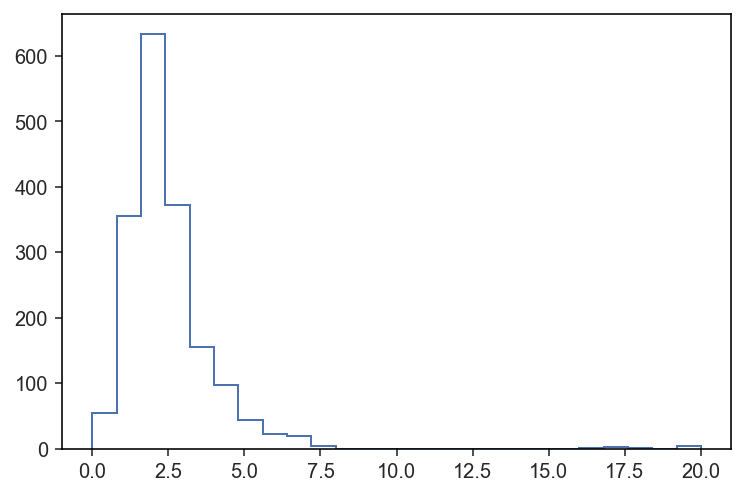

In [29]:
plt.hist(np.min(dhelio, axis=0), histtype="step", range=(0,20), bins=25)

# Origin of distant debris

In [251]:
np.median(ge_165['R_com_0'][ge_165['R_gal']>30]/2.5)

2.0991118

Text(0.5, 0, '$r_{\\rm{50}}$')

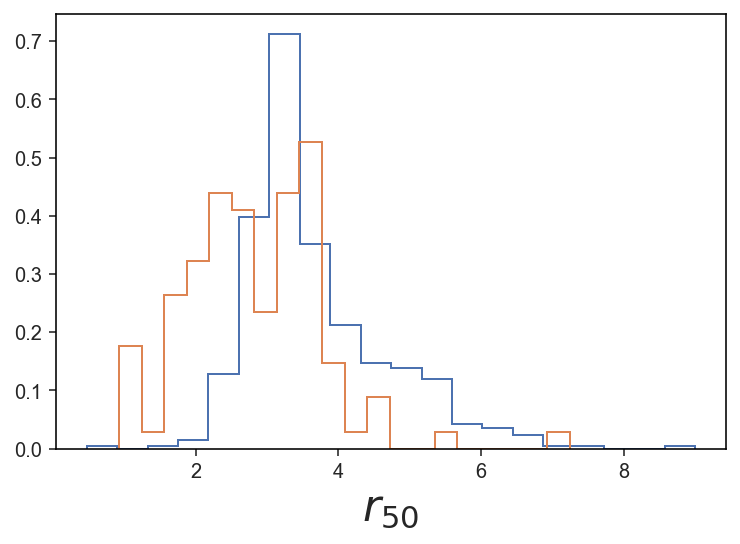

In [68]:
plt.hist(ge_165['R_com_0'][ge_165['R_gal']>50]/2.5,
        histtype="step", bins=20, density=True)

plt.hist(ge_165['R_com_0'][(ge_165['Lz_noisy']>2) & (ge_165['h3_mask']) & (ge_165['dist_adpt']<50) & (ge_165['dist_adpt']>3)]/2.5,
        histtype="step", bins=20, density=True)

# plt.hist(ge_165['R_com_0'][ge_165['R_gal']>50]/2.5,
#         histtype="step")

plt.xlabel(r"$r_{\rm{50}}$", fontsize=22)

(-4, 4)

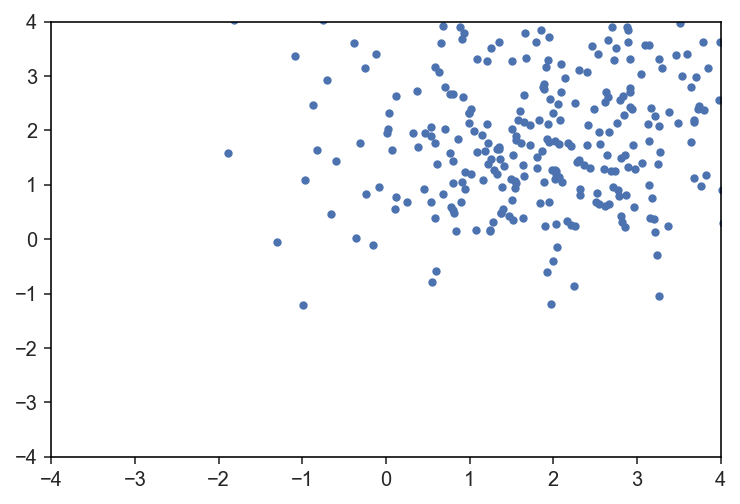

In [71]:
mask = (ge_165['R_gal']>60)
plt.scatter(ge_165['Lz_noisy'][mask], ge_165['Ly_noisy'][mask], s=10)
plt.xlim(-4, 4)
plt.ylim(-4, 4)

# GSE x Sgr

In [74]:
ra_deg = ge_165['ra']*u.degree
dec_deg = ge_165['dec']*u.degree

arg1 = (-0.93595354*np.cos(ra_deg.to(u.radian))*np.cos(dec_deg.to(u.radian)) 
   -0.31910658*np.sin(ra_deg.to(u.radian))*np.cos(dec_deg.to(u.radian)) 
   + 0.14886895*np.sin(dec_deg.to(u.radian)))

arg2 = (0.21215555*np.cos(ra_deg.to(u.radian))*np.cos(dec_deg.to(u.radian))
   -0.84846291*np.sin(ra_deg.to(u.radian))*np.cos(dec_deg.to(u.radian)) 
   -0.48487186*np.sin(dec_deg.to(u.radian)))

ge_165['Sgr_l'] = np.mod(360.0*u.degree-np.arctan2(arg1,arg2).to(u.degree),360.0*u.degree)

ge_165['Sgr_b'] = -1.0*u.degree*(
   np.arcsin(0.28103559*np.cos(ra_deg.to(u.radian))*np.cos(dec_deg.to(u.radian))
        -0.42223415*np.sin(ra_deg.to(u.radian))*np.cos(dec_deg.to(u.radian))
        +0.86182209*np.sin(dec_deg.to(u.radian))).to(u.degree))

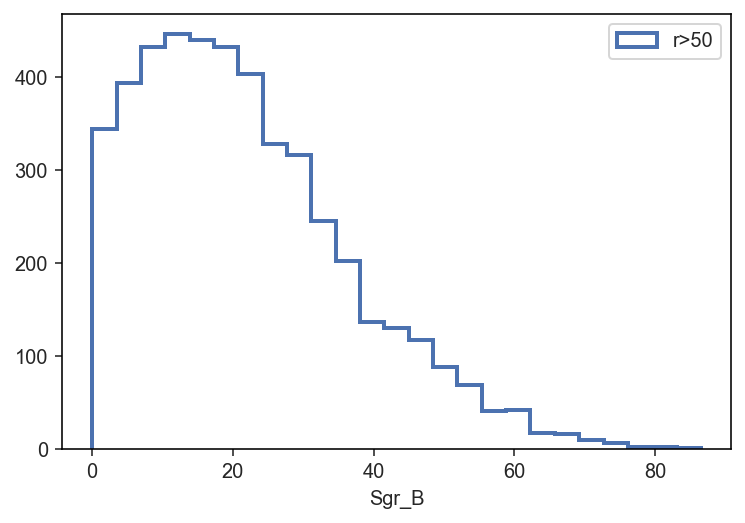

In [574]:
mask = (ge_165['R_gal']>30)
plt.hist(np.abs(ge_165['Sgr_b'][mask]), histtype="step", lw=2,
        bins=25, label="r>50")
plt.xlabel("Sgr_B")
plt.legend()

In [714]:
mask = (ge_165['R_gal']>30) #& (np.abs(ge_165['l_deg'])>90)
np.mean(np.abs(ge_165['Sgr_b'][mask])<20)

0.5168491092509122

(array([ 2455.,  3324.,  3842.,  5290.,  8761., 12837.,  7305.,  2635.,
         1659.,  1952.]),
 array([-1.79976247e+02, -1.43983502e+02, -1.07990756e+02, -7.19980107e+01,
        -3.60052651e+01, -1.25195672e-02,  3.59802260e+01,  7.19729716e+01,
         1.07965717e+02,  1.43958463e+02,  1.79951208e+02]),
 <a list of 10 Patch objects>)

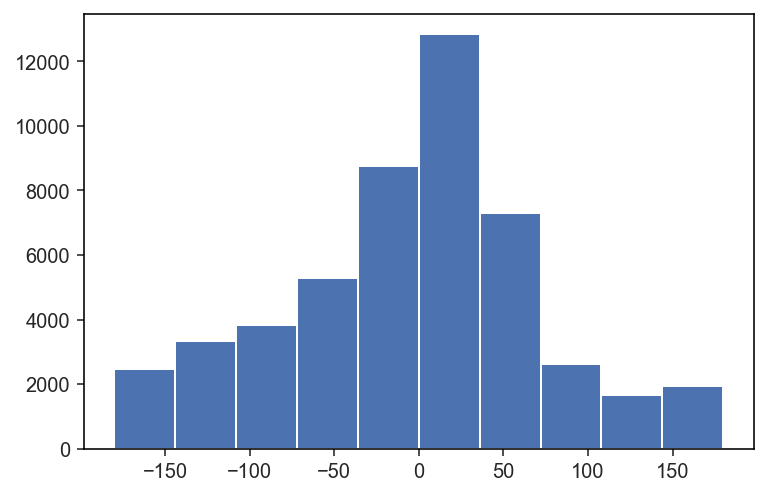

In [247]:
plt.hist(ge_165['l_deg']>90)

# Study orbits

In [31]:
tess_mask = (rcat['E_tot_pot1']<-1.2) & (rcat['E_tot_pot1']>-1.3) \
& (np.abs(rcat['Lz'])<0.3) & (rc_mask) & (rcat['SNR']>10) & (rcat['dist_adpt']<5)
np.count_nonzero(tess_mask)

6

In [ ]:
from h3ify_utils import compute_orbit
w = gd.PhaseSpacePosition(pos=[rcat[tess_mask]['X_gal'],rcat[tess_mask]['Y_gal'], rcat[tess_mask]['Z_gal']]*u.kpc,
                      vel=[rcat[tess_mask]['Vx_gal'], rcat[tess_mask]['Vy_gal'], rcat[tess_mask]['Vz_gal']]*u.km/u.s)
orbs = compute_orbit(w, pot=gp.MilkyWayPotential(), dt=1*u.Myr, t1=0*u.Gyr, t2=1*u.Gyr)

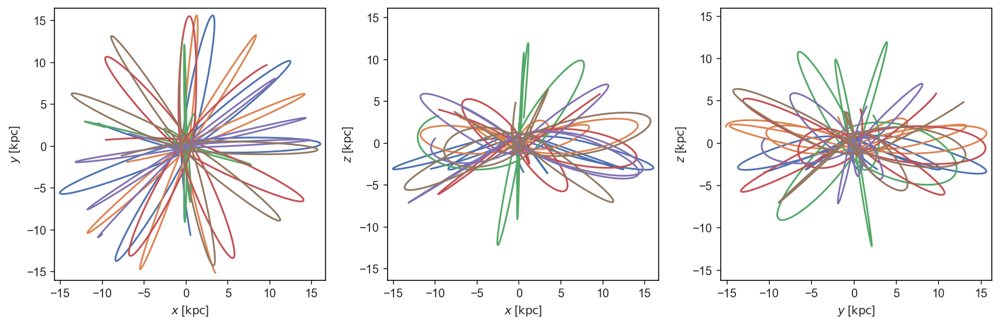

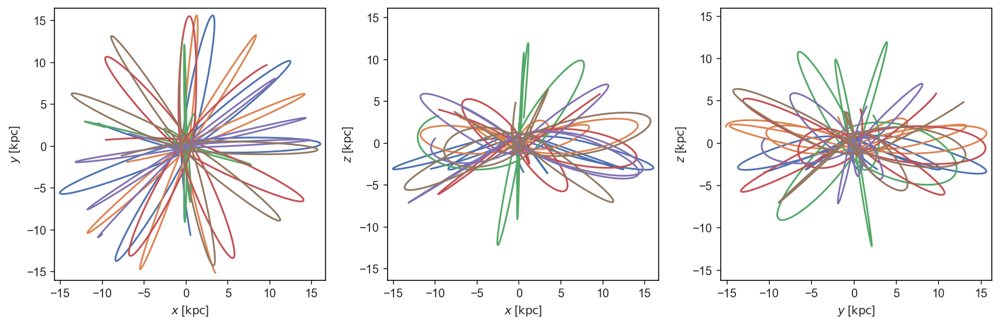

In [37]:
orbs.plot()

Text(0, 0.5, '$Z$ [kpc]')

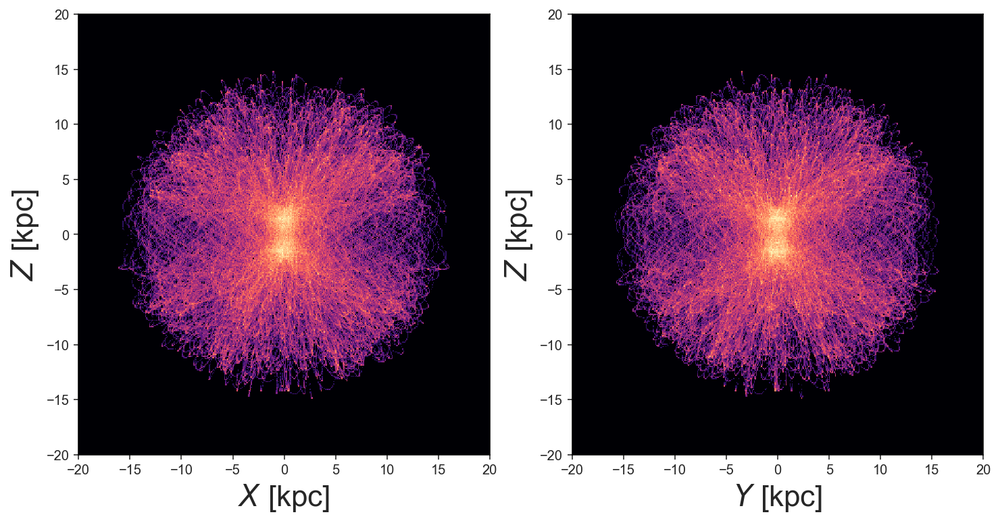

In [30]:
#orbs.plot()


import matplotlib
import copy
my_cmap = copy.copy(matplotlib.cm.get_cmap('magma')) # copy the default cmap
my_cmap.set_bad(my_cmap.colors[0])

plt.subplots(1,2, figsize=(12, 6))
plt.subplot(122)
plt.hist2d(np.ravel(orbs.y.value), 
           np.ravel(orbs.z.value), 
          range=[[-20,20],[-20, 20]], bins=[400, 400],
          cmap = my_cmap,
          norm=matplotlib.colors.LogNorm(), 
          )
plt.xlabel(r"$Y$ [kpc]", fontsize=22)
plt.ylabel("$Z$ [kpc]", fontsize=22)

plt.subplot(121)
plt.hist2d(np.ravel(orbs.x.value), 
           np.ravel(orbs.z.value), 
          range=[[-20,20],[-20, 20]], bins=[400, 400],
          cmap = my_cmap,
          norm=matplotlib.colors.LogNorm(), 
          )
plt.xlabel(r"$X$ [kpc]", fontsize=22)
plt.ylabel("$Z$ [kpc]", fontsize=22)

In [135]:
mask = (ge_165['dist_adpt']<5)
np.mean(ge_165['Lz'][mask]>1.5)

0.037481259370314844

In [136]:
mask = (ge_165['dist_adpt']>30)
np.mean(ge_165['Lz'][mask]>1.5)

0.29489948496427976

(-2.5, 0)

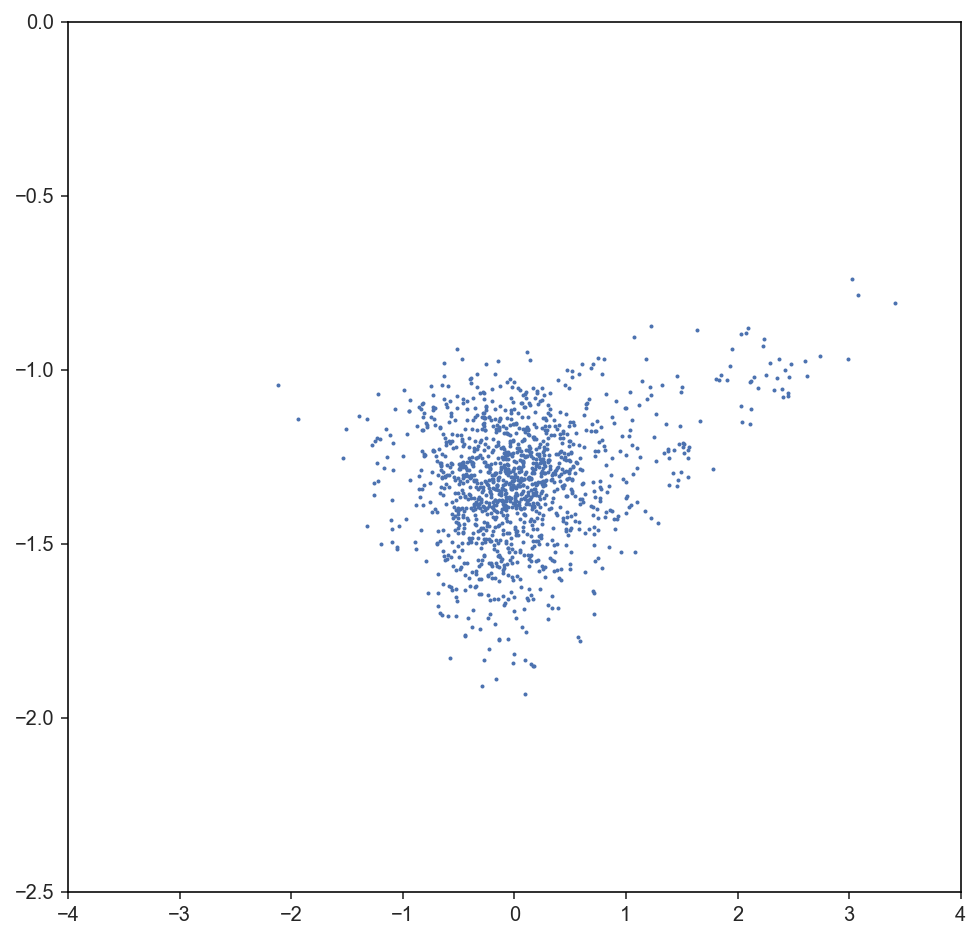

In [117]:
plt.figure(figsize=(8,8))
mask = (ge_165['dist_adpt']<5)
plt.scatter(ge_165['Lz'][mask], ge_165['E_tot_pot1'][mask], s=1, rasterized=True)
plt.xlim(-4, 4)
plt.ylim(-2.5, 0)

# Write file for distribution

In [391]:
ge_165['X_gal'] = ge_165['X_gal_501']
ge_165['Y_gal'] = ge_165['Y_gal_501']
ge_165['Z_gal'] = ge_165['Z_gal_501']
ge_165['Vx_gal'] = ge_165['Vx_gal_501']
ge_165['Vy_gal'] = ge_165['Vy_gal_501']
ge_165['Vz_gal'] = ge_165['Vz_gal_501']

ge_galacto = coord.Galactocentric(x=ge_165['X_gal']*u.kpc,
                                 y=ge_165['Y_gal']*u.kpc,
                                 z=ge_165['Z_gal']*u.kpc,
                                 v_x=ge_165['Vx_gal']*u.km/u.s,
                                 v_y = ge_165['Vy_gal']*u.km/u.s,
                                 v_z = ge_165['Vz_gal']*u.km/u.s)
ge_165['ra'] = ge_galacto.transform_to(coord.ICRS).ra.value
ge_165['dec'] = ge_galacto.transform_to(coord.ICRS).dec.value
ge_165['rv'] = ge_galacto.transform_to(coord.ICRS).radial_velocity.value
ge_165['pm_ra'] = ge_galacto.transform_to(coord.ICRS).pm_ra_cosdec.value
ge_165['pm_dec'] = ge_galacto.transform_to(coord.ICRS).pm_dec.value


import gala
ge_icrs_corrected = gala.coordinates.reflex_correct(ge_galacto.transform_to(coord.ICRS))
ge_165['pm_ra_corr'] = ge_icrs_corrected.pm_ra_cosdec
ge_165['pm_dec_corr'] = ge_icrs_corrected.pm_dec

#ge_165['X_gal', 'Y_gal','Z_gal','Vx_gal','Vy_gal','Vz_gal',
#      'ra','dec','rv','pm_ra','pm_dec','pm_ra_corr','pm_dec_corr'].write("/Users/rohannaidu/Dropbox/N21_fid_sim.fits")

(-50, 50)

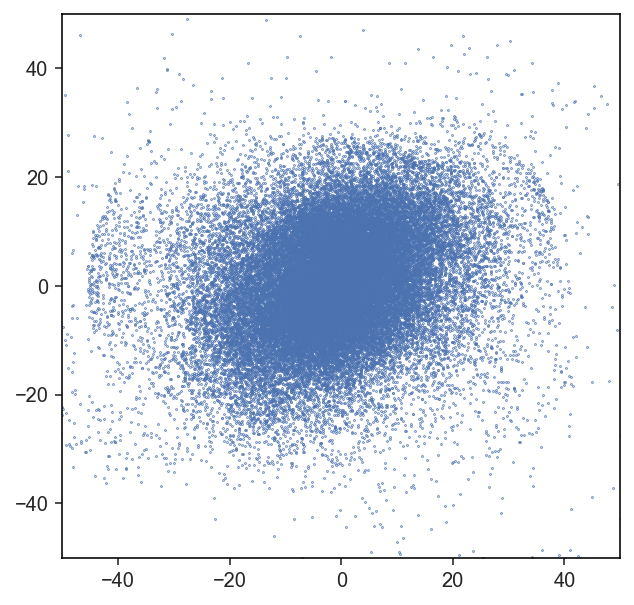

In [392]:
plt.figure(figsize=(5,5))
plt.scatter(ge_165['X_gal'], ge_165['Y_gal'], s=0.1)
plt.xlim(-50, 50)
plt.ylim(-50, 50)

(array([1.9706e+04, 1.9338e+04, 7.6100e+03, 2.3550e+03, 7.3800e+02,
        2.1900e+02, 6.8000e+01, 2.2000e+01, 3.0000e+00, 1.0000e+00]),
 array([ 0.04281007,  2.2904737 ,  4.538137  ,  6.7858005 ,  9.033464  ,
        11.281128  , 13.528791  , 15.776455  , 18.024118  , 20.271782  ,
        22.519445  ], dtype=float32),
 <a list of 1 Patch objects>)

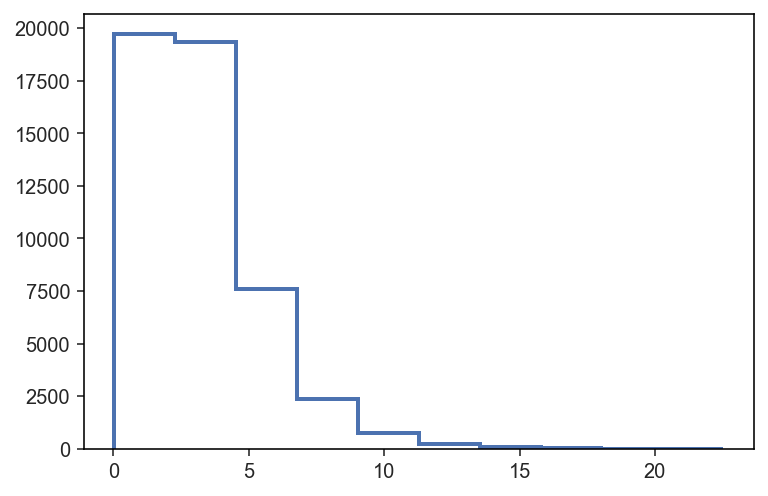

In [393]:
plt.hist(ge_165['R_com_0'], histtype="step", lw=2)

In [394]:
plt.scatter(ge_165['Lz'], ge_165['E_tot'], s=0.1, rasterized=True)

KeyError: 'E_tot'

In [395]:
ge_165['X'] = ge_165['X_gal']
ge_165['Y'] = ge_165['Y_gal']
ge_165['Z'] = ge_165['Z_gal']
ge_165['Vx'] = ge_165['Vx_gal']
ge_165['Vy'] = ge_165['Vy_gal']
ge_165['Vz'] = ge_165['Vz_gal']
ge_165['Vr']  = ge_165['Vr_gal']
ge_165['Vtheta'] = ge_165['Vtheta_gal']
ge_165['Vphi'] = ge_165['Vphi_gal']
ge_165['Lz'] = np.array(ge_165['Lz'])
ge_165['E_tot'] = np.array(ge_165['E_tot_pot1'])
ge_165['pm_ra_reflexcorr'] = np.array(ge_165['pm_ra_corr'])
ge_165['pm_dec_reflexcorr'] = np.array(ge_165['pm_dec_corr'])


ge_165['X', 'Y','Z', 'Vx','Vy','Vz','Vr','Vtheta','Vphi',
       'E_tot', 'Lz', 'ra','dec', 'L','B','rv',
       'pm_ra','pm_dec','pm_ra_reflexcorr','pm_dec_reflexcorr'].write("/Users/rohannaidu/Dropbox/GSEz0snapshot.fits",
                                                                     overwrite=True)

In [418]:
check = Table(fits.open("/Users/rohannaidu/Dropbox/GSEz0snapshot.fits")[1].data)

array([ -81.10892131,   15.53702669,    8.06641762, ...,  -49.34545032,
        174.37963666, -111.66842045])

(180, -180)

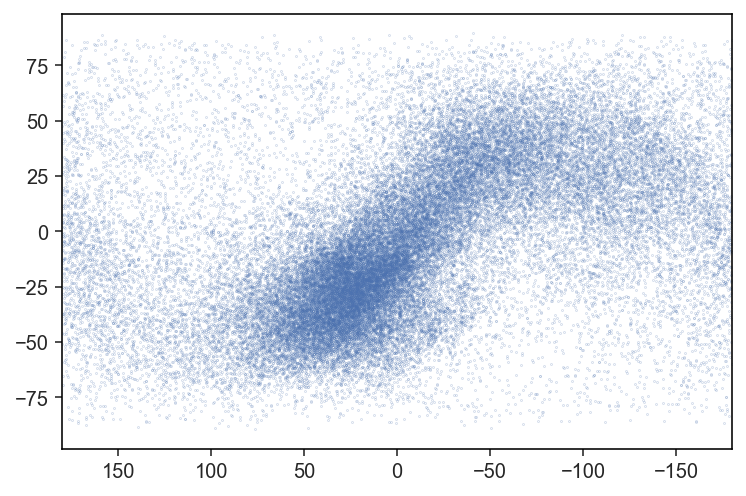

In [433]:
plt.scatter(coord.Galactic(l=check['L']*u.degree, b=check['B']*u.degree).l.wrap_at(180*u.degree).degree
            , check['B'], s=0.01)
plt.xlim(180, -180)
#plt.ylim(-3, 0)

In [439]:
coord.Galactocentric()

<Galactocentric Frame (galcen_coord=<ICRS Coordinate: (ra, dec) in deg
    (266.4051, -28.936175)>, galcen_distance=8.122 kpc, galcen_v_sun=(12.9, 245.6, 7.78) km / s, z_sun=20.8 pc, roll=0.0 deg)>

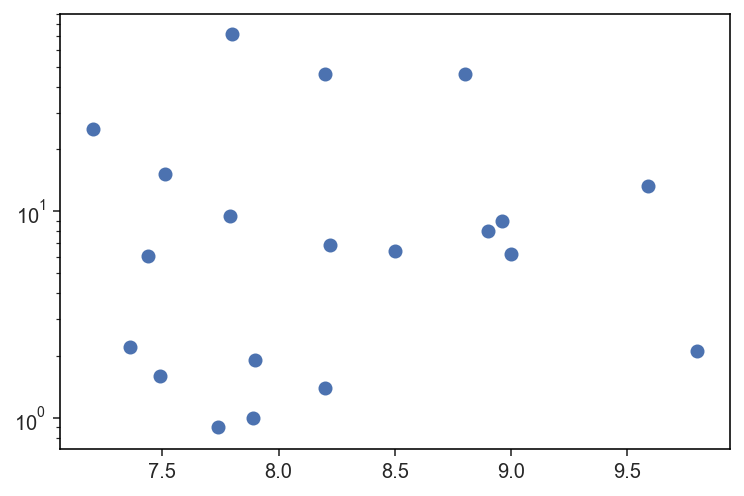

In [438]:
logm = [7.49, 7.51, 7.89, 7.20, 7.44, 7.79, 7.36, 7.74, 7.90]+[8.20, 9.59, 8.50, 8.96, 8.22, 8.9, 9.8, 9.0, 7.8, 8.2, 8.8]
fesc = [1.6, 15.1, 1, 25.1, 6.1, 9.5, 2.2, 0.9, 1.9]+[46, 13.2, 6.4, 9.0, 6.9, 8, 2.1, 6.2, 72.3, 1.4, 46.0]


plt.scatter(logm, fesc)
plt.yscale("log")

# Helmi blob

In [412]:
ge_165['Lp'] = (ge_165['Lx']**2 + ge_165['Ly']**2)**0.5

hs_k19 = (ge_165['Lp']<3.2) & (ge_165['Lp']>1.6) \
& (ge_165['Lz']<-0.75) & (ge_165['Lz']>-1.7) 


ge_165[hs_k19]

<Table length=50>
  X_gal_1     Y_gal_1    Z_gal_1  ...  pm_dec_reflexcorr           Lp        
                                  ...                          km kpc / s    
  float32     float32    float32  ...       float64             float64      
----------- ----------- --------- ... -------------------- ------------------
 -121.11267   -7.927241  32.56334 ...   1.3404063026802235 2.4855047947744673
  -131.4173    4.027243 35.709457 ...   -1.447952944147393 2.2172028063497264
-124.848595    8.891412 32.370132 ...   0.5235259004896221 1.7827053328139255
 -117.26351    6.296757  32.25511 ...    -1.09317986036576 1.8222530478257666
 -114.82482 -0.97628415 32.276634 ...  -2.7236505717613255  1.627288737388434
 -128.19553 0.046141576 34.064316 ...   1.6609551014655812 1.6012242362260145
 -121.01476   2.1507776 32.461273 ...   -0.538349388953831 1.7934514221767577
 -129.92448  -1.0942644 34.159306 ...   -3.869073066443374 1.7997068743785085
 -122.72876  -4.8443203 32.396244 ...  -0.9877831507405865 1.8529952359359905
        ...         ...       ... ...                  ...                ...
 -121.69434   1.5176152 34.099155 ...   1.7210563985723206  2.093730774943303
 -131.79044   2.3576605 35.463802 ...  -0.9650113557483322 1.7030343379214008
-124.015205  -11.747186 33.028587 ...   0.6847157467818508 2.9992729257380097
 -120.58986   10.674542  32.04414 ...   0.5658765392767469 1.6602954688389653
  -128.8588    6.807052 33.407963 ...  -1.2084277124367007 1.7990785238390843
 -120.61678  -1.8758132 32.278103 ...    1.069251938845205  1.878121388781735
 -132.16835 -0.08239603  35.29789 ...  -0.7284403580304066 1.6516733826419785
 -126.49911  -6.2364964  35.52387 ...    0.555460641898942 2.2785896461817194
 -124.19417  -10.786557   32.8025 ...   -1.055417747803751 1.6462837121196028
   -131.396   3.2378492 35.441666 ... -0.19788776933774793 2.4847977885122656

(-2.5, 0)

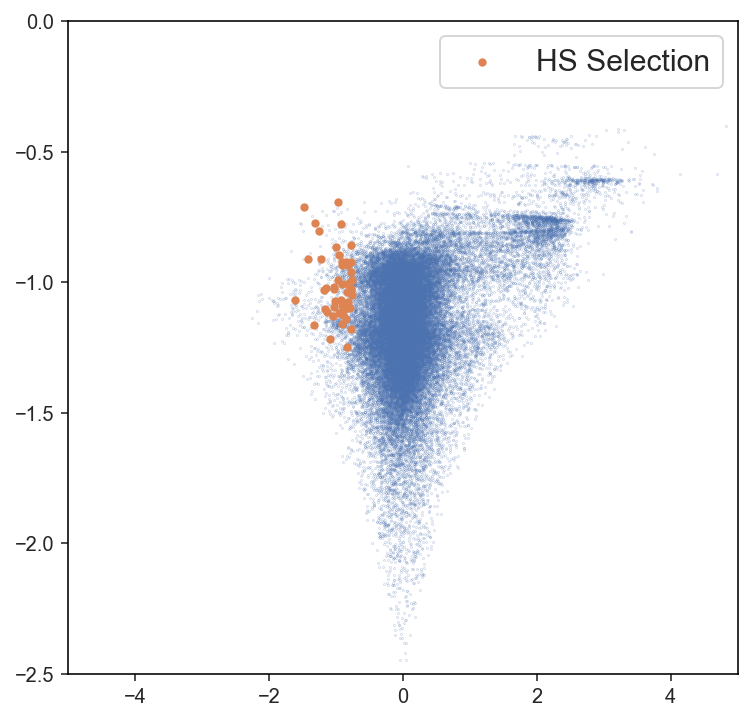

In [414]:
plt.figure(figsize=(6,6))
plt.scatter(ge_165['Lz'], ge_165['E_tot'], s=0.01, rasterized=True)
plt.scatter(ge_165['Lz'][hs_k19], ge_165['E_tot'][hs_k19], s=10, rasterized=True,
           label="HS Selection")
plt.legend(fontsize=15)
plt.xlim(-5, 5)
plt.ylim(-2.5, 0)

In [416]:
inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_165.pickle", "rb"))
ge_250 = read_file(hstack(inp), 250)

In [417]:
ge_250['Lp'] = (ge_250['Lx']**2 + ge_250['Ly']**2)**0.5

hs_k19 = (ge_250['Lp']<3.2) & (ge_250['Lp']>1.6) \
& (ge_250['Lz']<-0.75) & (ge_250['Lz']>-1.7) 


ge_250[hs_k19]

<Table length=28>
  X_gal_1    Y_gal_1    Z_gal_1  ...      b_gal_rad              Lp        
                                 ...                         km kpc / s    
  float32    float32    float32  ...       float64            float64      
----------- ---------- --------- ... ------------------- ------------------
  -131.4173   4.027243 35.709457 ... -0.8984930691754136 1.8375697734943135
-127.480644  10.298334  32.79949 ... -0.9975208832156961 1.9130375191131983
 -125.52498  -6.103367  34.37089 ... -0.8272648971265835 1.8265727392348825
 -117.50987 0.24185926 31.812542 ...  0.6112875883834322 2.0763496089843887
  -126.3042 -7.8167267 34.480904 ... 0.41286011648912724 1.8421100157691945
 -123.22232  -6.040114   33.2611 ... -0.8650896905420427 1.7951571163706999
 -128.92686   9.600699  33.92787 ...  0.8226484412666207 1.7148395345536047
  -132.8737  6.2865973  36.71292 ... -1.0503692857556688 1.9441660990413743
 -127.30352  -4.860571 34.593098 ... -0.7926045673676849 1.9924163973690465
        ...        ...       ... ...                 ...                ...
 -127.44222   3.960858  35.57982 ... -0.9116964811575274 1.7304782266182086
 -128.70438  -4.456318 33.989635 ... -0.8117000185742039 1.7860208505061463
 -127.17691 -6.0503755 33.078518 ...  -1.117132602404419  2.097618385787837
 -125.69521 -1.9512883 35.012188 ...  0.6197195238887233  1.635267802396886
  -136.1126 -4.4927845 35.843746 ...  0.9654931447664018 1.7288451727769607
 -129.74895     3.7045  34.73808 ... -0.5169375806807828 1.8163585533723898
 -128.26735  6.7956066  36.08864 ... -1.1153175256068235 2.2284417658544693
-121.849815  0.5272916 32.127625 ...  0.5956536342534521 1.6542704274377769
  -120.0617  -5.902063 31.145302 ... -0.6403363016355034 1.9087180096066272
 -129.42506  3.1177046  33.53161 ...  0.3992410958527371 1.6524197746207934

# Alpha theta plot

In [74]:
inp = pickle.load(open("./snaps/GE_disk_129_129_50_pro_165.pickle", "rb"))
ge_inp = hstack(inp)
ge_165 = read_file(ge_inp, 501)

In [128]:
ge_165['Ltot'] = (ge_165['Lx']**2 + ge_165['Ly']**2 + ge_165['Lz']**2)**0.5
ge_165['alpha'] = np.arccos(-ge_165['Lz']/ge_165['Ltot'])*(180/np.pi)
ge_165['theta'] = np.mod((np.arctan2(ge_165['Ly'], ge_165['Lx']) + 2*np.pi), 2*np.pi)*(180/np.pi)
helio_mask = (ge_165['dist_adpt']<5)

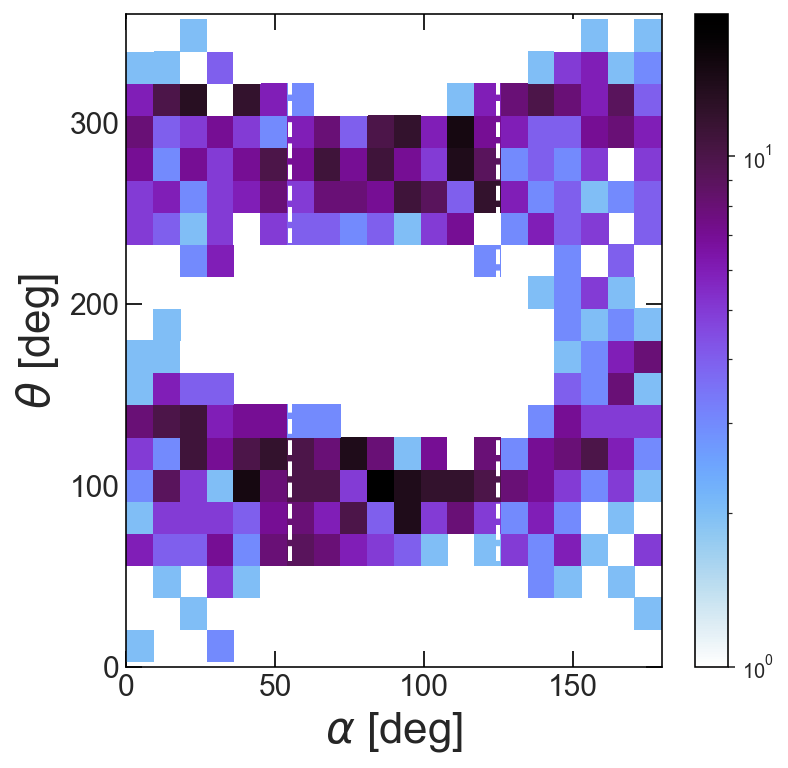

In [193]:
plt.figure(figsize=(6, 6))
plt.hist2d(ge_165['alpha'][mask], ge_165['theta'][mask],
           cmap="cmr.voltage_r", norm=LogNorm(), bins=20)
plt.colorbar()
plt.xlabel(r"$\alpha$ [deg]", fontsize=22)
plt.ylabel(r"$\theta$ [deg]", fontsize=22)
plt.xlim(0, np.pi*(180/np.pi))
plt.ylim(0, 2*np.pi*(180/np.pi))
plt.axvline(55, ls="--", lw=2, c="white")
plt.axvline(125, ls="--", lw=2, c="white")

plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")

/Users/rohannaidu/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


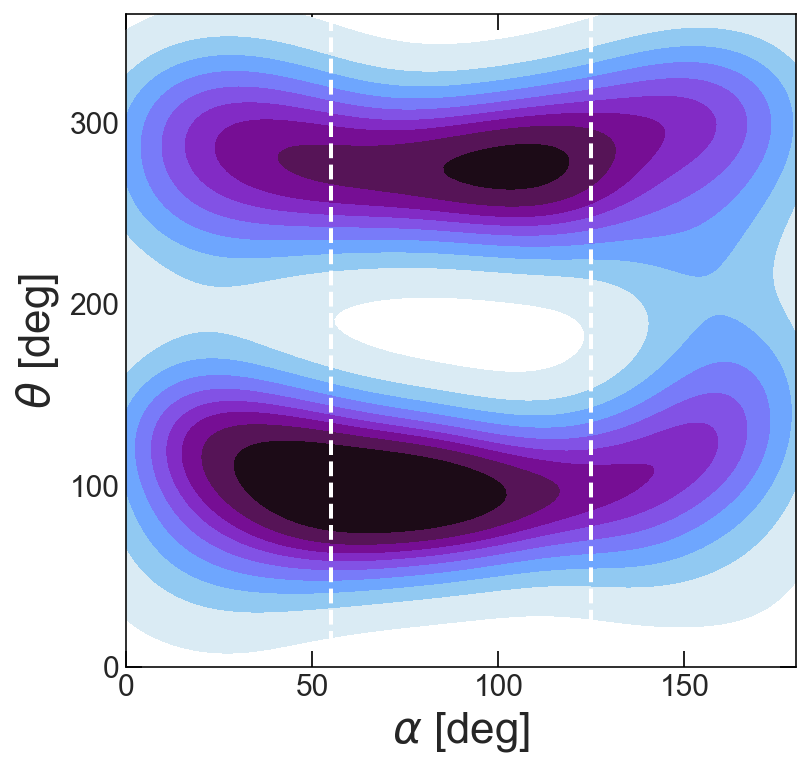

In [129]:
plt.figure(figsize=(6, 6))
sns.kdeplot(ge_165['alpha'][mask], ge_165['theta'][mask],
           fill=True, cmap="cmr.voltage_r")
plt.xlabel(r"$\alpha$ [deg]", fontsize=22)
plt.ylabel(r"$\theta$ [deg]", fontsize=22)
plt.xlim(0, np.pi*(180/np.pi))
plt.ylim(0, 2*np.pi*(180/np.pi))
plt.axvline(55, ls="--", lw=2, c="white")
plt.axvline(125, ls="--", lw=2, c="white")

plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")

In [236]:
helio_mask = (ge_165['dist_adpt']<10)
vr_mask = ((ge_165['Vr_gal']**2)/(ge_165['Vx_gal_501']**2 + 
                  ge_165['Vx_gal_501']**2 +
                  ge_165['Vx_gal_501']**2 ) > 0.6)
loi_mask = (ge_165['alpha']<55) | (ge_165['alpha']>125) 
hoi_mask = (ge_165['alpha']>55) & (ge_165['alpha']<125)

In [234]:
np.count_nonzero(loi_mask[helio_mask]), np.count_nonzero(hoi_mask[helio_mask])

(845, 489)

In [237]:
from h3ify_utils import compute_orbit
w = gd.PhaseSpacePosition(pos=[ge_165[helio_mask]['X_gal_501'],
                               ge_165[helio_mask]['Y_gal_501'], 
                               ge_165[helio_mask]['Z_gal_501']]*u.kpc,
                          
                          vel=[ge_165[helio_mask]['Vx_gal_501'], 
                               ge_165[helio_mask]['Vy_gal_501'], 
                               ge_165[helio_mask]['Vz_gal_501']]*u.km/u.s)

orbs = compute_orbit(w, pot=gp.MilkyWayPotential(), dt=1*u.Myr, t1=0*u.Gyr, t2=5*u.Gyr)

In [238]:
apos = orbs.apocenter()
eccs = orbs.eccentricity()

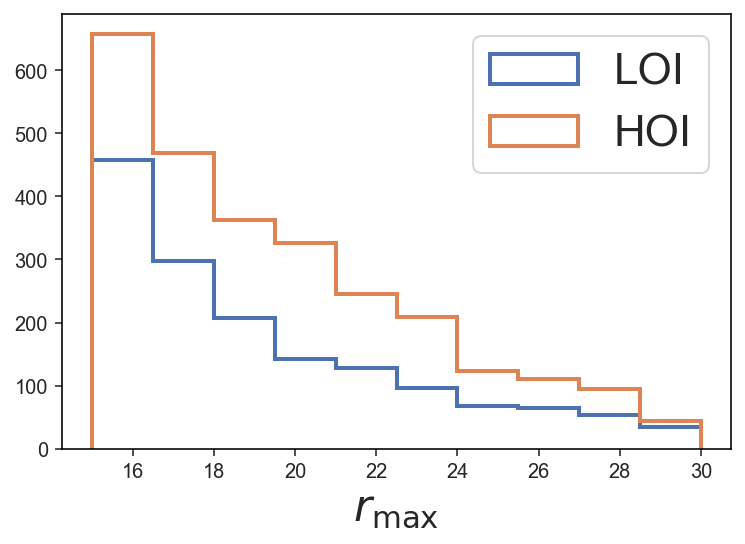

In [239]:
plt.hist(apos.value[loi_mask[helio_mask] ], density=False, 
         range=(15,30), bins=10, histtype="step", lw=2, label="LOI")
plt.hist(apos.value[hoi_mask[helio_mask] ], density=False, 
         range=(15,30), bins=10, histtype="step", lw=2, label="HOI")
plt.xlabel(r"$r_{\rm{max}}$", fontsize=22)
plt.legend(fontsize=22)

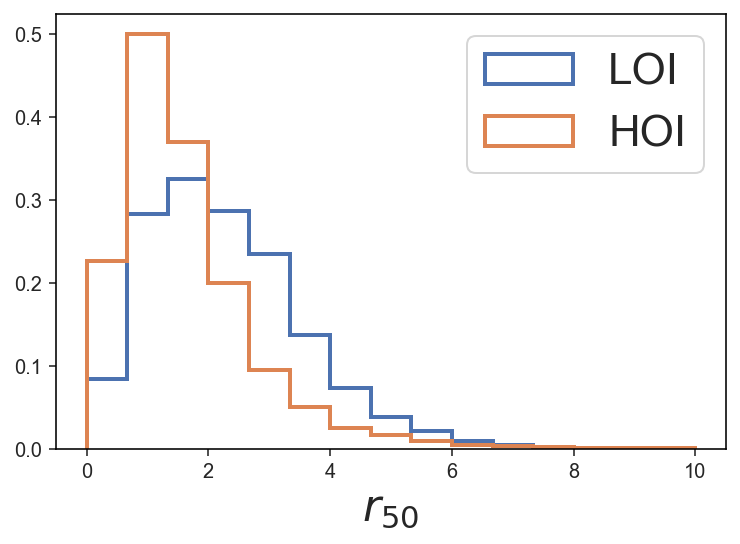

In [203]:
plt.hist(ge_165['R_com_0'][loi_mask]/1.75, histtype="step", density=True, lw=2, label="LOI",
        range=(0,10), bins=15)
plt.hist(ge_165['R_com_0'][hoi_mask]/1.75, histtype="step", density=True, lw=2, label="HOI",
        range=(0,10), bins=15)
plt.xlabel(r"$r_{\rm{50}}$", fontsize=22)
plt.legend(fontsize=22)

In [ ]:
plt.hist(ap[loi_mask[mask] ], density=False, 
         range=(15,30), bins=10, histtype="step", lw=2, label="LOI")
plt.hist(apos.value[hoi_mask[mask] ], density=False, 
         range=(15,30), bins=10, histtype="step", lw=2, label="HOI")
plt.xlabel(r"$r_{\rm{max}}$", fontsize=22)
plt.legend(fontsize=22)

In [175]:
np.count_nonzero(hoi_mask[helio_mask]  & (eccs>0.7))

450

In [179]:
np.mean(vr_mask[helio_mask])

0.08995502248875563

In [208]:
rcat['Ltot'] = (rcat['Lx']**2 + rcat['Ly']**2 + rcat['Lz']**2)**0.5
rcat['alpha'] = np.arccos(-rcat['Lz']/rcat['Ltot'])*(180/np.pi)
rcat['theta'] = np.mod((np.arctan2(rcat['Ly'], rcat['Lx']) + 2*np.pi), 2*np.pi)*(180/np.pi)
helio_mask = (rcat['dist_adpt']<5)

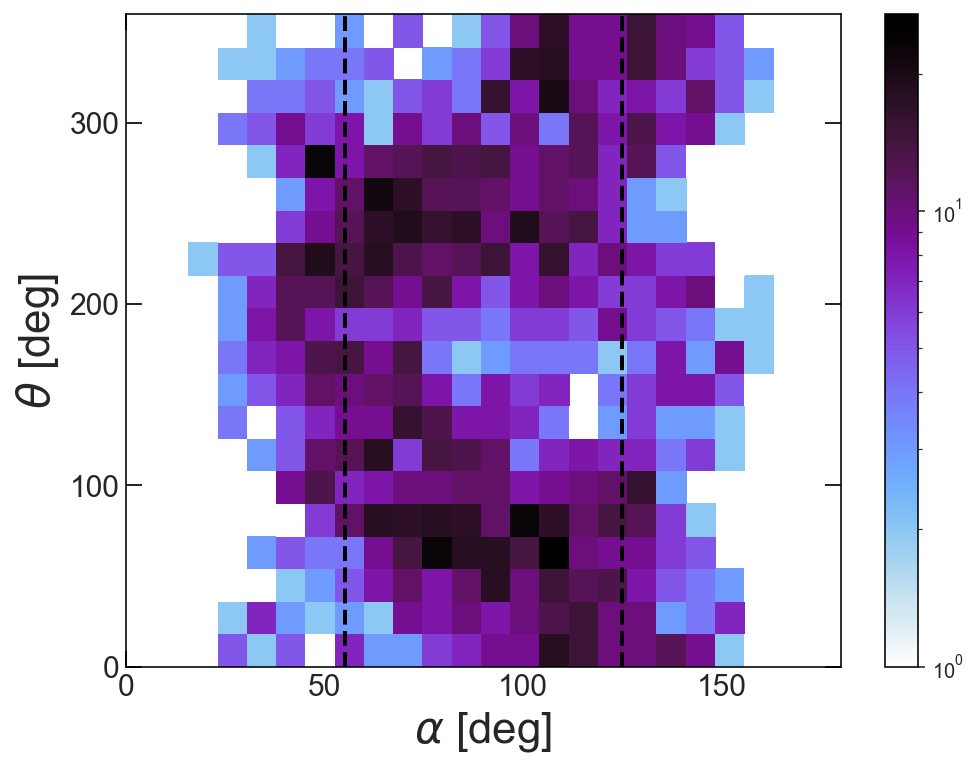

In [225]:
plt.figure(figsize=(8, 6))
plt.hist2d(rcat['alpha'][rc_mask], rcat['theta'][rc_mask],
          cmap="cmr.voltage_r", norm=LogNorm(), bins=20)
plt.colorbar()
#plt.scatter(rcat['alpha'][rc_mask], rcat['theta'][rc_mask],s=5)
plt.xlabel(r"$\alpha$ [deg]", fontsize=22)
plt.ylabel(r"$\theta$ [deg]", fontsize=22)
plt.xlim(0, np.pi*(180/np.pi))
plt.ylim(0, 2*np.pi*(180/np.pi))
plt.axvline(55, ls="--", lw=2, c="k")
plt.axvline(125, ls="--", lw=2, c="k")

plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")

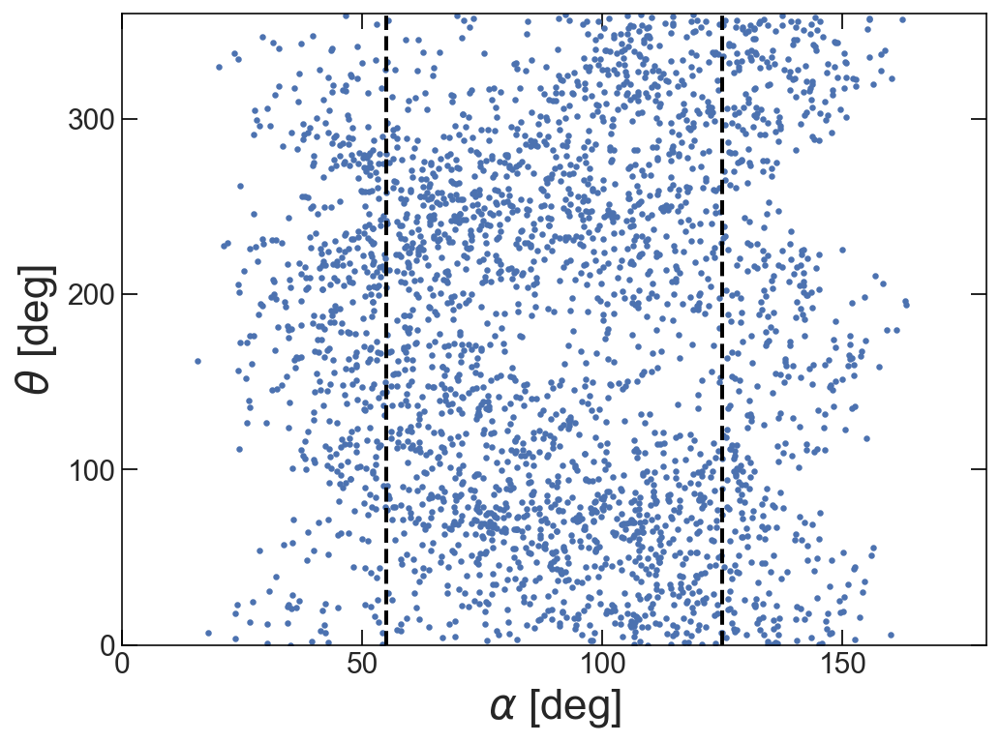

In [216]:
plt.figure(figsize=(8, 6))
#plt.hist2d(rcat['alpha'][rc_mask], rcat['theta'][rc_mask],
#           cmap="cmr.voltage_r", norm=LogNorm(), bins=20)
#plt.colorbar()
plt.scatter(rcat['alpha'][rc_mask], rcat['theta'][rc_mask],s=5)
plt.xlabel(r"$\alpha$ [deg]", fontsize=22)
plt.ylabel(r"$\theta$ [deg]", fontsize=22)
plt.xlim(0, np.pi*(180/np.pi))
plt.ylim(0, 2*np.pi*(180/np.pi))
plt.axvline(55, ls="--", lw=2, c="k")
plt.axvline(125, ls="--", lw=2, c="k")

plt.locator_params(axis='y',nbins=6)
plt.locator_params(axis='x',nbins=6)
plt.tick_params(axis='x', labelsize=15, length=8, width=1,top="off", direction="in")
plt.tick_params(axis='y', labelsize=15, length=8, width=1,right="off", direction="in")

In [217]:
loi_mask = (rcat['alpha']<55) | (rcat['alpha']>125) 
hoi_mask = (rcat['alpha']>55) & (rcat['alpha']<125)

Text(0.5, 0, '[Fe/H]')

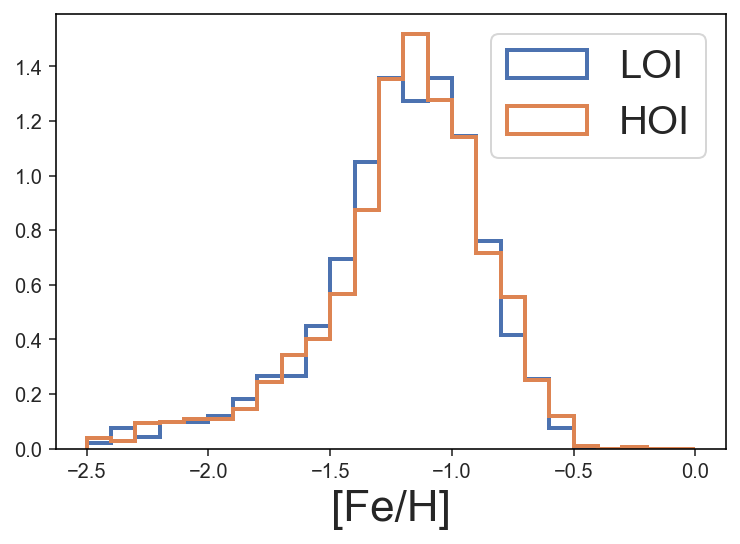

In [224]:
plt.hist(rcat[loi_mask & rc_mask]['FeH'],
        histtype="step", range=(-2.5, 0), bins=25, lw=2,
        density=True, label="LOI")

plt.hist(rcat[hoi_mask & rc_mask]['FeH'],
        histtype="step", range=(-2.5, 0), bins=25, lw=2,
        density=True, label="HOI")

plt.legend(fontsize=20)
plt.xlabel("[Fe/H]", fontsize=22)